### Imports

In [1]:
def split_window(start, end, min_size=1000):
    return [(s, min(s + min_size, end)) for s in range(start, end, min_size)]

In [2]:
# system imports
import os, re
import sys
import json
import math
from math import sqrt

# data science
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse
import matplotlib.animation as animation
from numpy.lib.utils import show_runtime
import matplotlib.lines as mlines

# signal processing
from scipy import signal
from scipy.ndimage import label
from scipy.signal import savgol_filter

from scipy.stats import zscore
from scipy.interpolate import interp1d
from scipy.integrate import trapz
# from scipy.signal import butter, filtfilt

# physionet data
# import wfdb
# from wfdb import processing

from biosppy.signals import ecg, hrv, ppg, acc, eda
from biosppy import inter_plotting
from scipy.interpolate import CubicSpline
from scipy.stats import zscore
import biosppy.signals.hrv as hrv

import seaborn as sns
import warnings

# from sympy.printing.pretty.pretty_symbology import line_width

# import wfdb
import pywt
import math
from sklearn.metrics import mean_squared_error


warnings.filterwarnings("ignore")
warnings.simplefilter(action='ignore', category=Warning)  # Suppress BioSPPy warnings

np.version.version ## should be < 2

ModuleNotFoundError: No module named 'numpy.lib.utils'

### Global settings

In [15]:
# path settings
project_path = os.path.join(os.getcwd(), os.pardir)
data_path = os.path.join(project_path, 'data')
output_path = os.path.join(project_path, 'output')

# style settings
sns.set(style='whitegrid', rc={'axes.facecolor': '#EFF2F7'})

# sample frequency for Bobbi sensor
settings = {}
settings['fs'] = 500

identifiers = "s1_SHE_T1,s1_SHE_T2,s1_SHE_T3,s1_HE_T4,s1_HE_T5,s1_HE_T6,s2_HE_T1,s2_HE_T2,s2_HE_T3,s2_SHE_T4,s2_SHE_T5,s2_SHE_T6,s2_SHE_T7,s3_SHE_T1,s3_SHE_T2,s3_SHE_T3,s3_HE_T4,s3_HE_T5,s3_HE_T6,s4_HE_T1,s4_HE_T2,s4_HE_T3,s4_SHE_T4,s4_SHE_T5,s4_SHE_T6,s5_SHE_T1,s5_SHE_T2,s5_SHE_T3,s5_HE_T4,s5_HE_T5,s5_HE_T6,s6_HE_T1,s6_HE_T2,s6_HE_T3,s6_SHE_T4,s6_SHE_T5,s6_SHE_T6"
identifiers = [id[:-3] for id in  identifiers.split(",")]
identifiers = list(dict.fromkeys(identifiers))
print(identifiers)

take_1_timestamps = {
    "blackscreen_s1_SHE.mov": 35.250000,
    "blackscreen_s1_HE.mov": 25.375000,
    "blackscreen_s2_HE.mov": 57.250000,
    "blackscreen_s2_SHE.mov": 37.333333,
    "blackscreen_s3_SHE.mov": 60.333333,
    "blackscreen_s3_HE.mov": 52.416667,
    "blackscreen_resting1.mov": 0.0,
    "blackscreen_resting2.mov": 0.0,
    "blackscreen_resting3.mov": 0.0,
    "blackscreen_resting4.mov": 0.0,
    "blackscreen_resting5.mov": 0.0,
    "blackscreen_resting6.mov": 0.0,
    "blackscreen_s4_HE.mov": 56.208333,
    "blackscreen_s4_SHE.mov": 194.250000,
    "blackscreen_s5_SHE.mov": 285.250000,
    "blackscreen_s5_HE.mov": 76.250000,
    "blackscreen_s6_HE.mov": 96.208333,
    "blackscreen_s6_SHE.mov": 34.333333,
}
list(take_1_timestamps.values())[:]

import ipywidgets as widgets
from IPython.display import display

label_options = widgets.ToggleButtons(
    options=['ECG', 'PPG', 'EDA', 'ACC'],
    description='Modality:',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltips=['Description of slow', 'Description of regular', 'Description of fast'],
    #     icons=['check'] * 3
)

# Display the dropdown widget
display(label_options)

['s1_SHE', 's1_HE', 's2_HE', 's2_SHE', 's3_SHE', 's3_HE', 's4_HE', 's4_SHE', 's5_SHE', 's5_HE', 's6_HE', 's6_SHE']


ToggleButtons(description='Modality:', options=('ECG', 'PPG', 'EDA', 'ACC'), tooltips=('Description of slow', …

|### Helper functions

In [11]:
def get_plot_ranges(start=10, end=20, n=5):
    '''
    Make an iterator that divides into n or n+1 ranges.
    - if end-start is divisible by steps, return n ranges
    - if end-start is not divisible by steps, return n+1 ranges, where the last range is smaller and ends at n

    # Example:
    >> list(get_plot_ranges())
    >> [(0.0, 3.0), (3.0, 6.0), (6.0, 9.0)]

    '''
    distance = end - start
    for i in np.arange(start, end, np.floor(distance/n)):
        yield (int(i), int(np.minimum(end, np.floor(distance/n) + i)))

In [5]:
def detect_peaks(ecg_signal, threshold=0.3, qrs_filter=None):
    '''
    Peak detection algorithm using cross corrrelation and threshold
    '''
    if qrs_filter is None:
        # create default qrs filter
        t = np.linspace(1.5 * np.pi, 3.5 * np.pi, 15)
        qrs_filter = np.sin(t)

    # normalize data
    ecg_signal = (ecg_signal - ecg_signal.mean()) / ecg_signal.std()

    # calculate cross correlation
    similarity = np.correlate(ecg_signal, qrs_filter, mode="same")
    similarity = similarity / np.max(similarity)

    # return peaks (values in ms) using threshold
    return ecg_signal[similarity > threshold].index, similarity

def group_peaks(p, threshold=5):
    '''
    The peak detection algorithm finds multiple peaks for each QRS complex.
    Here we group collections of peaks that are very near (within threshold) and we take the median index
    '''
    # initialize output
    output = np.empty(0)

    # label groups of sample that belong to the same peak
    peak_groups, num_groups = label(np.diff(p) < threshold)
    print(np.diff(p))
    print(label(np.diff(p) < threshold))

    # iterate through groups and take the mean as peak index
    for i in np.unique(peak_groups)[1:]:
        peak_group = p[np.where(peak_groups == i)]
        output = np.append(output, np.median(peak_group))
    return output

device data length:  (2, 101678)
8803 73791 64988
(8804, 27282) 0
(52087, 73231) 27282
(81562, 99947) 73231
[ 99947 101678] 99947


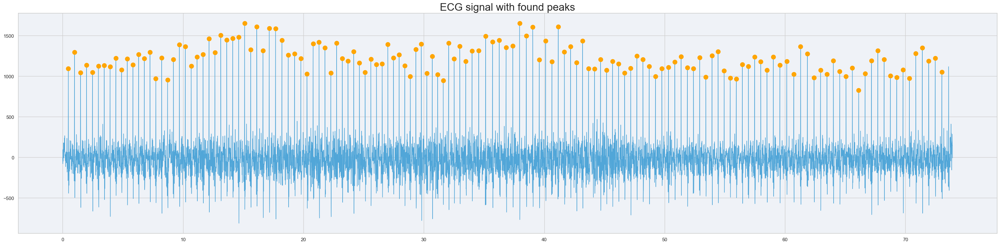

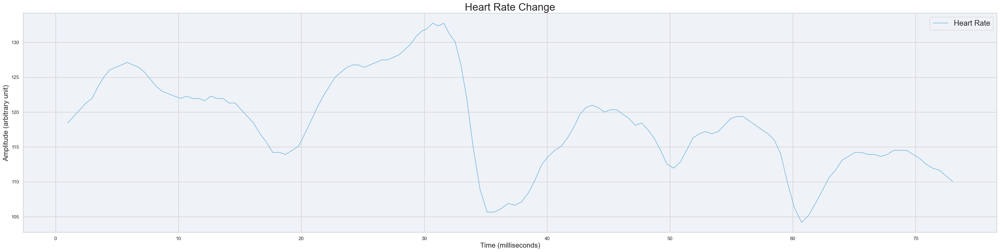

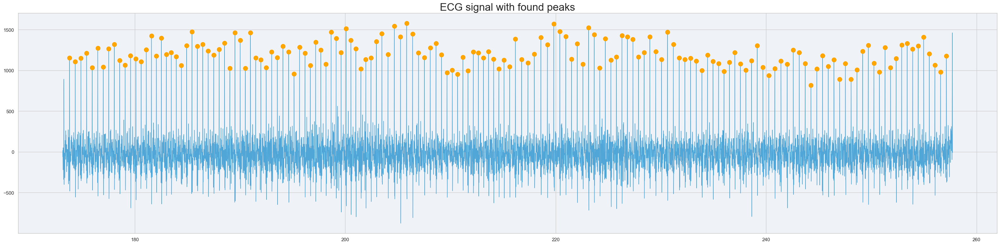

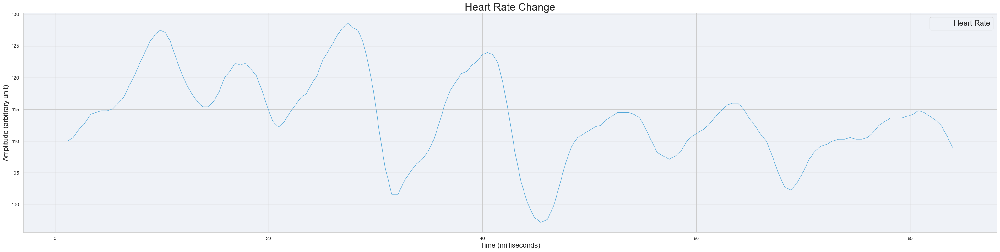

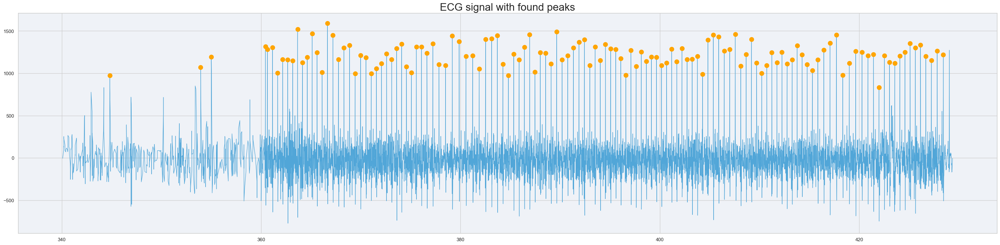

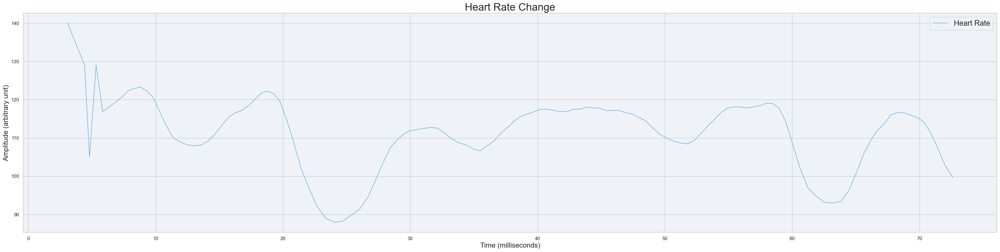

device data length:  (2, 116144)
6339 71334 64995
(6337, 24059) 0
(43054, 60488) 24059
(82068, 98223) 60488
[ 98223 116144] 98223


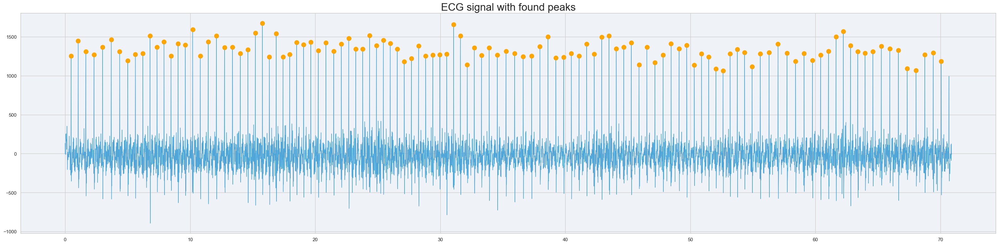

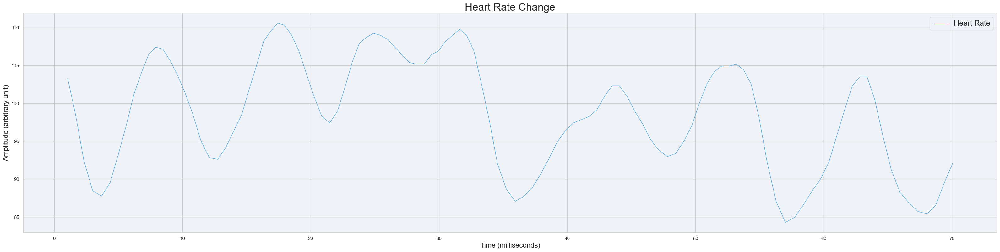

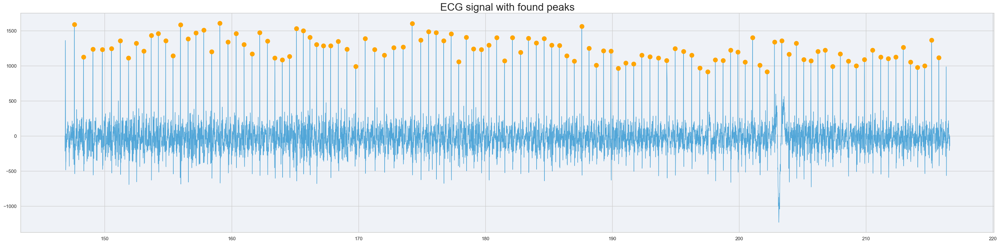

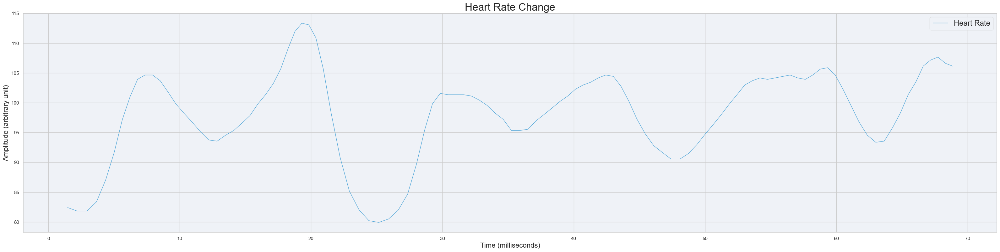

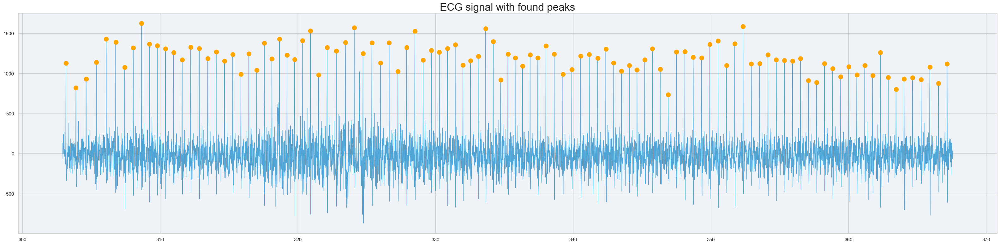

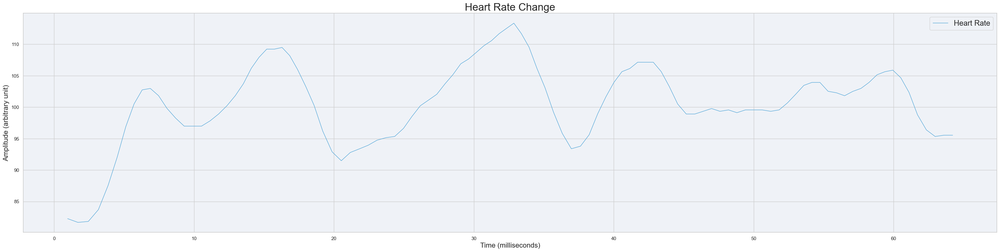

device data length:  (2, 222877)
14310 79307 64997
(14312, 35189) 0
(75831, 96916) 35189
(128578, 150164) 96916
[150164 222877] 150164


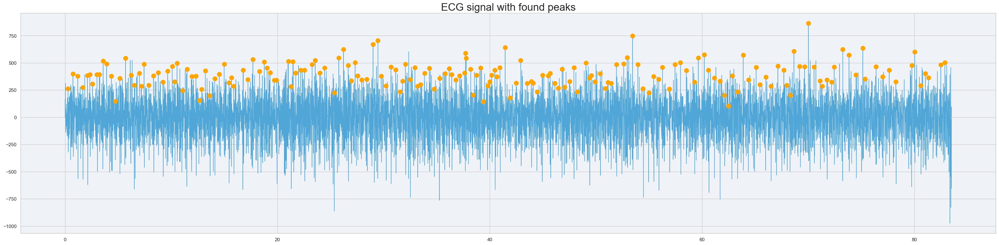

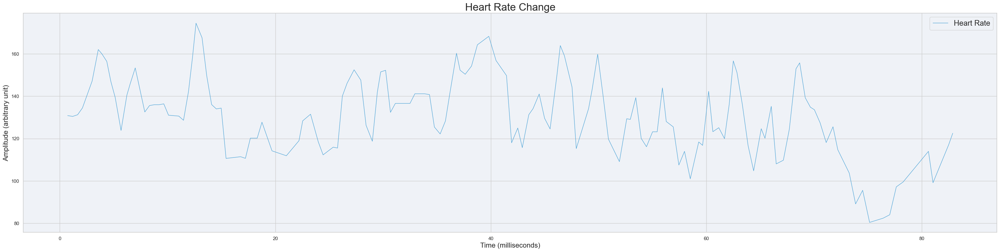

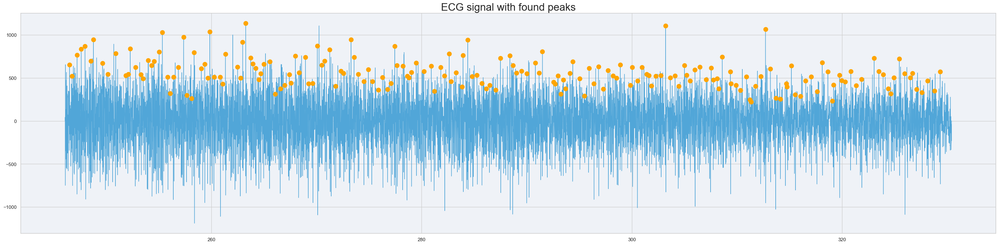

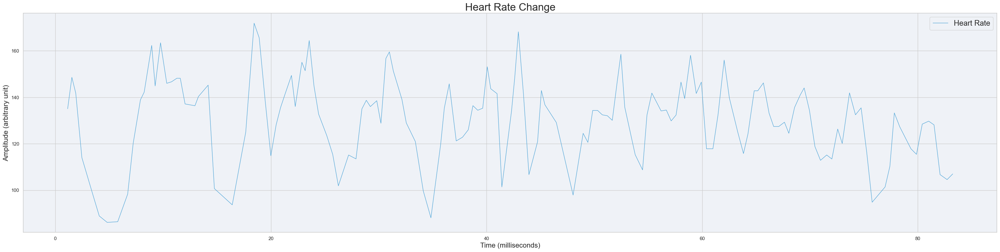

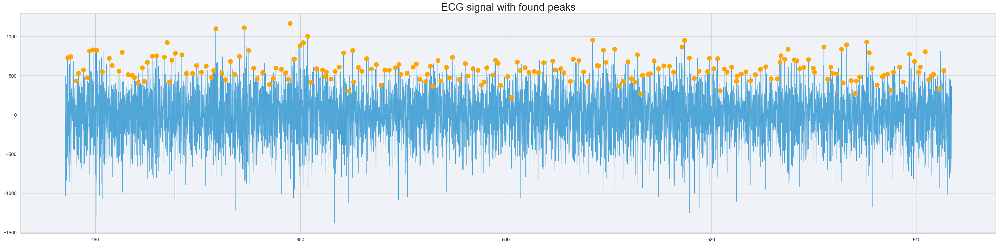

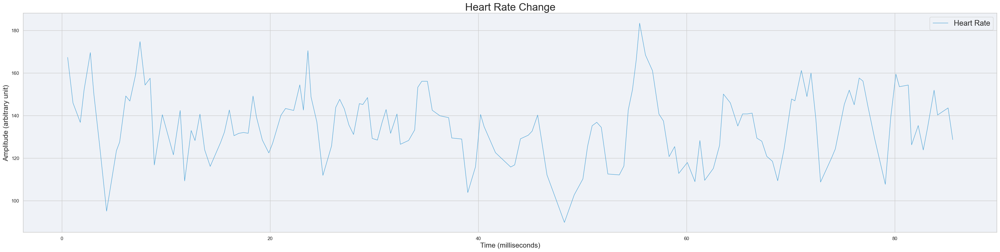

device data length:  (2, 217463)
9329 74323 64994
(9327, 33737) 0
(64301, 91884) 33737
(118344, 146967) 91884
(185808, 214138) 146967
[214138 217463] 214138


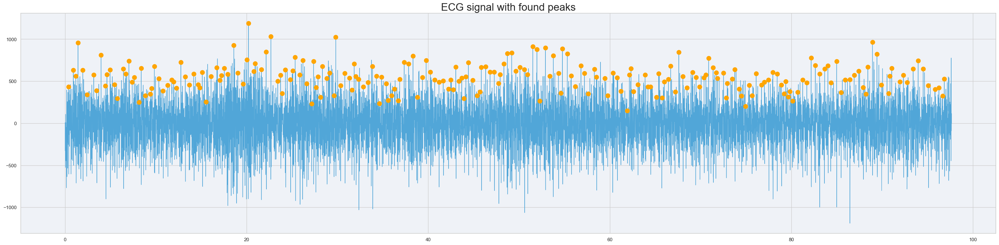

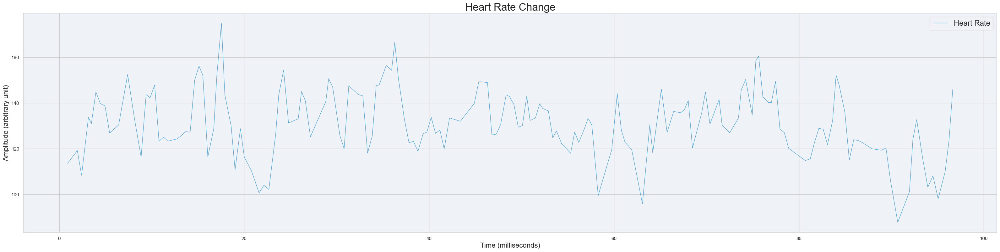

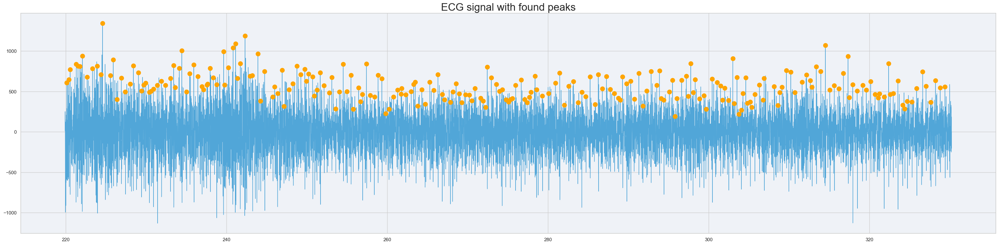

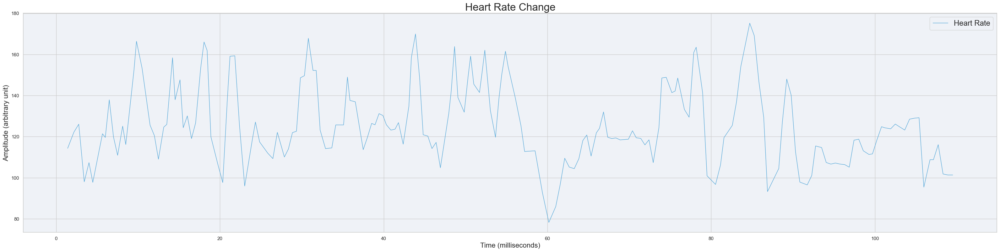

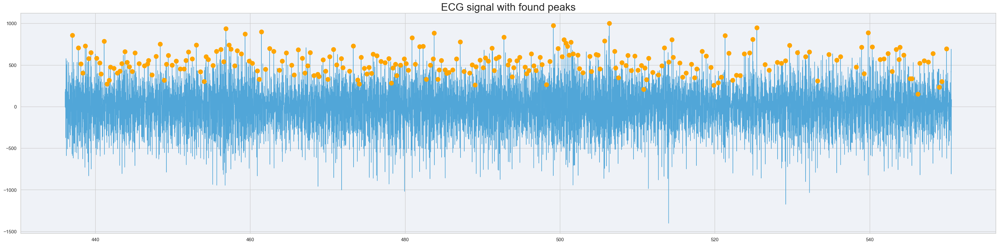

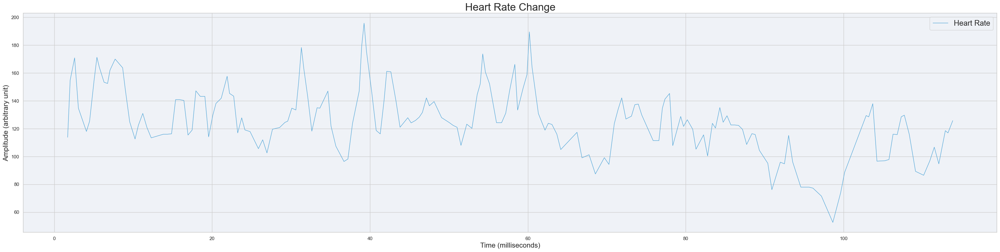

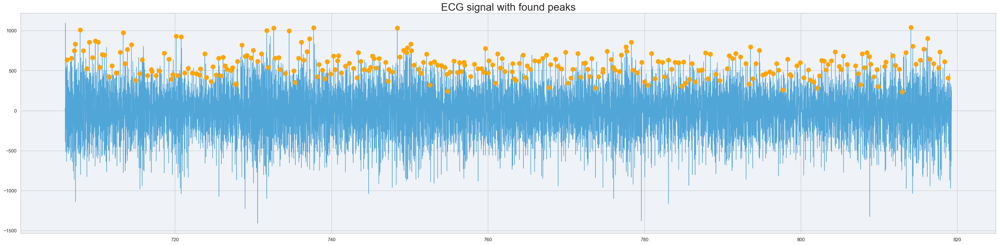

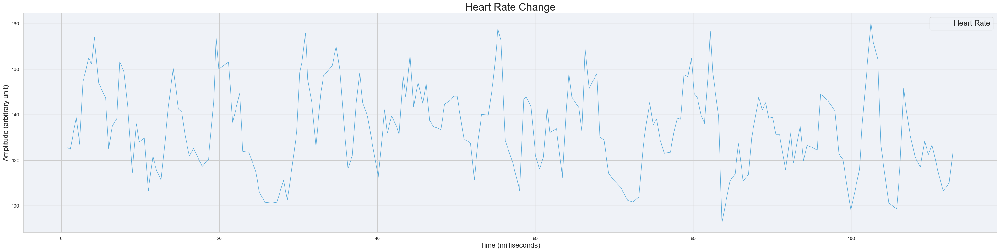

device data length:  (2, 52306)
15082 55890 40808
(15083, 29988) 0
(43554, 59451) 29988
(49565, 66790) 59451
[66790 52306] 66790


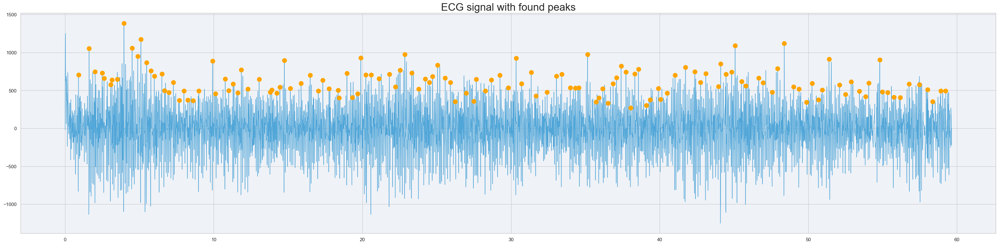

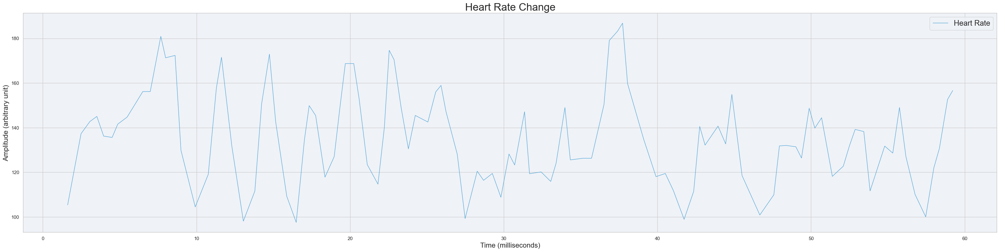

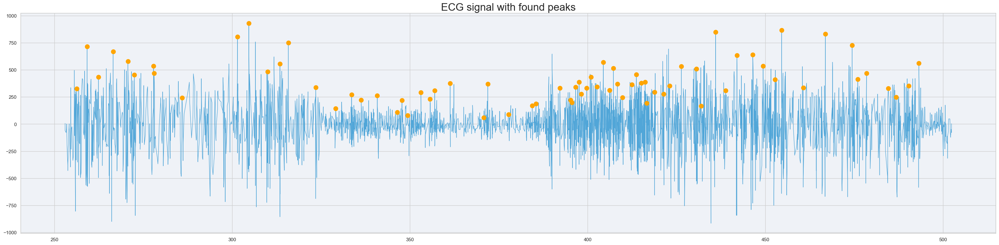

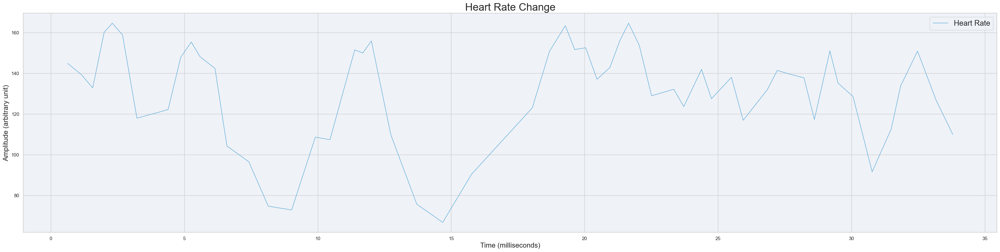

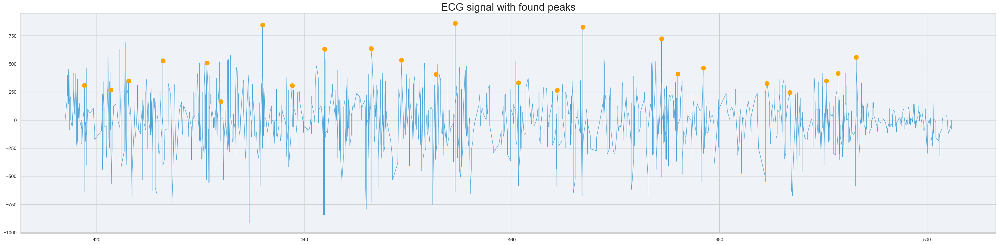

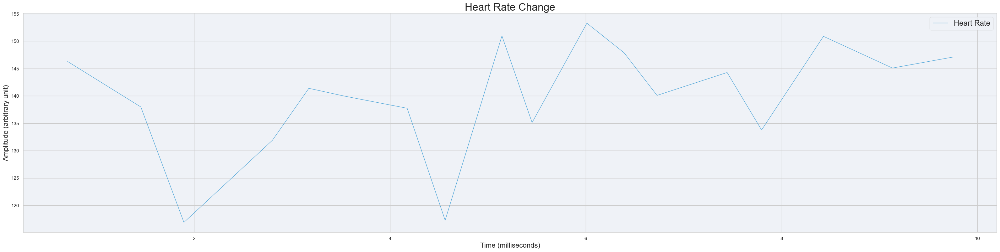

device data length:  (2, 240663)
13102 78098 64996
(13099, 28056) 0
(141798, 157022) 28056
(205585, 221193) 157022
[221193 240663] 221193


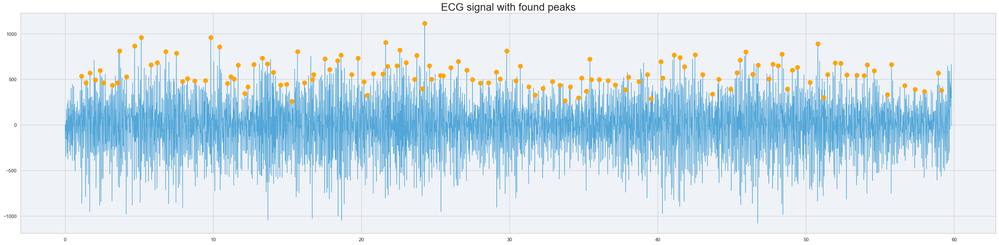

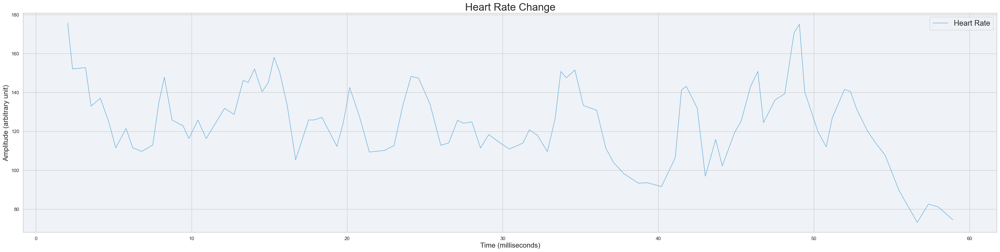

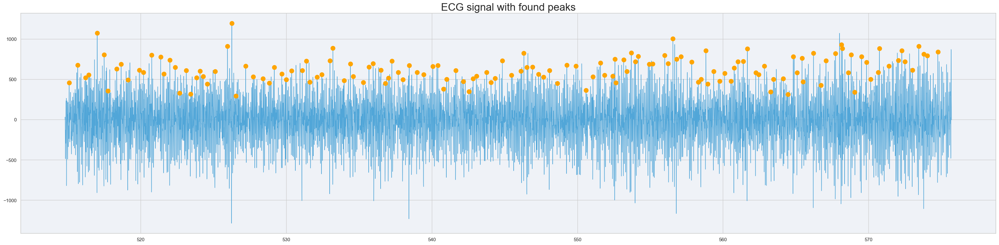

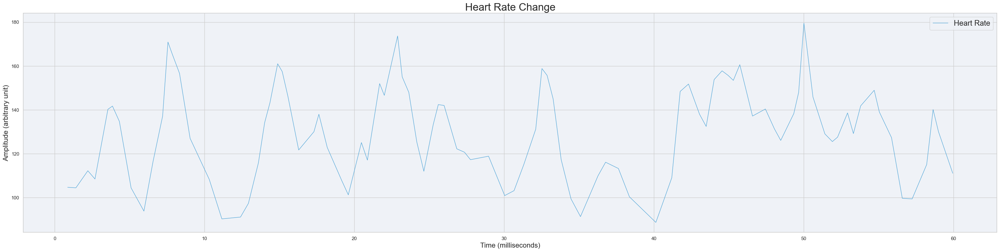

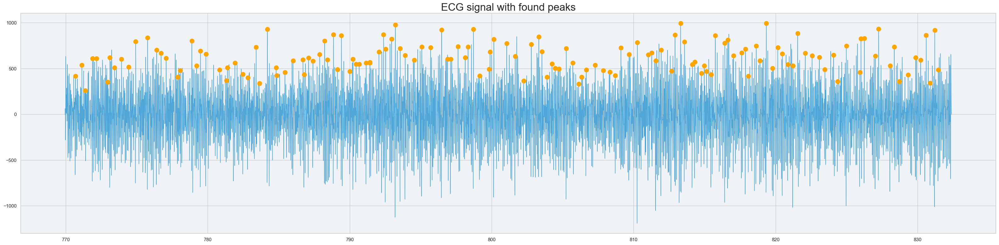

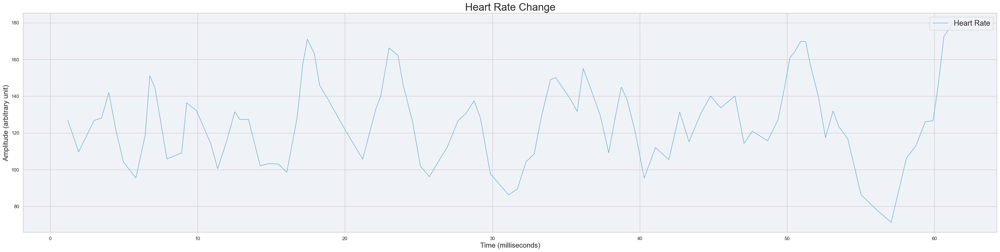

device data length:  (2, 381456)
14051 79038 64987
(14047, 31313) 0
(57550, 76266) 31313
(138777, 157391) 76266
[157391 381456] 157391


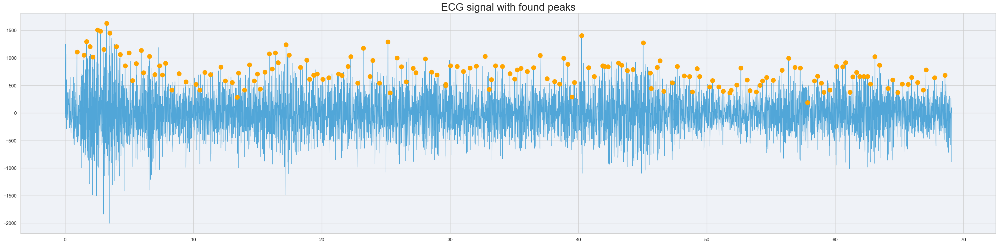

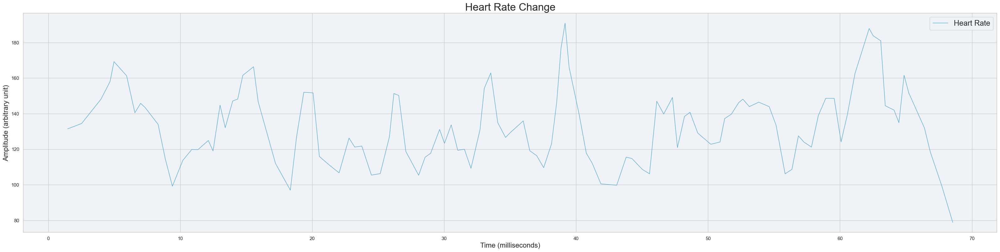

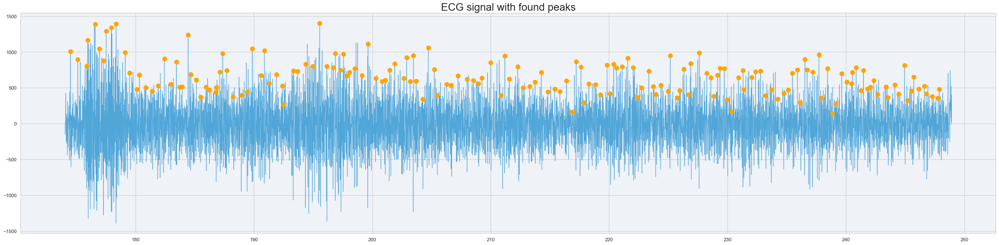

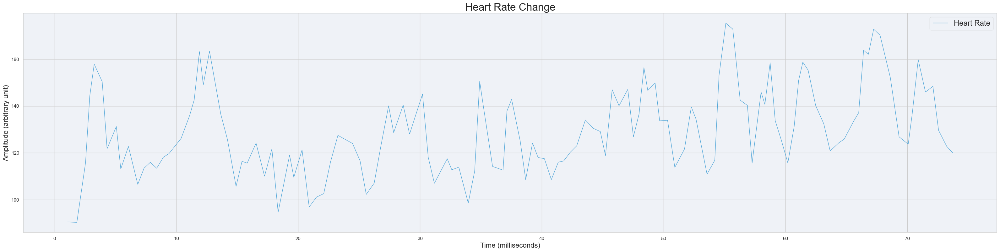

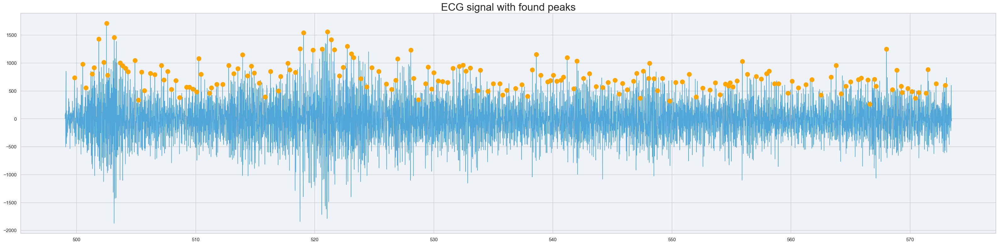

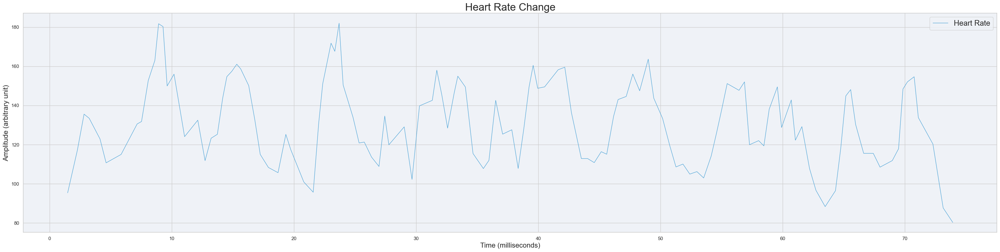

device data length:  (2, 129035)
8950 31693 22743
(8950, 11401) 0
(55277, 57453) 11401
(93998, 95937) 57453
[ 95937 129035] 95937


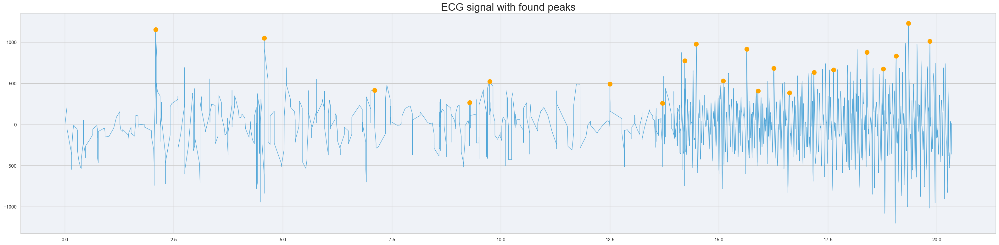

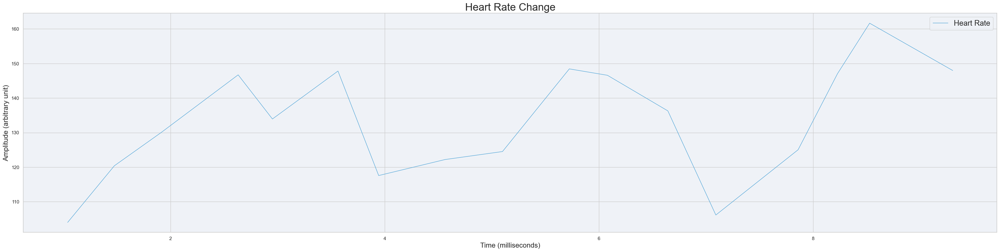

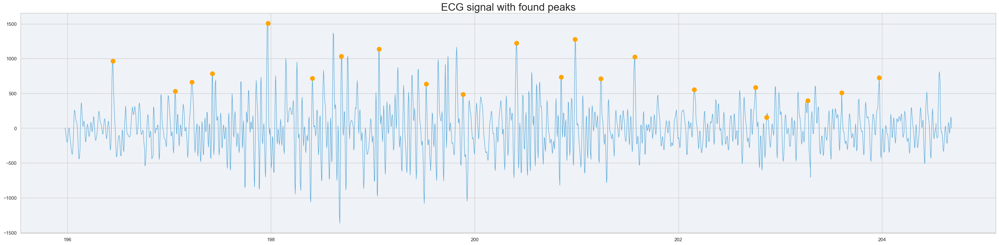

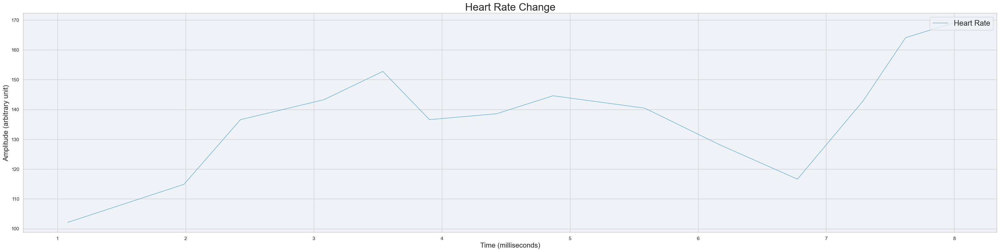

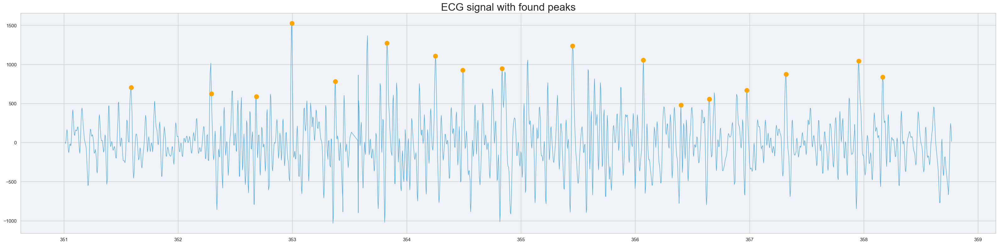

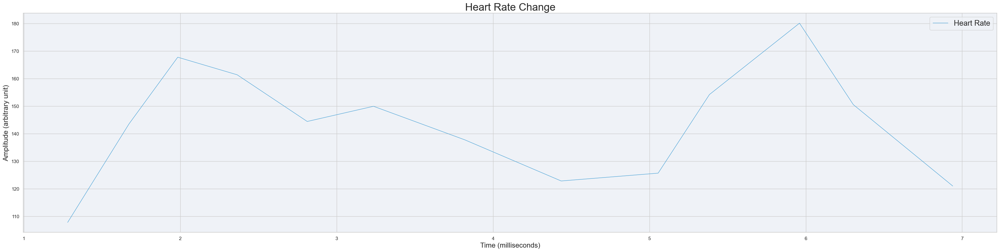

device data length:  (2, 187985)
54138 101986 47848
(54137, 55501) 0
(88695, 90310) 55501
(147383, 148831) 90310
[148831 187985] 148831


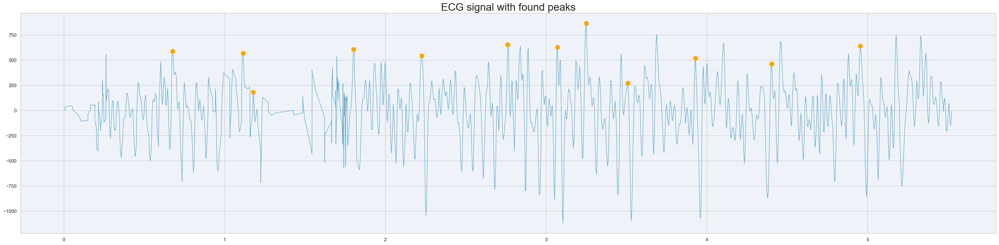

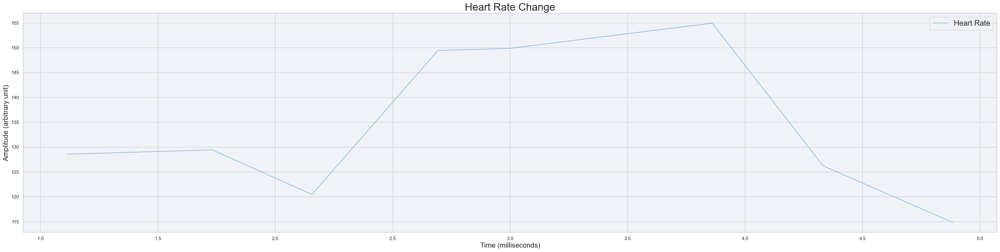

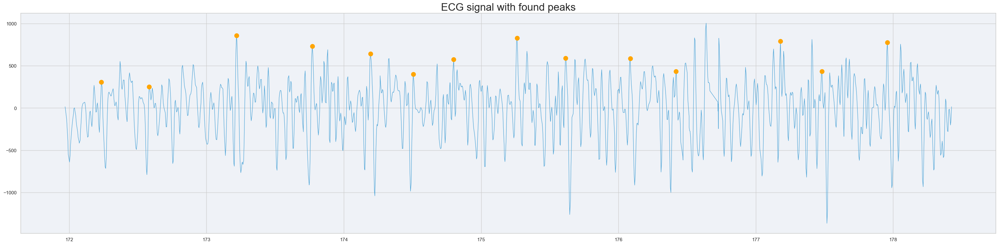

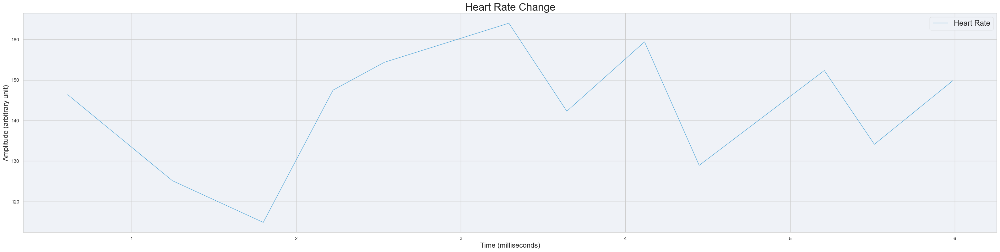

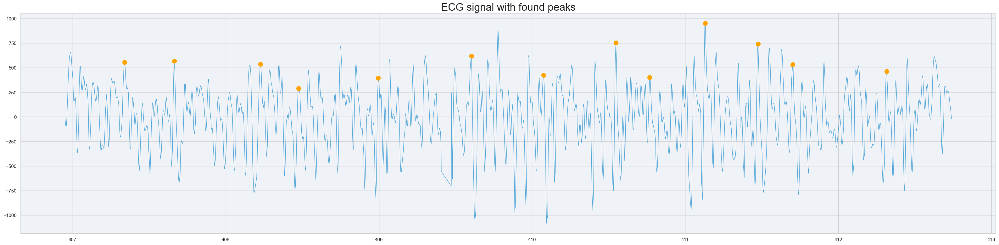

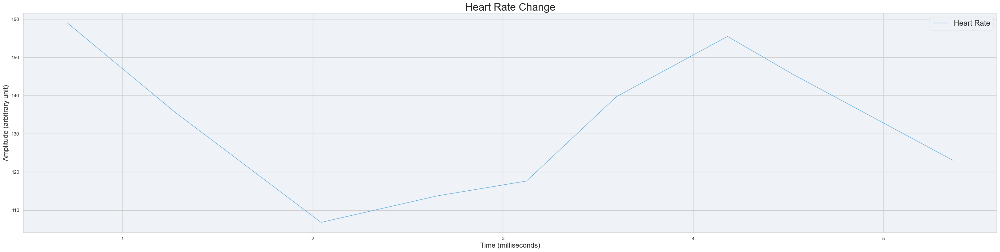

device data length:  (2, 169379)
19059 84034 64975
(19058, 37070) 0
(95005, 111209) 37070
(139063, 153896) 111209
[153896 169379] 153896


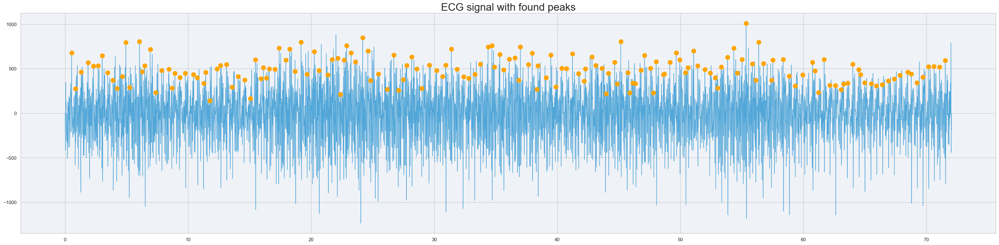

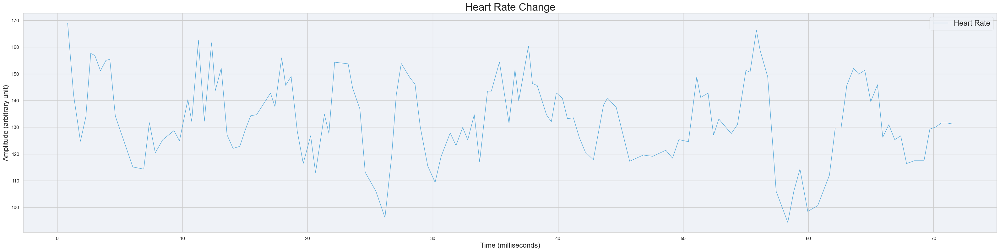

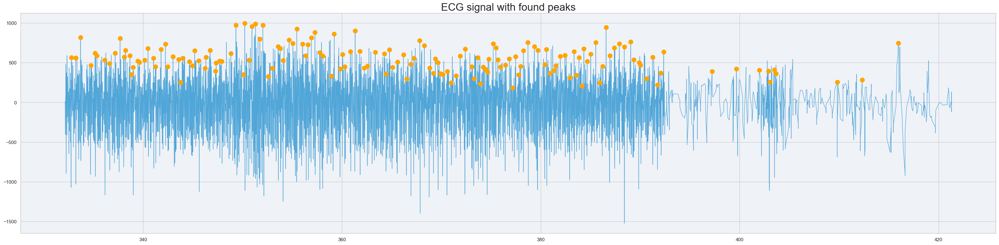

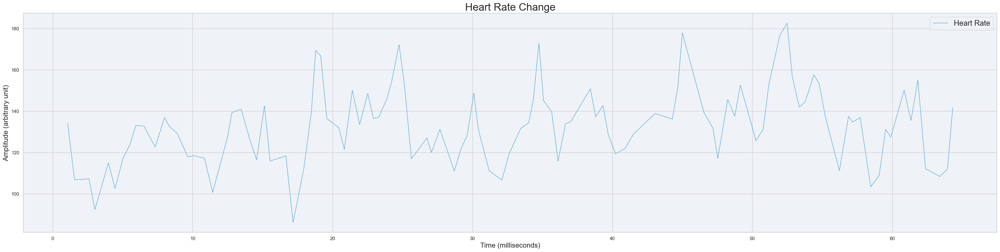

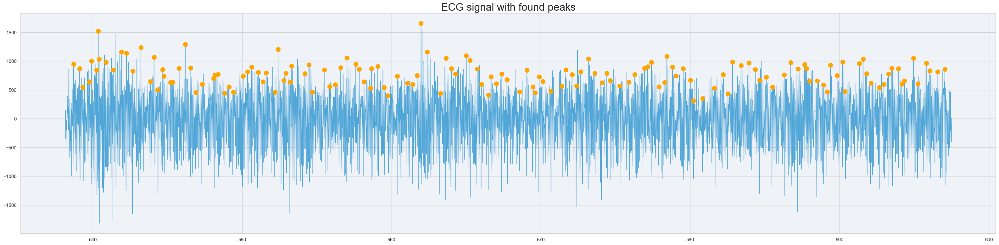

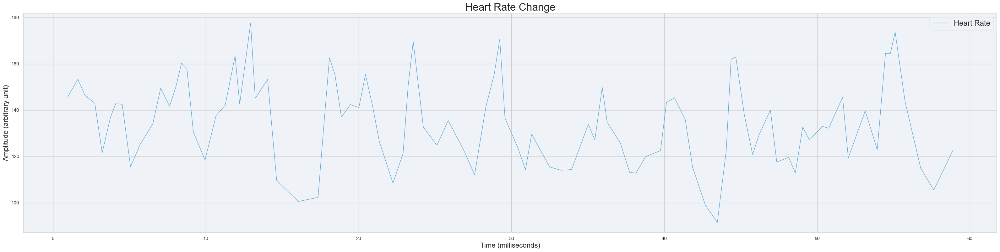

device data length:  (2, 139121)
24050 89043 64993
(24046, 50219) 0
(76054, 93768) 50219
(113562, 132476) 93768
[132476 139121] 132476


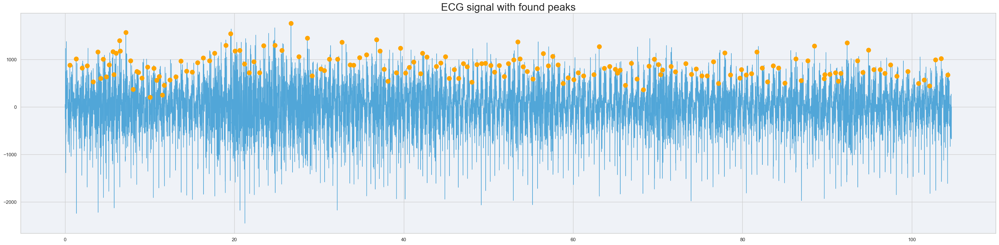

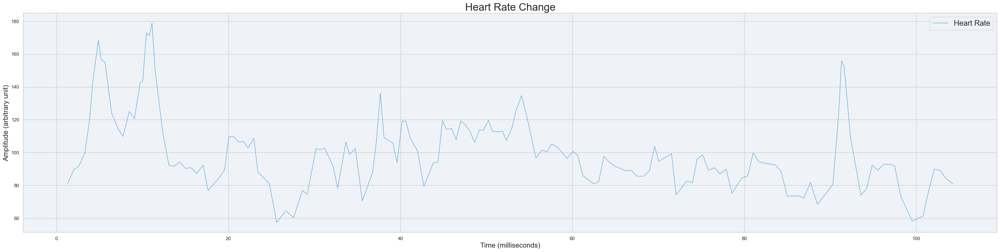

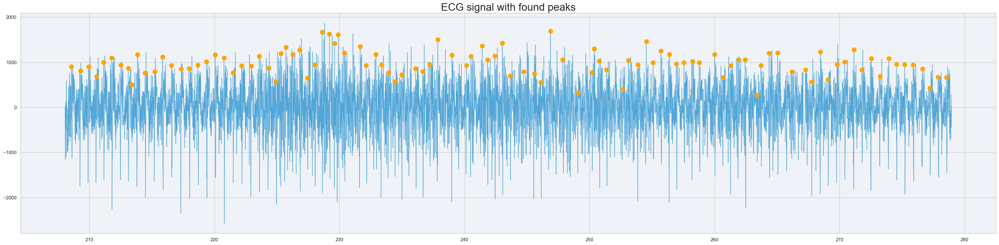

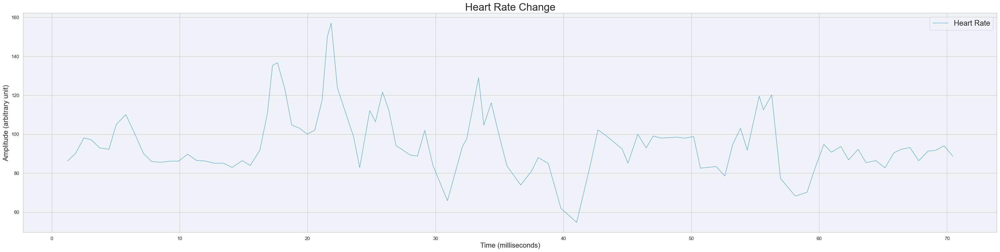

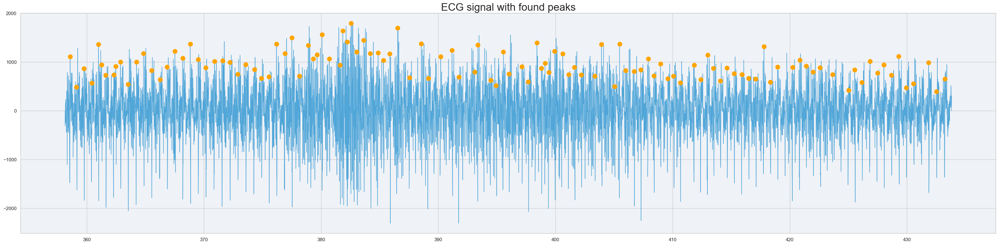

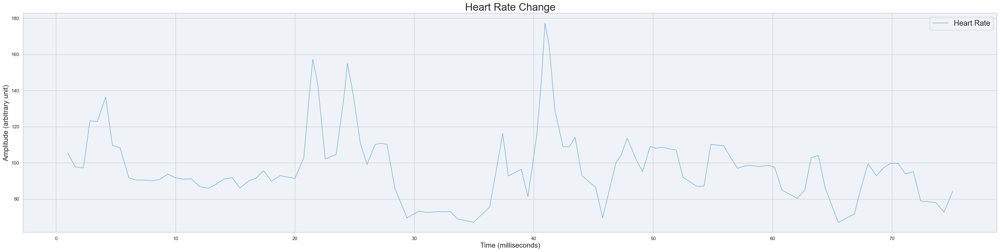

device data length:  (2, 208164)
8581 73571 64990
(8584, 30144) 0
(45091, 76293) 30144
(130063, 150205) 76293
[150205 208164] 150205


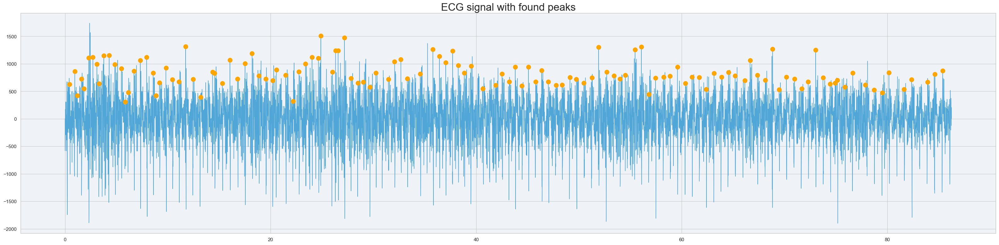

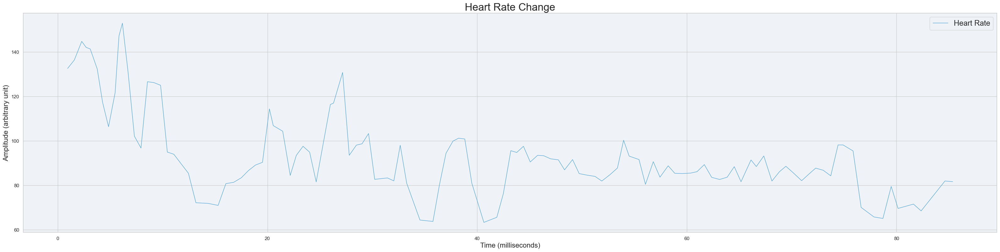

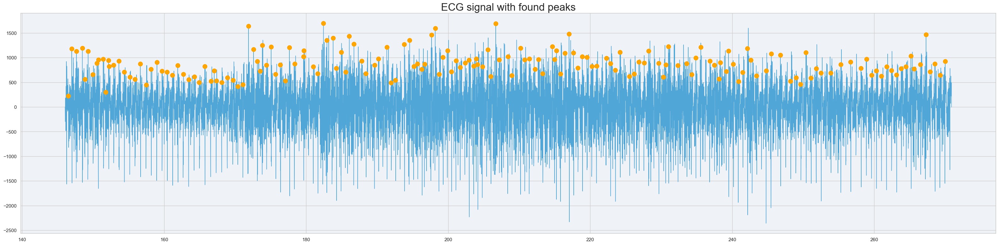

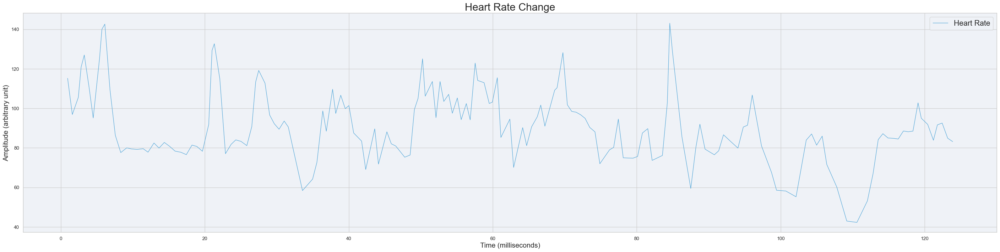

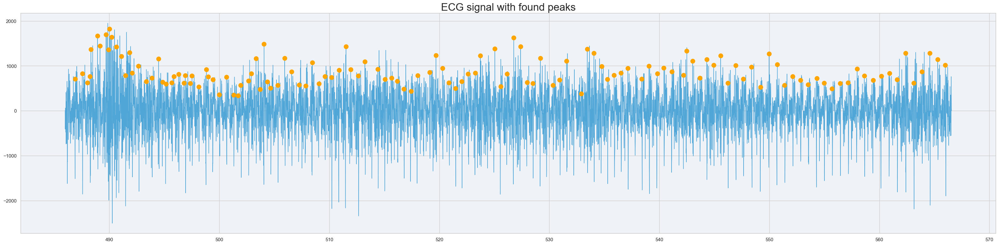

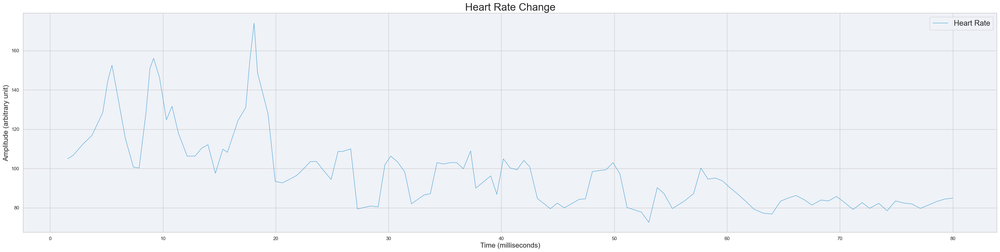

In [22]:
phase_labels = [
    "She enters","Goes to the window","He enters","Dialogue","Physical Contact","Embrace"
]

# filtered_json_files_list_hrv = [filtered_json_files_list[i] for i in [0,1]]

for jf_id, jf in enumerate(filtered_json_files_list[:]):
    times, sensors, duration = get_data_from_json(jf_id, dev_id, channel, False)
    start_time_index = [np.where(
        times==min(times, key=lambda x:abs(x-start_time)))[0][0] for start_time in takes_start_time_s[jf_id]]
    # end_time_seconds = np.add(start_times, durations).tolist()
    end_time_index = [np.where(
        times==min(times, key=lambda x:abs(x-end_time)))[0][0] for end_time in film_durations[jf_id]]
    last_end_index = 0
    for ranges in get_masked_ranges(start_time_index, end_time_index, len(times)):
        print(ranges, last_end_index)
        # print("pos: ", times[int(326 * 250)])
        # sensors = zero_until_range(sensors, ranges[0] if ranges[1] != len(times) else len(times), last_end_index)
        last_end_index = ranges[1]

    times = times[:] - takes_start_time_s[jf_id][0]
    df = pd.DataFrame({"index": times, "heartrate": sensors})

    df_slice = [pd.DataFrame() for _ in range(len(film_durations[jf_id]))]

    for take, ranges in enumerate(get_masked_ranges(start_time_index, end_time_index, len(times))[:-1]):
        start, stop = ranges

        # if [jf_id, take] not in hrv_pairs:
        #     continue

        # start = start - int(14000/4)
        start_time_seconds = takes_start_time_s[jf_id][take]
        # get slice data of sensor data
        cond_slice = (df.index >= start) & (df.index < stop)
        if (current_label != "ACC"):
            ecg_slice = df.heartrate[cond_slice]
            x_slice = ecg_slice
        else:
            x_slice = df.heartrate[cond_slice]
            ecg_slice = [[acc[0],acc[1],acc[2]] for acc in df.heartrate[cond_slice]]

        df_slice[take] = pd.DataFrame({"index": x_slice, "sensors": ecg_slice})
        # detect peaks
        # peaks, similarity = detect_peaks(ecg_slice, threshold=0.1)
        # normalised_ecg = (ecg_slice - ecg_slice.mean()) / ecg_slice.std()
        if (len(ecg_slice) > 1125):
            if (current_label == "ECG"):
                ecg_stats = ecg.ecg(signal=ecg_slice, sampling_rate=1000/4, show=0)
                ecg_slice_filtered = ecg_stats[1]
                peaks = ecg_stats[2]
                #hrv

            if (current_label == "ACC"):
                ecg_stats = acc.acc(signal=ecg_slice, sampling_rate=1000/10, interactive=0, show=0)

                smv = np.linalg.norm(np.array(ecg_slice), axis=1)
                smv = np.abs(smv)
                ecg_slice_filtered = ecg_stats[1]
                df_slice[take]["magnitude"] = ecg_stats[2]
                first_order_diff = np.diff(smv)
                second_order_diff = np.diff(first_order_diff)
                # ecg_slice_filtered = df_slice[take]["magnitude"].ewm(alpha=0.25, adjust=False).mean()
                # ecg_slice_filtered = np.convolve(ecg_slice_filtered, np.ones(10)/10, mode='same')
                ecg_slice_filtered = savgol_filter(first_order_diff, window_length=100, polyorder=3)
                signal_series = pd.Series(ecg_slice_filtered)

            # df_slice[take]["y"] = ecg_slice_filtered
                # n_parts = 1
                # split_signals = np.array_split(ecg_stats[1], n_parts)
                # for i, window in enumerate(split_signals):
                #     spectrum_features = acc.frequency_domain_feature_extractor(signal=window, sampling_rate=1000/10)
                    # plt.figure(figsize=(3, 3))
                    # for axs in ["x", "y", "z"]:
                    #     plt.plot(spectrum_features[0][axs], spectrum_features[1][axs])
                    # plt.xlim(0.0, 0.5)
                    # plt.ylim(0,0.1)
                    # plt.show()

            if (current_label == "EDA"):
                ecg_stats = eda.eda(signal=ecg_slice, sampling_rate=1000/10, show=1)
                ecg_slice_filtered = ecg_stats[1]
                # Extracted features (SCR, SCL, etc.)
                peaks = ecg_stats[5]
                edl = ecg_stats['edl']  # Skin conductance level
                edr = ecg_stats['edr']  # Skin conductance response
                ecg_slice_filtered = ecg_stats['filtered']  # The filtered EDA signal
        else:
            break

        # duration = times[stop] - times[start]
        # sample_freq = (stop-start)/duration
        # print("samples per second: ", sample_freq)
        # print("seconds: ", sample_freq * times[stop])
        # print("seconds: ", duration)

        # if (current_label == "ACC"):
        #     acc_slice_filtered = np.array(ecg_slice_filtered).T

        plt.figure(figsize=(40, 20))
        plt.subplot(211)
        plt.title(f"{current_label} signal with found peaks" if current_label != "ACC" else f"{current_label} signal", fontsize=24)
        # plt.plot(ecg_slice.index - start, ecg_slice_filtered, label="ECG", color="#51A6D8", linewidth=1)

        if (current_label != "ACC"):
            # plt.plot(times[x_slice.index] - times[x_slice.index][0], ecg_slice_filtered, label=current_label, color="#51A6D8", linewidth=1)
            plt.plot(times[x_slice.index], ecg_slice_filtered, label=current_label, color="#51A6D8", linewidth=1)
            plt.plot(times[peaks+start], ecg_slice_filtered[peaks], markersize=10, label="R-peak", color="orange", marker="o", linestyle="None")

        if (current_label == "ECG"):
            plt.figure(figsize=(40, 20))
            plt.subplot(212)
            plt.title("Heart Rate Change", fontsize=24)
            # plt.plot(ecg_slice.index, ecg_slice, label="ECG", color="#51A6D8", linewidth=1)
            # plt.plot(peaks, np.repeat(3000, peaks.shape[0]), markersize=10, label="peaks", color="orange", marker="o", linestyle="None")
            plt.plot(ecg_stats[5], ecg_stats[6], label="Heart Rate", color="#51A6D8", linewidth=1)

        #    triaxial data
        if (current_label == "ACC"):
            # plt.plot(times[x_slice.index], ecg_slice_filtered, label=current_label, color="#51A6D8", linewidth=3)
            # plt.plot(times[x_slice.index], (1*df_slice[take]["second_order_diff"]) + 1, label=current_label, color="orange", linewidth=3)
            # sns.lineplot(x=times[x_slice.index][1:], y=ecg_slice_filtered,estimator=np.mean, errorbar='sd')
            mean = signal_series.rolling(window=100, center=True).mean()
            std = signal_series.rolling(window=100, center=True).std()
            time = np.array(times, dtype=float)
            # time_clean = np.array(time)[valid_mask]
            plt.fill_between(time[x_slice.index][1:], mean - std, mean + std, color='blue', alpha=0.3, label='±1 SD')
            # df_slice[take]["x"] = times[x_slice.index] - times[x_slice.index][0]
            # df_slice[take]["y"] = ecg_slice_filtered
            # Define color groups based on x ranges
            # bins = [0,10,15,25,30,45,60,70]  # Define split points along X-axis
            # color_labels = pd.cut(df_slice[take]["x"], bins=bins, labels=phase_labels)
            # df_slice[take]["Group"] = color_labels
            # sns.lineplot(data=df_slice[take], x="x", y="y", hue="Group", alpha=0.5, palette="turbo")
            # plt.ylim(0.9, 1.1)
            # plt.annotate('This point is interesting!', xy=(0, 1), xytext=(0, 1), arrowprops=dict(facecolor='black', shrink=0.05))
            # plt.show()

        plt.legend(loc="upper right", fontsize="x-large")
        plt.xlabel("Time (milliseconds)", fontsize=16)
        plt.ylabel("Amplitude (arbitrary unit)", fontsize=16)
        # plt.legend(["She enters", "She removes shoes", "He calls", "Dialogue Between he and she", "Contact", "Two Shot"], loc="upper right", fontsize="x-large")
        # break
    # if (current_label == "ACC"):
    #     df_slice_combined = pd.concat(df_slice)  # Resets index
    #     sns.lineplot(data=df_slice_combined, x="x", y="y", hue="Group", alpha=0.5, palette="turbo",estimator=np.mean, errorbar='sd')
    plt.show()

## Load data

In [23]:
file_dir = "../Data/Sensors/"

def get_json_files(directory):
  json_files = []
  for root, _, files in os.walk(directory):
    for file in files:
      if file.endswith(".json"):
        json_files.append(os.path.join(root, file))
  return json_files

def filter_strings_by_substrings(strings, substrings):
    return [s for s in strings if not any(sub.lower() in s.lower() for sub in substrings)]

def filter_dict_keys_by_substrings(data: dict, substrings: list) -> dict:
    return {
        key: value
        for key, value in data.items()
        if not any(sub in key for sub in substrings)
    }

json_files_list = sorted(get_json_files(file_dir))
filtered_json_files_list = filter_strings_by_substrings(json_files_list, ["Resting", "s7"])
for json_file, i in enumerate(filtered_json_files_list):
    print(json_file, i)

filtered_take_1_timestamps = filter_dict_keys_by_substrings(take_1_timestamps, ["resting"])
print(list(filtered_take_1_timestamps.values())[:])

# Open and read the JSON file
def get_json_data (file_name):
    with open(file_name, 'r') as file:
        data = json.load(file)
        return data

def get_duration(data):
    total_duration = data[-1]['time']
    print(total_duration / 60)

def zero_until_range(data, start_index, last_end_index):
    zero = [0.55, 0.55, 0.55]
    print(start_index, last_end_index)
    return [zero if i < start_index and i >= last_end_index else data[i] for i in range(len(data))]

def get_masked_ranges(start_times, durations, length):
    ranges = [(start, start + duration - 1) for start, duration in zip(start_times, durations)]
    ranges.append(np.array([ranges[-1][1], length]))
    return ranges

0 ../Data/Sensors/Day_1/s1/recordings-102224-10_53_51.json
1 ../Data/Sensors/Day_1/s1/recordings-102224-11_31_23.json
2 ../Data/Sensors/Day_1/s2/recordings-102224-12_54_59.json
3 ../Data/Sensors/Day_1/s2/recordings-102224-13_55_08.json
4 ../Data/Sensors/Day_1/s3/recordings-102224-14_49_27.json
5 ../Data/Sensors/Day_1/s3/recordings-102224-15_41_51.json
6 ../Data/Sensors/Day_2/s4/recordings-102324-09_46_10.json
7 ../Data/Sensors/Day_2/s4/recordings-102324-10_42_20.json
8 ../Data/Sensors/Day_2/s5/recordings-102324-12_10_52.json
9 ../Data/Sensors/Day_2/s5/recordings-102324-12_55_16.json
10 ../Data/Sensors/Day_2/s6/recordings-102324-13_41_18.json
11 ../Data/Sensors/Day_2/s6/recordings-102324-14_36_31.json
[35.25, 25.375, 57.25, 37.333333, 60.333333, 52.416667, 56.208333, 194.25, 285.25, 76.25, 96.208333, 34.333333]


## Explore data

../Data/Sensors/Day_1/s2/recordings-102224-13_55_08.json 3
device data length:  (2, 217463)
9329 74323 64994


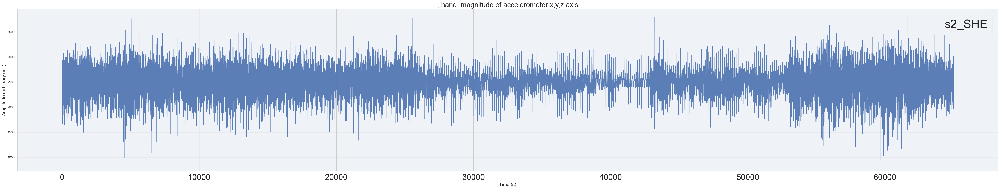

In [24]:
current_label = label_options.value
current_label = "ECG"
# trim = 1250
# trim = 12000
trim = -1
DoP_ID = 0

#ACC
if (current_label == "ACC"):
    dev_id = 7
    channel = 0
#ECG
if (current_label == "ECG"):
    dev_id = 10
    channel = 12
#EDA
if (current_label == "EDA"):
    dev_id = 0
    channel = 12

start_time_seconds = 0

def get_data_from_json(file_ID, dev_id, channel, show_graph=True):
    data = get_json_data(filtered_json_files_list[file_ID])

    total_duration = data[-1]['time']
    # print(total_duration / 60)

    # Extract addresses and find unique instances
    addresses = [item.get('address') for item in data if item.get('address')]

    # prompt: initiate dictionary from unique_addresses with 2 dimentional arrays as velues
    unique_addresses = set(addresses)

    device_data = {address: [] for address in unique_addresses}
    data_timeline = {address: [] for address in unique_addresses}

    for item in data:
        address = item.get('address')
        id = re.search(r"/(\d+)/", address).group(1)
        data_timeline[address].append([item['time'], item['args']])

    for address in unique_addresses:
        times = [entry[0] for entry in data_timeline[address]]
        args = [entry[1] for entry in data_timeline[address]]
        device_data[address] = [times, args]

    try:
        device_data = np.asarray(device_data["/%s/raw" % dev_id], dtype="object")
        print("device data length: ", device_data.shape)
    except KeyError:
        if (current_label != "ACC"):
            return 0
        device_data = np.asarray(device_data["/%s/raw" % 3], dtype="object")
        print("device data length: ", device_data.shape)
    # Assuming graph contains [time, args]
    times = device_data[0]  # First part (e.g., time)
    if (channel == 0):
        sensors = [[entry[0][channel], entry[0][channel+1], entry[0][channel+2]] for entry in device_data[1]]  # Assuming entry[1] is the args part
        magnitude = [sqrt(pow(entry[0][channel], 2) + pow(entry[0][channel+1], 2) + pow(entry[0][channel+2], 2)) for entry in device_data[1]]
    else:
        sensors = [entry[0][channel] for entry in device_data[1]]  # Assuming entry[1] is the args part

    start_time_seconds = list(filtered_take_1_timestamps.values())[file_ID]
    # print("start_time_seconds: ", start_time_seconds)
    start_time_index = np.where(
        times==min(times, key=lambda x:abs(x-start_time_seconds)))[0][0]

    end_time_seconds = 260
    end_time_index = np.where(
        times==min(times, key=lambda x:abs(x-end_time_seconds)))[0][0] + start_time_index
    # end_time_index = (100*end_time_seconds) + start_time_index

    diff = end_time_index - start_time_index
    print(start_time_index, end_time_index, diff)

    sensors_graph = sensors[:trim]
    if (channel == 0):
        sensors_graph = magnitude[start_time_index:end_time_index]
    else:
        sensors_graph = sensors[start_time_index:end_time_index]

    # times_graph = times[start_time_index:end_time_index] - times[start_time_index]
    times_graph = np.arange(end_time_index - start_time_index)

    # plt.figure(figsize=(60, 10))
    # start = 0
    # stop = 5000
    # duration = (stop-start) / settings['fs']
    duration = times[trim]
    if show_graph:
        # plt.title("%s, %s, %s" % (identifiers[file_ID], "hand", "magnitude of accelerometer x,y,z axis"), fontsize=24)
        plt.plot(times_graph, sensors_graph, linewidth=1, alpha=0.90, label=identifiers[file_ID])
        plt.xticks(fontsize=28)
    # return times, sensors, duration
    return times, sensors, duration

# for jf_id, jf in enumerate(json_files_list[:-4]):
plt.figure(figsize=(60, 10))
plt.title("%s, %s, %s" % ("", "hand", "magnitude of accelerometer x,y,z axis"), fontsize=24)
plt.xlabel("Time (s)", fontsize=16)
plt.ylabel("Amplitude (arbitrary unit)", fontsize=16)

DoP_ID = 0
# for jf_id, jf in enumerate(json_files_list[:-4]):
for jf_id, jf in enumerate(filtered_json_files_list[:]):
    if "Resting" not in jf and jf_id == 3:
        jf_id = filtered_json_files_list.index(jf)
        print (jf, jf_id)
        times, sensors, duration = get_data_from_json(jf_id, dev_id, channel)
        DoP_ID += 1

plt.legend(loc="upper right", fontsize=40)
plt.show()

## Find RR-intervals

### Peak detection using template matching & threshold

In [25]:
takes_start_time_s = [[35.255, 208.39499999999998, 375.365], [25.365, 172.235, 328.295], [57.255, 303.33500000000004, 514.325], [37.325, 257.225, 473.41499999999996, 743.2750000000001], [60.335, 313.325, 477.375], [52.405, 567.2149999999999, 822.365],
                      [56.195, 230.255, 555.235], [194.245, 390.225, 545.255], [285.225, 457.19500000000005, 692.175], [76.245, 408.40500000000003, 614.395], [96.195, 304.255, 454.34499999999997], [34.345, 180.395, 520.335]]

film_durations = [[73.962667, 84.629333, 73.589333], [70.912000, 69.760000, 64.640000],
                  [83.520000, 84.352000, 86.357333], [97.664000, 110.357333, 114.517333, 113.344000],
                  [59.626667, 63.594667, 68.906667], [59.840000, 60.906667, 62.442667],
                  [69.077333, 74.880000, 74.474667], [88.384000, 77.120000, 66.026667],
                  [68.714667, 74.837333, 70.037333], [72.064000, 64.832000, 59.349333],
                  [104.704000, 70.869333, 75.669333], [86.272000, 124.842667, 80.597333]]

show_raw = True

nr_plots = 1
# window_size = 250

hrv_pairs = [[0, 0], [0, 1]
,[1, 0], [1, 1]]#,
# [[3,1], [5,2], [9,2], [11,2]]

# hrv_pairs = [[0, 0], [0, 1], [0, 2],[1, 0], [1, 1], [1, 2],
#              [2, 0], [2, 1], [2, 2],[3, 0], [3, 1], [3, 2], [3,3],
#              [4, 0], [4, 1], [4, 2],[5, 0], [5, 1], [5, 2],
#              [6, 0], [6, 1], [6, 2],[7, 0], [7, 1], [7, 2],
#              [8, 0], [8, 1], [8, 2],[9, 0], [9, 1], [9, 2],
#              [10, 0], [10, 1], [10, 2],[11, 0], [11, 1], [11, 2]]

# SHE
# hrv_pairs = [[0, 0], [0, 1], [0, 2],
#              [3, 0], [3, 1], [3, 2], [3,3],
#              [4, 0], [4, 1], [4, 2],
#              [7, 0], [7, 1], [7, 2],
#              [8, 0], [8, 1], [8, 2],
#              [11, 0], [11, 1], [11, 2]]

# # HE
# hrv_pairs = [[1, 0], [1, 1], [1, 2],
#              [2, 0], [2, 1], [2, 2],
#              [5, 0], [5, 1], [5, 2],
#              [6, 0], [6, 1], [6, 2],
#              [9, 0], [9, 1], [9, 2],
#              [10, 0], [10, 1], [10, 2]]

# timeline_x = [0, 10, 20, 30, 40, 50, 60]

filtered_json_files_list_hrv = [filtered_json_files_list[i] for i in [0,1]]

df_features = [pd.DataFrame() for _ in range(len(hrv_pairs))]

phase_labels = [
"She enters","Goes to the window","He enters","Dialogue","Physical Contact"
]

print(len(df_features))
# takes_start_time_padded = [[elem - 3500 for elem in row] for row in takes_start_time_s]

4


device data length:  (2, 101678)
8803 73791 64988
======Next Take======
ranges 5554 28304
session,  s1_SHE
take:  0
processing features for  ECG
======Next Sampling Window======
start_stop:  (5554, 8804)
times[start], times[stop]:  -12.999375209000284 0.0012727910008081267
(start / 250) - takes_start_time_s[jf_id][0]:  -13.039000000000001
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
0.0012727910008081267 -12.999375209000284


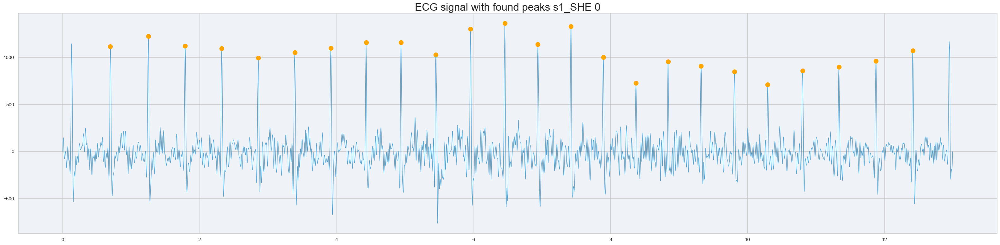

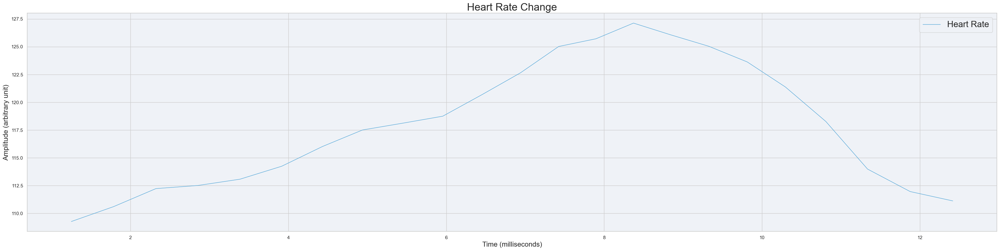

======Next Sampling Window======
start_stop:  (8804, 12054)
times[start], times[stop]:  0.0012727910008081267 13.004957624999513
(start / 250) - takes_start_time_s[jf_id][0]:  -0.03900000000000148
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
13.004957624999513 -12.999375209000284


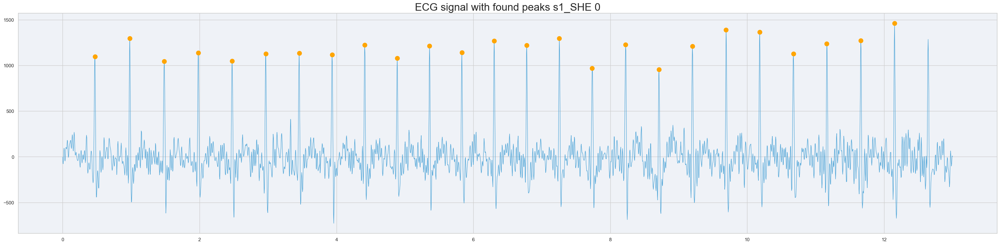

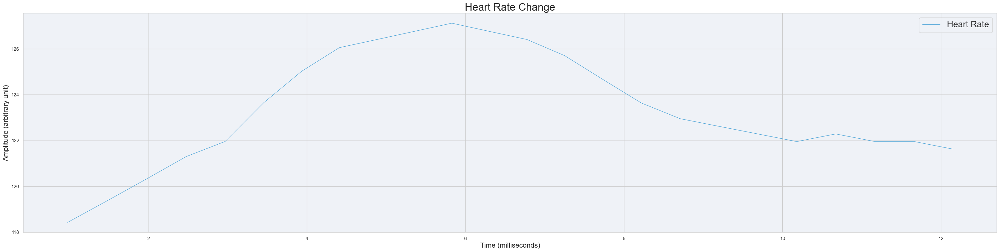

======Next Sampling Window======
start_stop:  (12054, 15304)
times[start], times[stop]:  13.004957624999513 26.00504991599984
(start / 250) - takes_start_time_s[jf_id][0]:  12.960999999999999
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
26.00504991599984 -12.999375209000284


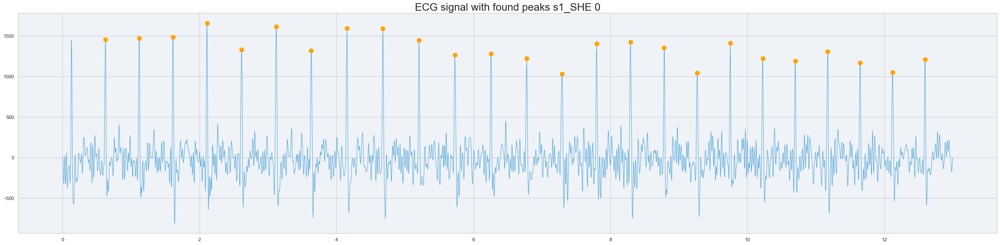

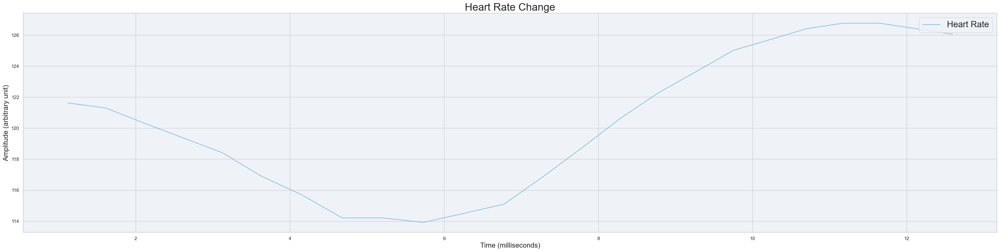

======Next Sampling Window======
start_stop:  (15304, 18554)
times[start], times[stop]:  26.00504991599984 39.00553699999829
(start / 250) - takes_start_time_s[jf_id][0]:  25.961
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
39.00553699999829 -12.999375209000284


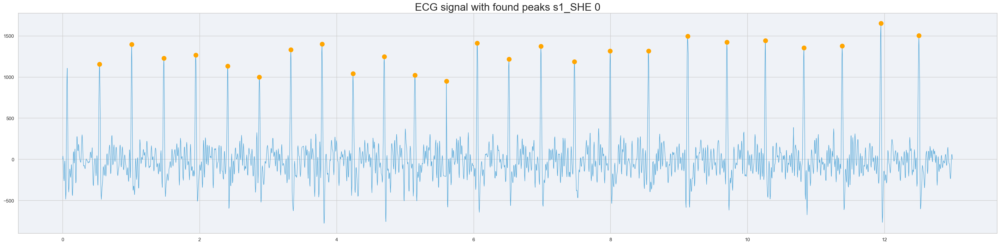

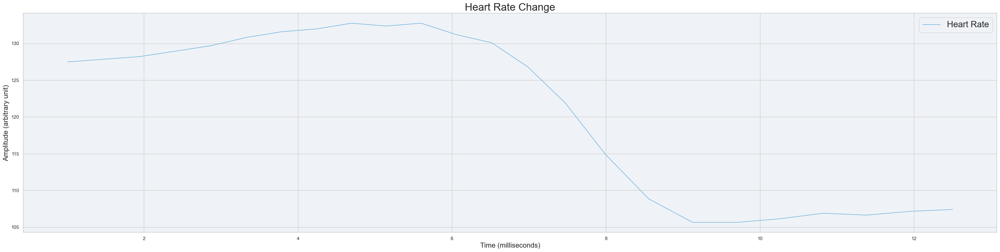

======Next Sampling Window======
start_stop:  (18554, 21804)
times[start], times[stop]:  39.00553699999829 52.00932508300058
(start / 250) - takes_start_time_s[jf_id][0]:  38.96099999999999
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
52.00932508300058 -12.999375209000284


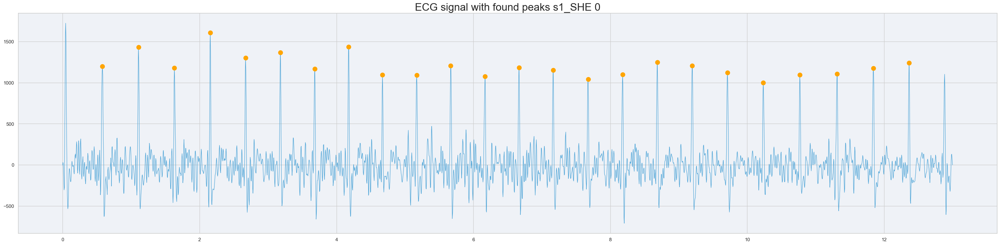

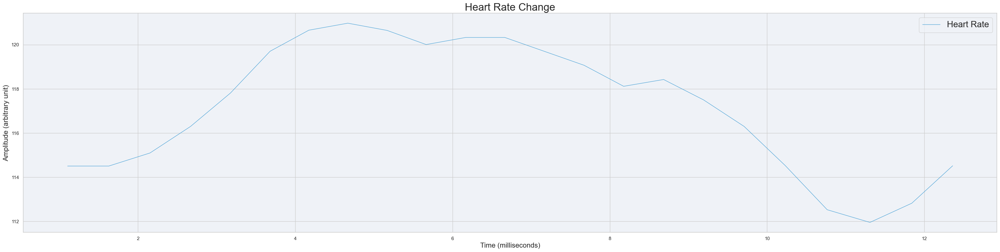

======Next Sampling Window======
start_stop:  (21804, 25054)
times[start], times[stop]:  52.00932508300058 65.00893654099957
(start / 250) - takes_start_time_s[jf_id][0]:  51.96099999999999
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
65.00893654099957 -12.999375209000284


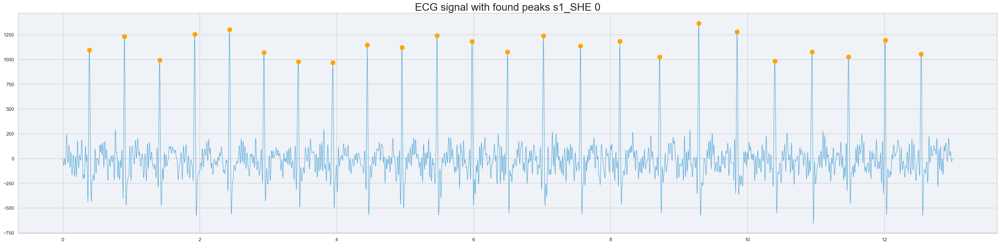

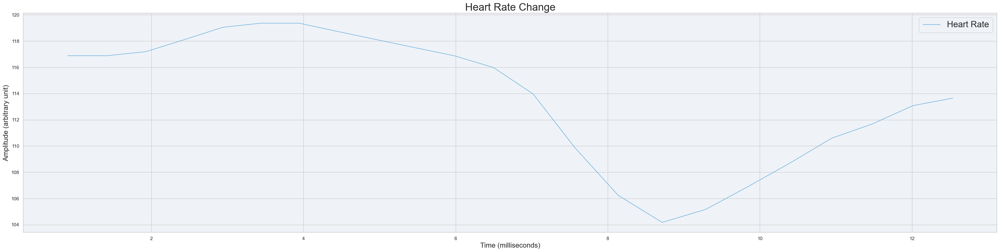

======Next Sampling Window======
start_stop:  (25054, 28304)
times[start], times[stop]:  65.00893654099957 78.00910366599885
(start / 250) - takes_start_time_s[jf_id][0]:  64.96099999999998
78 - times[stop]:  -0.009103665998850374
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
78.00910366599885 -12.999375209000284


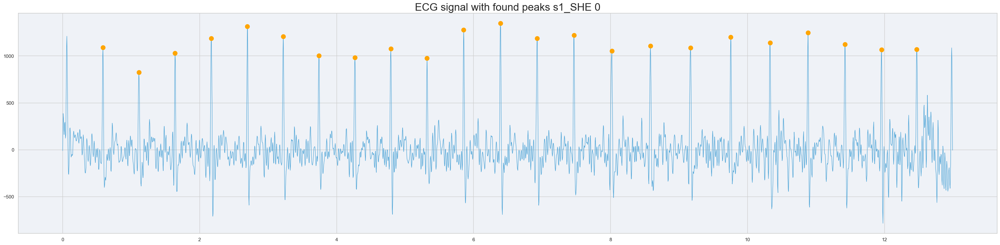

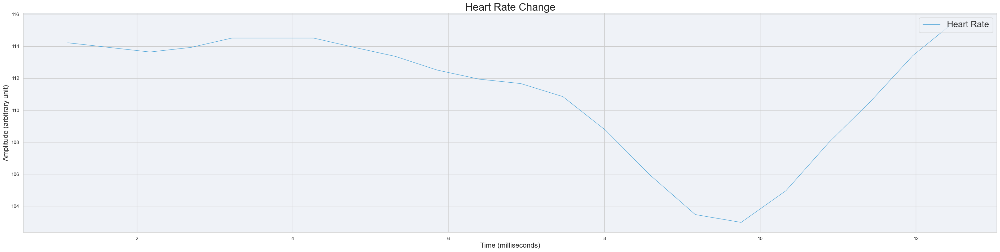

List is not empty
[[], [0.0, 10.977881032972004], [13.000648000001092, 4.545474799818093], [26.004332833999797, 6.0597175354969135], [39.004425125000125, 12.540472530040168], [52.004912208998576, 8.08768362578632], [65.00870029200087, 10.6238342356106], [78.00831174999985, 10.924261053584518]]
======Next Take======
ranges 48837 71587
session,  s1_SHE
take:  1
processing features for  ECG
======Next Sampling Window======
start_stop:  (48837, 52087)
times[start], times[stop]:  160.1418657910009 173.14184070799922
(start / 250) - takes_start_time_s[jf_id][0]:  160.09300000000002
78 - times[stop]:  -95.14184070799922
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
173.14184070799922 160.1418657910009


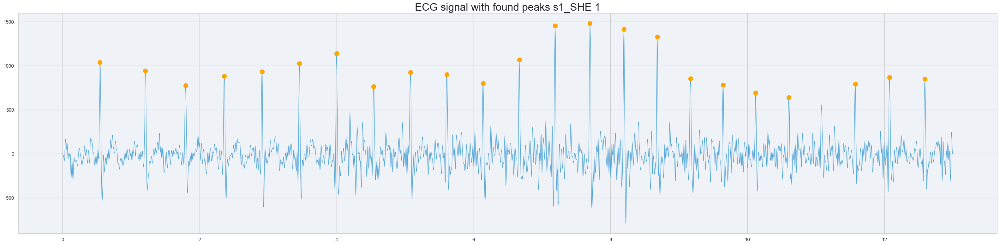

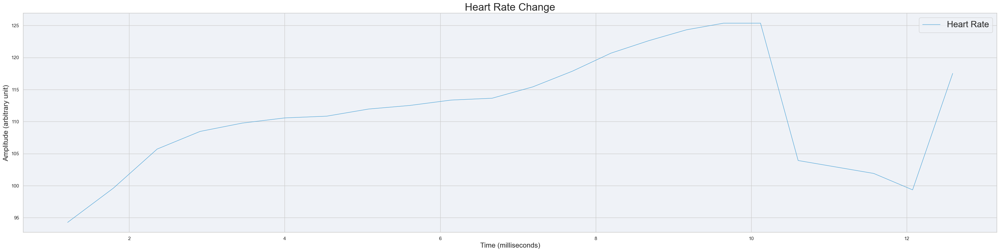

======Next Sampling Window======
start_stop:  (52087, 55337)
times[start], times[stop]:  173.14184070799922 186.1426729999995
(start / 250) - takes_start_time_s[jf_id][0]:  173.09300000000002
78 - times[stop]:  -108.14267299999949
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
186.1426729999995 160.1418657910009


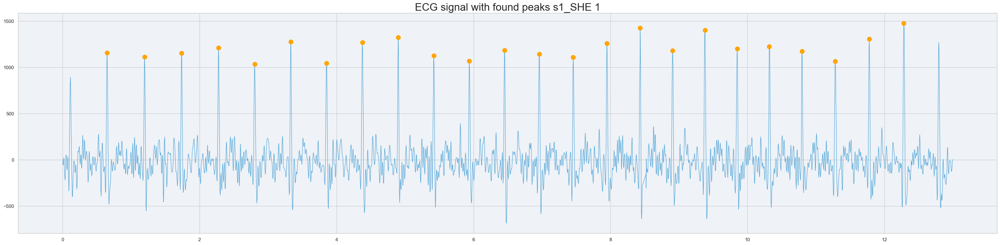

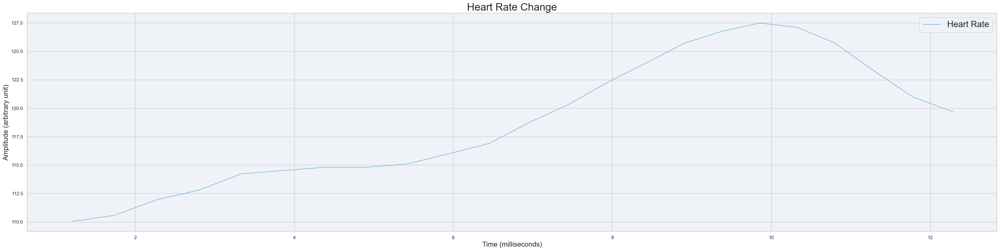

======Next Sampling Window======
start_stop:  (55337, 58587)
times[start], times[stop]:  186.1426729999995 199.14226145799796
(start / 250) - takes_start_time_s[jf_id][0]:  186.09300000000002
78 - times[stop]:  -121.14226145799796
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
199.14226145799796 160.1418657910009


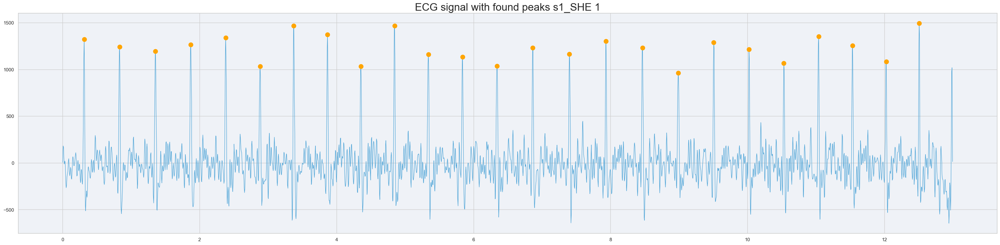

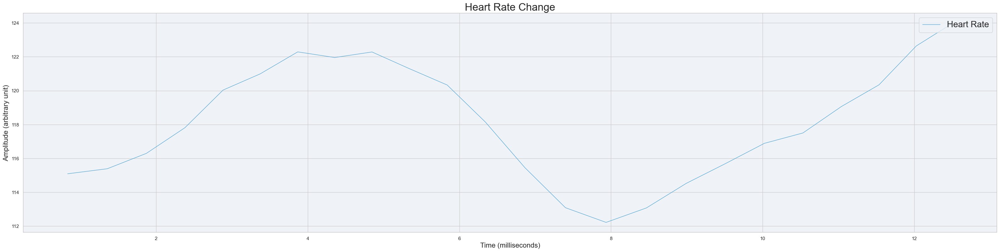

======Next Sampling Window======
start_stop:  (58587, 61837)
times[start], times[stop]:  199.14226145799796 212.1420145409985
(start / 250) - takes_start_time_s[jf_id][0]:  199.09300000000002
78 - times[stop]:  -134.1420145409985
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
212.1420145409985 160.1418657910009


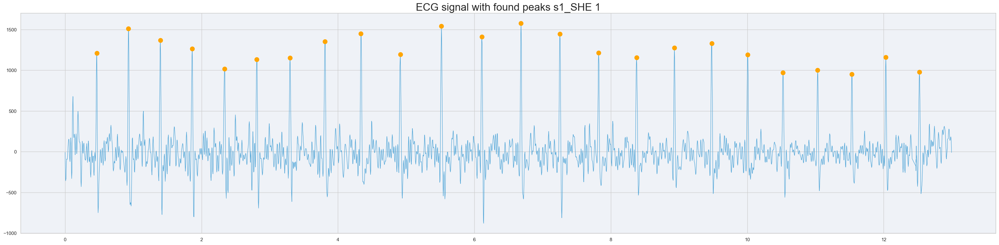

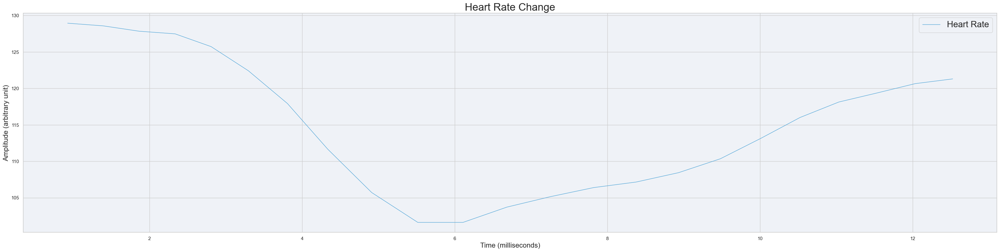

======Next Sampling Window======
start_stop:  (61837, 65087)
times[start], times[stop]:  212.1420145409985 225.1426491249996
(start / 250) - takes_start_time_s[jf_id][0]:  212.09300000000002
78 - times[stop]:  -147.1426491249996
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
225.1426491249996 160.1418657910009


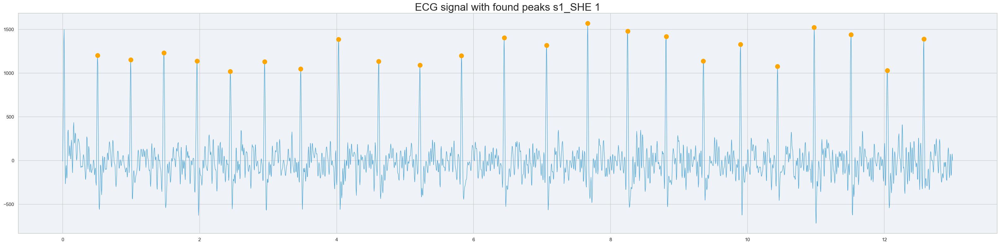

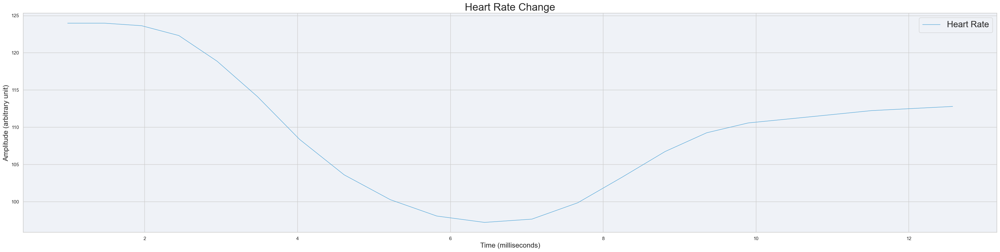

======Next Sampling Window======
start_stop:  (65087, 68337)
times[start], times[stop]:  225.1426491249996 238.14320308300114
(start / 250) - takes_start_time_s[jf_id][0]:  225.09300000000002
78 - times[stop]:  -160.14320308300114
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
238.14320308300114 160.1418657910009


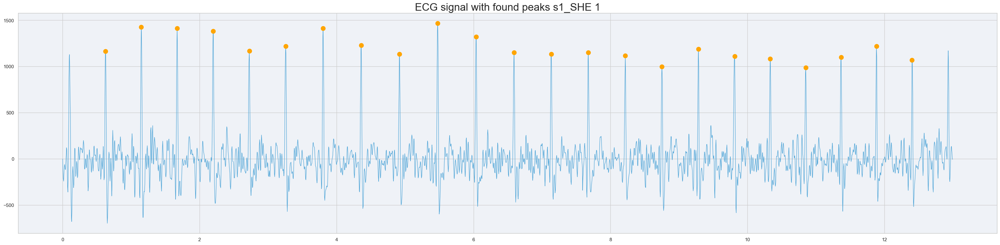

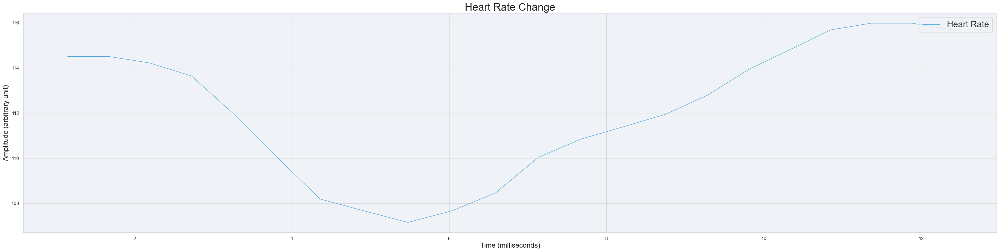

======Next Sampling Window======
start_stop:  (68337, 71587)
times[start], times[stop]:  238.14320308300114 251.14342408299956
(start / 250) - takes_start_time_s[jf_id][0]:  238.09300000000002
78 - times[stop]:  -173.14342408299956
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
251.14342408299956 160.1418657910009


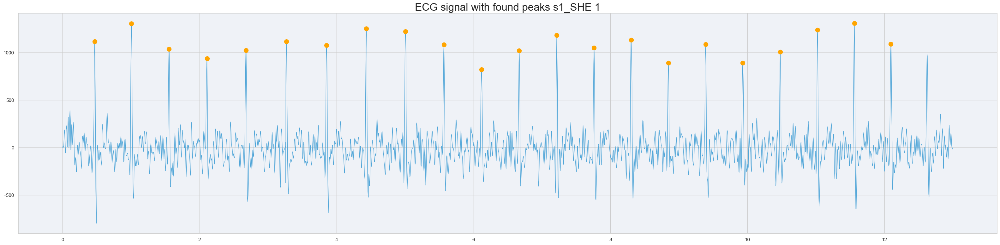

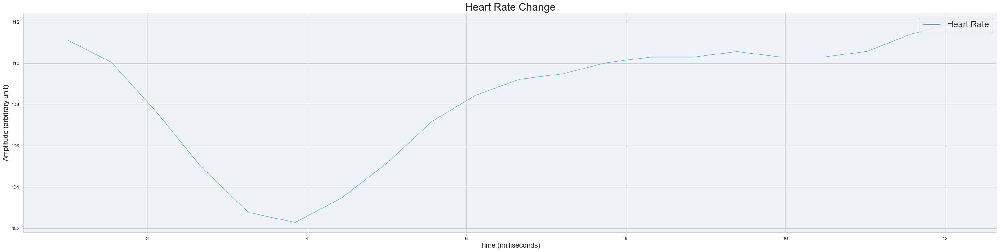

List is not empty
[[], [0.0, 17.946101662196508], [12.999974916998326, 6.668861539918877], [26.000807208998594, 8.471834787125772], [39.000395666997065, 15.923631599318062], [52.00014874999761, 14.88145710379653], [65.0007833339987, 6.2568431695831705], [78.00133729200024, 9.062933126852052]]
======Next Take======
ranges 78312 101062
device data length:  (2, 116144)
6339 71334 64995
======Next Take======
ranges 3087 25837
session,  s1_HE
take:  0
processing features for  ECG
======Next Sampling Window======
start_stop:  (3087, 6337)
times[start], times[stop]:  -13.00522233399737 0.0005278750011363798
(start / 250) - takes_start_time_s[jf_id][0]:  -13.016999999999998
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
0.0005278750011363798 -13.00522233399737


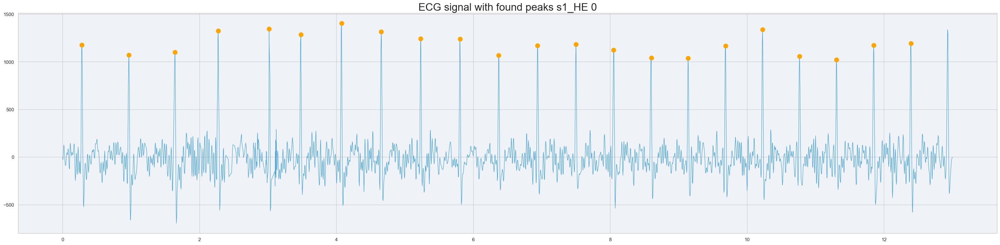

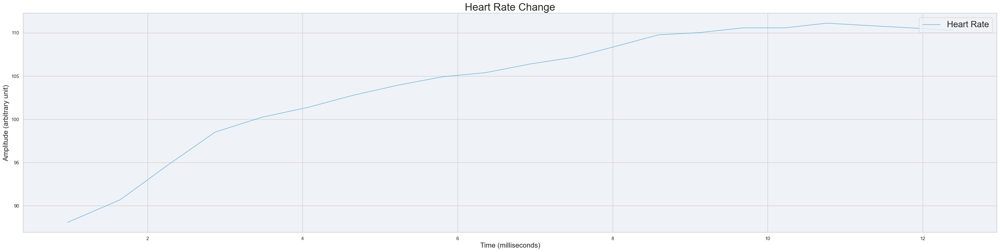

======Next Sampling Window======
start_stop:  (6337, 9587)
times[start], times[stop]:  0.0005278750011363798 13.002036958003156
(start / 250) - takes_start_time_s[jf_id][0]:  -0.01699999999999946
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
13.002036958003156 -13.00522233399737


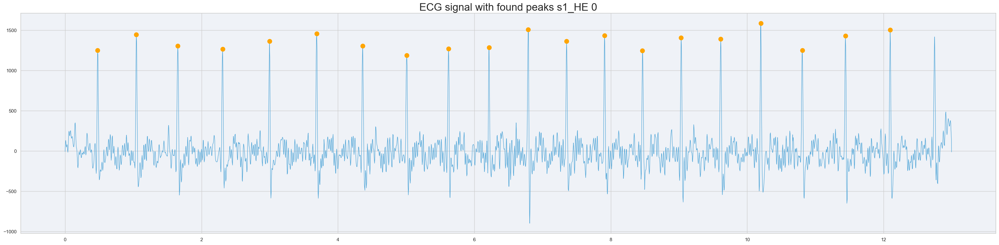

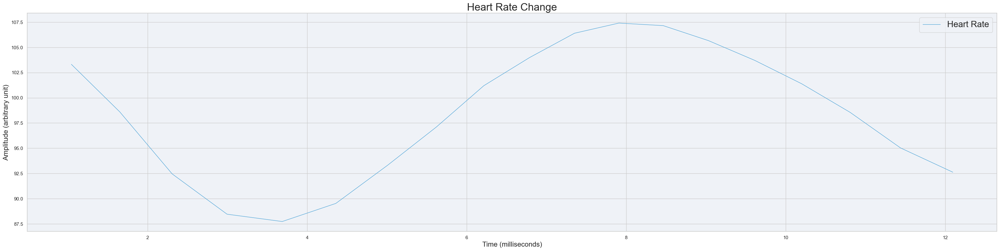

======Next Sampling Window======
start_stop:  (9587, 12837)
times[start], times[stop]:  13.002036958003156 26.00162583300131
(start / 250) - takes_start_time_s[jf_id][0]:  12.983
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
26.00162583300131 -13.00522233399737


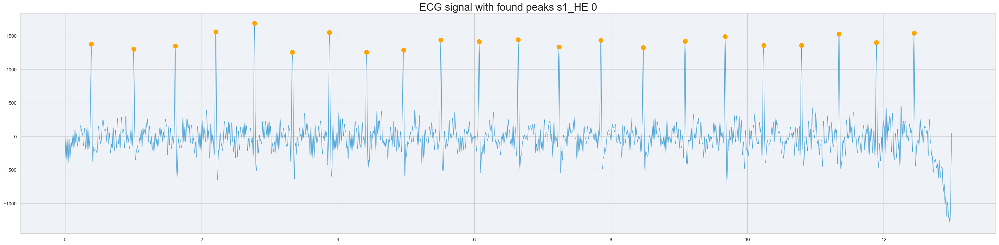

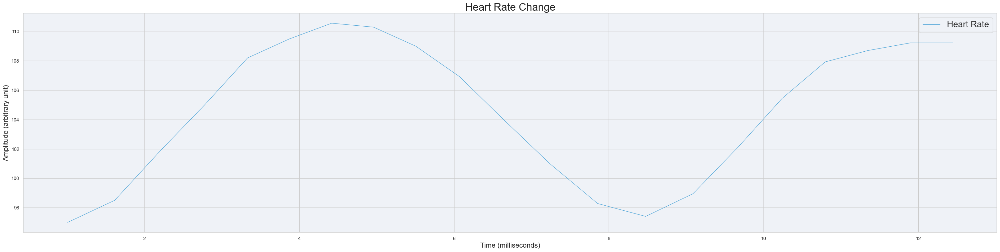

======Next Sampling Window======
start_stop:  (12837, 16087)
times[start], times[stop]:  26.00162583300131 39.000886833002156
(start / 250) - takes_start_time_s[jf_id][0]:  25.983
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
39.000886833002156 -13.00522233399737


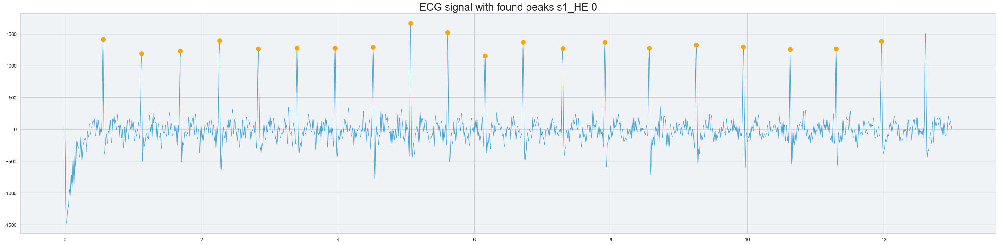

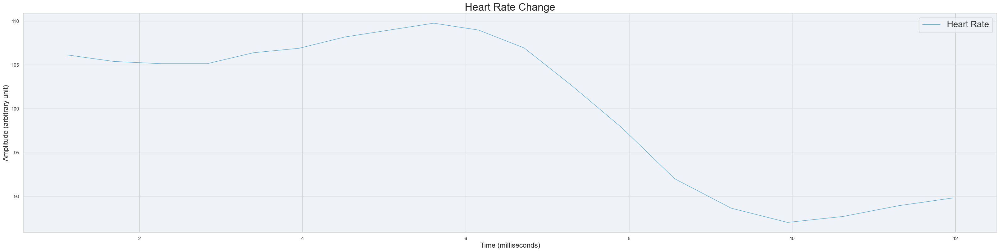

======Next Sampling Window======
start_stop:  (16087, 19337)
times[start], times[stop]:  39.000886833002156 52.00114525000187
(start / 250) - takes_start_time_s[jf_id][0]:  38.983000000000004
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
52.00114525000187 -13.00522233399737


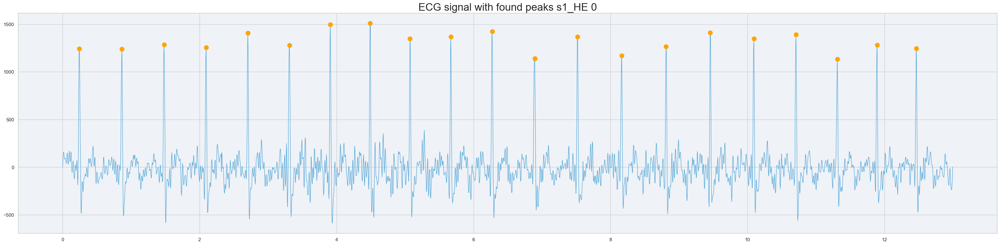

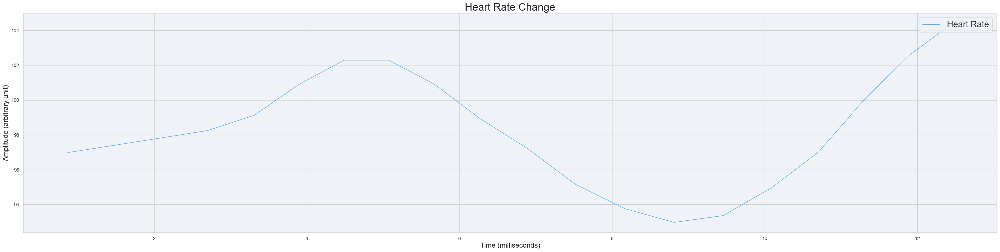

======Next Sampling Window======
start_stop:  (19337, 22587)
times[start], times[stop]:  52.00114525000187 65.00137612500272
(start / 250) - takes_start_time_s[jf_id][0]:  51.983000000000004
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
65.00137612500272 -13.00522233399737


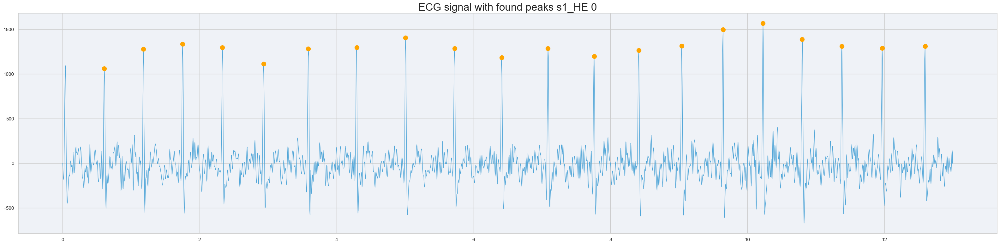

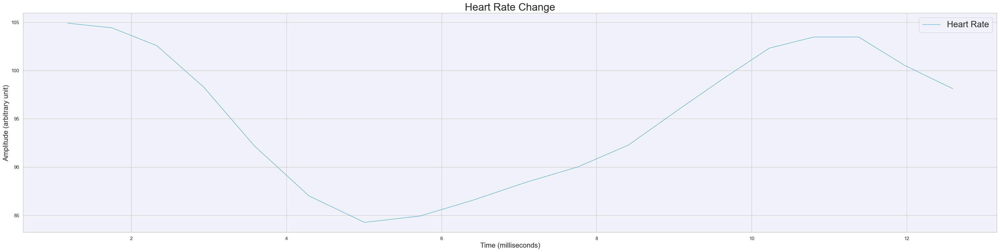

======Next Sampling Window======
start_stop:  (22587, 25837)
times[start], times[stop]:  65.00137612500272 78.0010856250026
(start / 250) - takes_start_time_s[jf_id][0]:  64.983
78 - times[stop]:  -0.0010856250026023417
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
78.0010856250026 -13.00522233399737


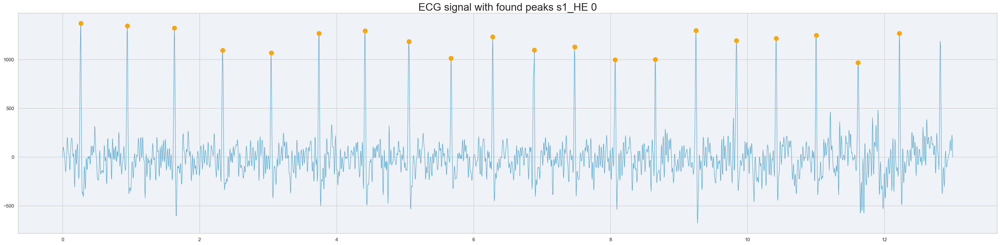

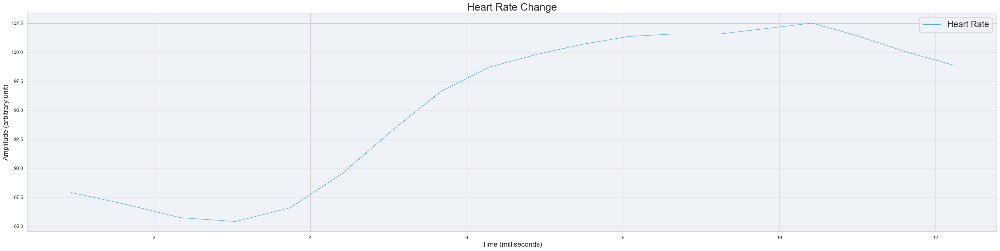

List is not empty
[[], [0.0, 12.2276971091994], [13.005750208998506, 24.26078100764473], [26.007259292000526, 14.609917933727353], [39.00684816699868, 17.239720067733085], [52.00610916699952, 11.538937546718461], [65.00636758399924, 24.12897234495987], [78.00659845900009, 14.464146453404886]]
======Next Take======
ranges 39804 62554
session,  s1_HE
take:  1
processing features for  ECG
======Next Sampling Window======
start_stop:  (39804, 43054)
times[start], times[stop]:  133.86932808300276 146.86938620800152
(start / 250) - takes_start_time_s[jf_id][0]:  133.851
78 - times[stop]:  -68.86938620800152
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
146.86938620800152 133.86932808300276


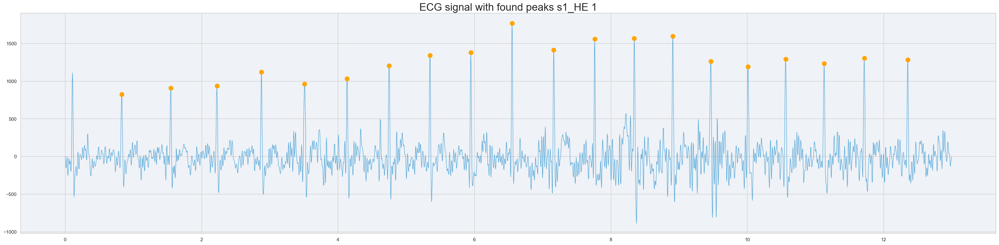

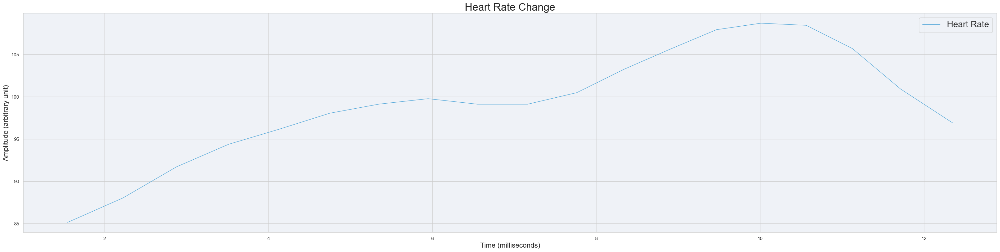

======Next Sampling Window======
start_stop:  (43054, 46304)
times[start], times[stop]:  146.86938620800152 159.86927566600002
(start / 250) - takes_start_time_s[jf_id][0]:  146.851
78 - times[stop]:  -81.86927566600002
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
159.86927566600002 133.86932808300276


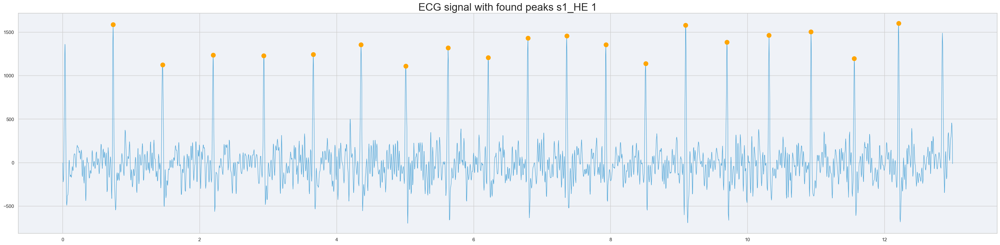

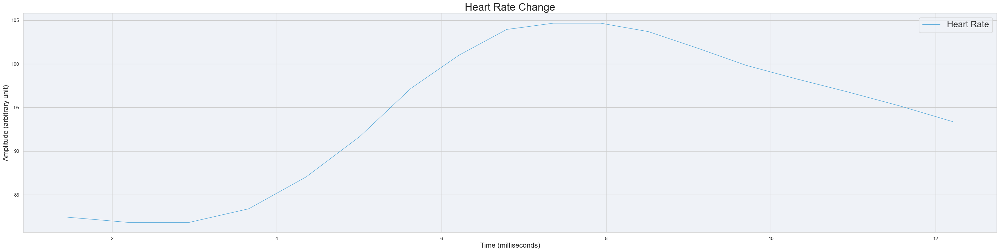

======Next Sampling Window======
start_stop:  (46304, 49554)
times[start], times[stop]:  159.86927566600002 172.86963370800163
(start / 250) - takes_start_time_s[jf_id][0]:  159.851
78 - times[stop]:  -94.86963370800163
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
172.86963370800163 133.86932808300276


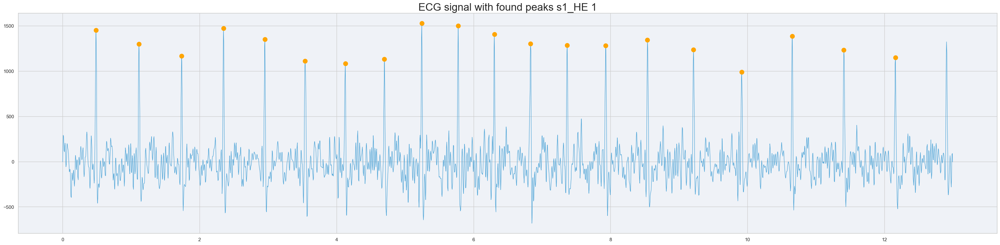

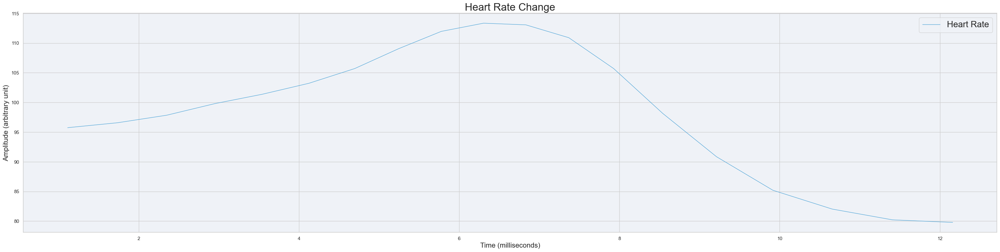

======Next Sampling Window======
start_stop:  (49554, 52804)
times[start], times[stop]:  172.86963370800163 185.870146291001
(start / 250) - takes_start_time_s[jf_id][0]:  172.851
78 - times[stop]:  -107.87014629100099
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
185.870146291001 133.86932808300276


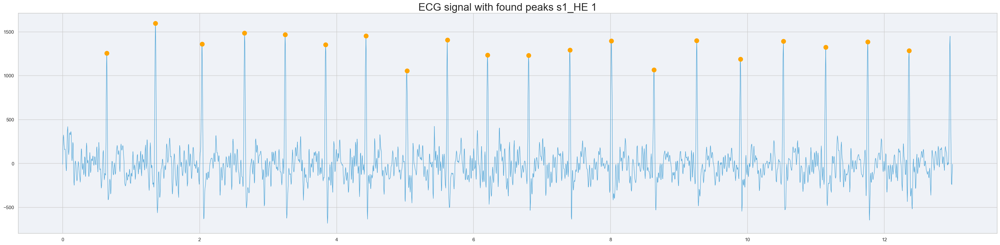

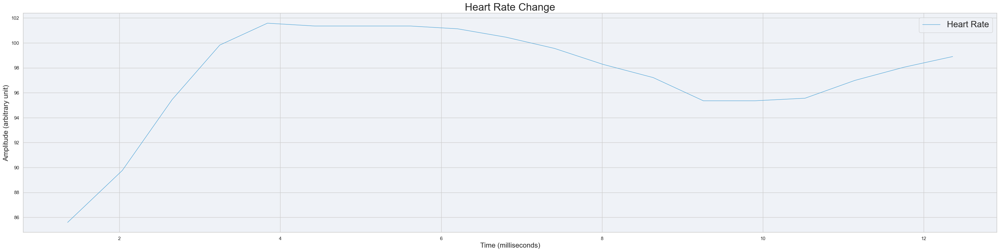

======Next Sampling Window======
start_stop:  (52804, 56054)
times[start], times[stop]:  185.870146291001 198.8695707500026
(start / 250) - takes_start_time_s[jf_id][0]:  185.851
78 - times[stop]:  -120.8695707500026
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
198.8695707500026 133.86932808300276


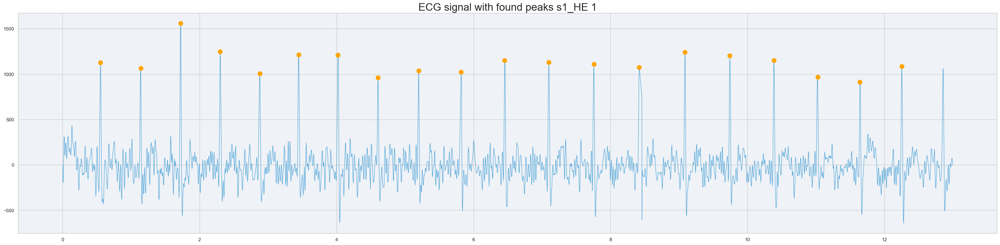

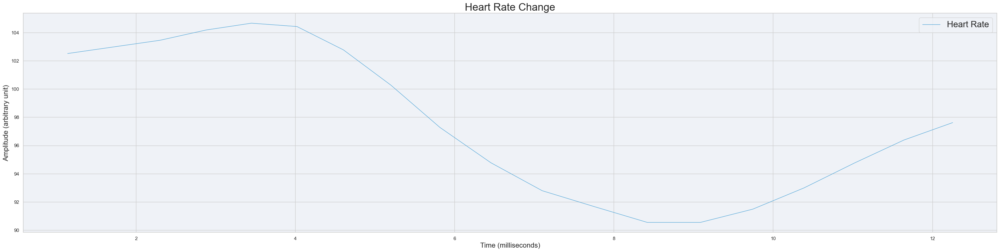

======Next Sampling Window======
start_stop:  (56054, 59304)
times[start], times[stop]:  198.8695707500026 211.86986712500016
(start / 250) - takes_start_time_s[jf_id][0]:  198.851
78 - times[stop]:  -133.86986712500016
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
211.86986712500016 133.86932808300276


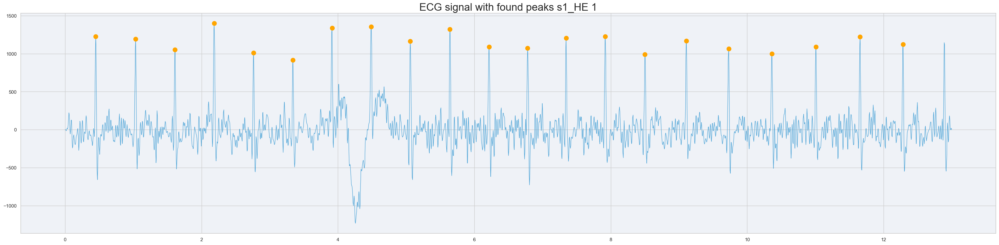

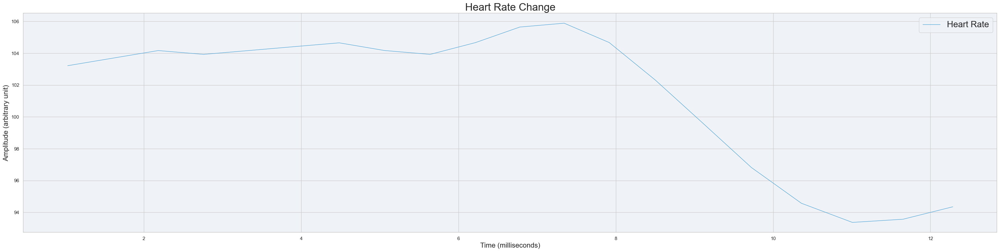

======Next Sampling Window======
start_stop:  (59304, 62554)
times[start], times[stop]:  211.86986712500016 224.87082158300268
(start / 250) - takes_start_time_s[jf_id][0]:  211.851
78 - times[stop]:  -146.87082158300268
Time domain: the rri sequence was detrended.
Signal duration must be greater than 20 seconds to compute frequency-domain features.
Signal duration must be greater than 90 seconds to compute non-linear features.
224.87082158300268 133.86932808300276


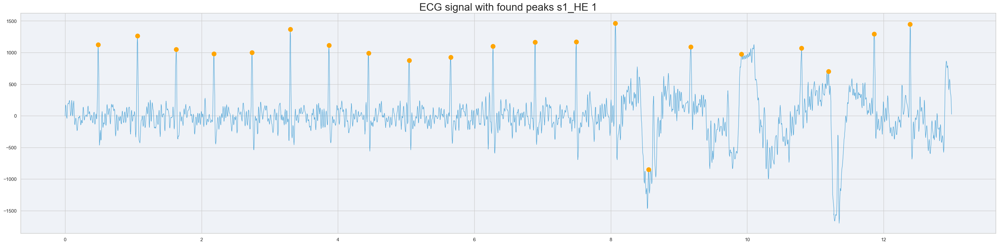

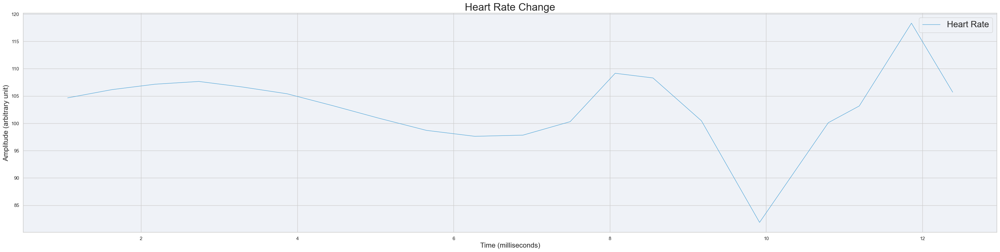

List is not empty
[[], [0.0, 19.951816713974676], [13.000058124998759, 19.907843325958417], [25.999947582997265, 23.60493631479453], [39.00030562499887, 18.945766646373357], [52.000818207998236, 11.877516107500867], [65.00024266699984, 9.335529109786671], [78.0005390419974, 77.64125180573679]]
======Next Take======
ranges 78818 101568
device data length:  (2, 222877)
14310 79307 64997
======Next Take======
ranges 11062 33812
======Next Take======
ranges 72581 95331
======Next Take======
ranges 125328 148078
device data length:  (2, 217463)
9329 74323 64994
======Next Take======
ranges 6077 28827
======Next Take======
ranges 61051 83801
======Next Take======
ranges 115094 137844
======Next Take======
ranges 182558 205308
device data length:  (2, 52306)
15082 55890 40808
======Next Take======
ranges 11833 34583
======Next Take======
ranges 40304 63054
======Next Take======
ranges 46315 69065
device data length:  (2, 240663)
13102 78098 64996
======Next Take======
ranges 9849 32599
======

In [117]:
feature_sample_id = 0
window_size = int(13000 / 4)

# Files
for jf_id, jf in enumerate(filtered_json_files_list[:]):
    times, sensors, duration = get_data_from_json(jf_id, dev_id, channel, False)
    # takes_start_time = np.array(takes_start_time_s[jf_id]) - int(14000/4)
    start_time_index = [np.where(
        # times==min(times, key=lambda x:abs(x-start_time)))[0][0] for start_time in takes_start_time_s[jf_id]]
        times==min(times, key=lambda x:abs(x-start_time)))[0][0] for start_time in takes_start_time_s[jf_id]]
        # end_time_seconds = np.add(start_times, durations).tolist()
    end_time_index = [np.where(
        times==min(times, key=lambda x:abs(x-end_time)))[0][0] for end_time in film_durations[jf_id]]
    last_end_index = 0
    for ranges in get_masked_ranges(start_time_index, end_time_index, len(times)):
        # print(ranges, last_end_index)
        # sensors = zero_until_range(sensors, ranges[0] if ranges[1] != len(times) else len(times), last_end_index)
        last_end_index = ranges[1]
    times = times[:] - takes_start_time_s[jf_id][0]

    # times, sensors, duration = get_data_from_json(jf_id, dev_id, channel, False)
    df = pd.DataFrame({"index": times, "heartrate": sensors})
    df_slice = [pd.DataFrame() for _ in range(len(film_durations[jf_id]))]

    plot_ranges = []
    # Takes
    for take, ranges in enumerate(get_masked_ranges(start_time_index, end_time_index, len(times))[:-1]):
        print("======Next Take======")
        sampfrom, sampto = ranges

        if current_label == "ECG":
            sampfrom = sampfrom - window_size # - 13s
            sampto = sampfrom + (window_size * 7)
            print("ranges", sampfrom, sampto)
            plot_ranges = split_window(sampfrom, sampto, min_size=window_size)

        if current_label == "EDA" or current_label == "ACC":
            window_size = sampto - sampfrom
            plot_ranges = get_plot_ranges(sampfrom, sampto, nr_plots)

        hrv_graph = [[]]
        eda_graph = [[]]

        if current_label == "ECG" and [jf_id, take] not in hrv_pairs:
            continue
        if current_label == "EDA" and [jf_id, take] not in hrv_pairs:
            continue

        print("session, ", identifiers[jf_id])
        print("take: ", take)
        print("processing features for ", current_label)
        # Sampling Windows
        for i, start_stop in enumerate(plot_ranges):
        # for i, start_stop in enumerate(get_plot_ranges(sampfrom, sampto, nr_plots)):
            print("======Next Sampling Window======")
            start, stop = start_stop

            # if (current_label == "ECG"):
            #     start = start - window_size

            print("start_stop: ", start_stop)
            print("times[start], times[stop]: ", times[start], times[stop])
            print("(start / 250) - takes_start_time_s[jf_id][0]: ", (start / 250) - takes_start_time_s[jf_id][0])
            if (78 - times[stop] < 12):
                print("78 - times[stop]: ", 78 - times[stop])

            # get slice data of sensor data
            cond_slice = (df.index >= start) & (df.index < stop)
            if (current_label != "ACC"):
                ecg_slice = df.heartrate[cond_slice]
                x_slice = ecg_slice
            else:
                x_slice = df.heartrate[cond_slice]
                ecg_slice = [[acc[0],acc[1],acc[2]] for acc in df.heartrate[cond_slice]]

            df_slice[take] = pd.DataFrame({"index": x_slice, "sensors": ecg_slice})

            if (len(ecg_slice) > 1125):
                if (current_label == "ECG"):
                    ecg_stats = ecg.ecg(signal=ecg_slice, sampling_rate=1000/4, show=0)
                    t, ecg_slice_filtered, peaks = ecg.ecg(signal=ecg_slice, sampling_rate=1000/4, show=0)[:3]
                    try:
                        hrv_features = hrv.hrv(rpeaks=peaks, sampling_rate=1000/4, outliers="interpolate", show=1, show_individual=False)
                        # print(hrv_features[])
                    except Exception as e:
                        print(f"An error occurred: {e}")
                        pass
                    try:
                        if (hrv_features[10]):
                            print(times[stop], times[sampfrom])
                            hrv_graph.append([times[stop - window_size] - times[sampfrom], hrv_features[10]])
                            # print(hrv_graph)
                        else:
                            continue
                    except Exception as e:
                        print(f"An error occurred: {e}")
                        pass
                    # rri = hrv.rri_correction(rri=hrv_features)
                    # hrv_time_features = hrv.hrv_timedomain(rri=hrv_features, duration=times[stop]-times[start], show=True)
                    # results = td.rmssd(nni=rri)
                if (current_label == "ACC"):
                    ecg_stats = acc.acc(signal=ecg_slice, sampling_rate=1000/10, interactive=0, show=0)
                    # ecg_slice_filtered = ecg_stats[1]
                    df_slice[take]["magnitude"] = ecg_stats[2]
                    df_slice[take]["smoothed"] = df_slice[take]["magnitude"].ewm(alpha=0.25, adjust=False).mean()
                    ecg_slice_filtered = df_slice[take]["smoothed"]

                    n_parts = 2
                    split_signals = np.array_split(ecg_stats[1], n_parts)
                    for i, window in enumerate(split_signals):
                        spectrum_features = acc.frequency_domain_feature_extractor(signal=window, sampling_rate=1000/10)
                        plt.figure(figsize=(3, 3))
                        for axs in ["x", "y", "z"]:
                            plt.plot(spectrum_features[0][axs], spectrum_features[1][axs])
                        plt.xlim(0.0, 1.0)
                        plt.show()
                if (current_label == "EDA"):
                    try:
                        ecg_stats = eda.eda(signal=ecg_slice, sampling_rate=1000/10, show=0)
                        ecg_slice_filtered = ecg_stats[1]
                        # Extracted features (SCR, SCL, etc.)
                        peaks = ecg_stats[5]
                        onsets = ecg_stats['onsets']
                        edl = ecg_stats['edl']  # Skin conductance level
                        edr = ecg_stats['edr']  # Skin conductance response
                        ecg_slice_filtered = ecg_stats['filtered']  # The filtered EDA signal

                        eda_graph = [times[onsets] + takes_start_time_s[jf_id][0], times[peaks] + takes_start_time_s[jf_id][0]]
                        # print(eda_graph)
                    except Exception as e:
                        eda_graph = [[], []]
                        print(f"An error occurred: {e}")
            else:
                break

            if (show_raw):
                plt.figure(figsize=(40, 20))
                plt.subplot(211)
                plt.title(f"{current_label} signal with found peaks {identifiers[jf_id]} {take}" if current_label != "ACC" else f"{current_label} signal", fontsize=24)

            if (current_label != "ACC" and show_raw):
                plt.plot(times[ecg_slice.index] - times[x_slice.index][0], ecg_slice_filtered, label=current_label, color="#51A6D8", linewidth=1)
                plt.plot(times[peaks+start] - times[x_slice.index][0], ecg_slice_filtered[peaks], markersize=10, label="R-peak", color="orange", marker="o", linestyle="None")
        #    triaxial data
            if (current_label == "ACC"):
                # plt.plot(times[x_slice.index], ecg_slice_filtered, label=current_label, color="#51A6D8", linewidth=3)
                # plt.plot(times[x_slice.index], (1*df_slice["second_order_diff"]) + 1, label=current_label, color="orange", linewidth=3)
                sns.lineplot(x=times[x_slice.index], y=ecg_slice_filtered,estimator=np.mean, errorbar='sd')
                plt.ylim(0.9, 1.1)
                # plt.annotate('This point is interesting!', xy=(0, 1), xytext=(0, 1), arrowprops=dict(facecolor='black', shrink=0.05))

            if (current_label == "ECG" and show_raw):
                plt.figure(figsize=(40, 20))
                plt.subplot(212)
                plt.title("Heart Rate Change", fontsize=24)
                plt.plot(ecg_stats[5], ecg_stats[6], label="Heart Rate", color="#51A6D8", linewidth=1)

            if (show_raw):
                plt.legend(loc="upper right", fontsize=20)
                plt.xlabel("Time (milliseconds)", fontsize=16)
                plt.ylabel("Amplitude (arbitrary unit)", fontsize=16)
                plt.show()


        if (current_label == "ECG"):
            print("List is not empty" if len(hrv_graph[1])>0 else "List is empty")
            print(hrv_graph)
            if len(hrv_graph[1])>0:
                df_features[feature_sample_id] = pd.DataFrame(hrv_graph, columns=['x', 'y'])
            else:
                print("nothing here")
                result_df = pd.DataFrame({"x": np.linspace(0, 78, num=(78//13) + 1, dtype=int), "y": 0})
                df_features[feature_sample_id] = pd.DataFrame(result_df, columns=['x', 'y'])
            feature_sample_id += 1

        if (current_label == "EDA"):
            eda_window_split = int(13)
            arr_np = np.array(eda_graph[1], dtype=float)
            print(eda_graph[1])
            print("List is not empty" if len(eda_graph[1])>0 else "List is empty")
            if len(eda_graph[1])>0:
                peak_index_list = np.array(sorted(eda_graph[1]), dtype=int)
                bins = np.arange(0, peak_index_list.max() + 13, 13)
                bin_labels = bins[:-1]  # Use bin start values as labels
                counts, _ = np.histogram(peak_index_list, bins)
                result_df = pd.DataFrame({"x": bin_labels, "y": counts})
                df_features[feature_sample_id] = pd.DataFrame(result_df, columns=['x', 'y'])
                print(df_features[feature_sample_id])
            else:
                print("no peaks here")
                result_df = pd.DataFrame({"x": np.linspace(0, 78, num=(78//13) + 1, dtype=int), "y": 0})
                df_features[feature_sample_id] = pd.DataFrame(result_df, columns=['x', 'y'])
                print(df_features[feature_sample_id])
            feature_sample_id += 1

if (current_label == "ECG"):
    df_features[3]["y"].iloc[-1] = df_features[3]["y"].iloc[-1] - 54.0

[[        nan 10.97788103  4.5454748   6.05971754 12.54047253  8.08768363
  10.62383424 10.92426105]
 [        nan 17.94610166  6.66886154  8.47183479 15.9236316  14.8814571
   6.25684317  9.06293313]
 [        nan 12.22769711 24.26078101 14.60991793 17.23972007 11.53893755
  24.12897234 14.46414645]
 [        nan 19.95181671 19.90784333 23.60493631 18.94576665 11.87751611
   9.33552911 23.64125181]]
[[        nan 10.97788103  4.5454748   6.05971754 12.54047253  8.08768363
  10.62383424 10.92426105]
 [        nan 17.94610166  6.66886154  8.47183479 15.9236316  14.8814571
   6.25684317  9.06293313]
 [        nan 12.22769711 24.26078101 14.60991793 17.23972007 11.53893755
  24.12897234 14.46414645]
 [        nan 19.95181671 19.90784333 23.60493631 18.94576665 11.87751611
   9.33552911 23.64125181]
 [        nan 11.15686634  4.38722898  6.85604216 12.20512011  7.87363921
  10.51806816 10.76235986]
 [        nan 17.50158525  6.12327168 10.27768102 15.12130827 14.1805982
   6.89119104  9.11

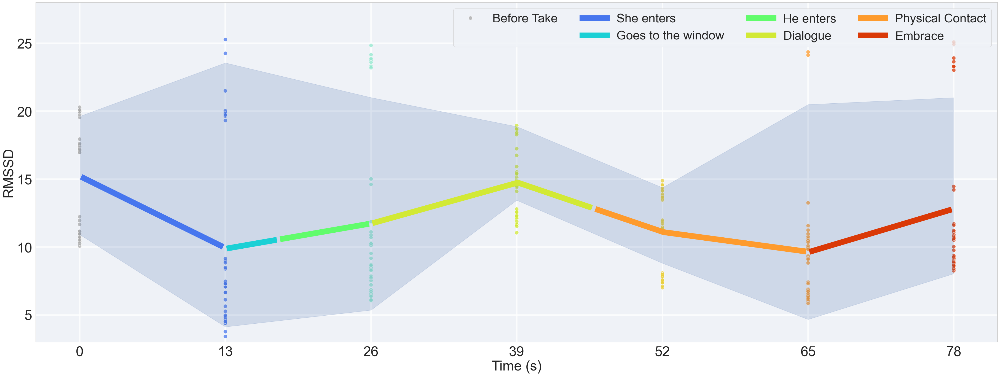

In [129]:
# def create_augmented_list(df_list, x_col, y_col, n=4):
#     augmented_list = df_list.copy()  # Keep the original list intact
#     for _ in range(n):
#         new_df = df_list[0].copy()  # Copy the first DataFrame in the list
#         print(new_df)
#         new_df[y_col] += abs(np.random.normal(loc=0, scale=2.5, size=len(new_df)))  # Slightly perturbed y-values
#         augmented_list.append(new_df)
#     return augmented_list

def create_augmented_list(df_list, x_col, y_col, n=2, noise_level=0.2, skip=None):
    augmented_list = df_list.copy()
    # np.random.seed(41)  # For reproducibility
    np.random.seed(41)  # For reproducibility
    # Stack y values to compute pointwise std
    y_matrix = np.stack([df[y_col].values for df in df_list])
    pointwise_std = np.nanstd(y_matrix, axis=0)
    print(y_matrix)

    if skip is not None:
        valid_indices = [i for i in range(len(df_list)) if i != skip]

    for _ in range(n):
        base_df = df_list[np.random.randint(len(df_list))].copy()
        if skip is not None:
            base_df = df_list[np.random.choice(valid_indices)].copy()
        original_y = base_df[y_col].values
        noise = np.random.normal(loc=0, scale=noise_level * pointwise_std)

        augmented_y = original_y + abs(noise)

        # Mean correction (skip NaNs)
        orig_mean = np.nanmean(original_y)
        aug_mean = np.nanmean(augmented_y)
        delta = orig_mean - aug_mean
        augmented_y = augmented_y + delta

        base_df[y_col] = augmented_y
        augmented_list.append(base_df)

    return augmented_list

def oversample_lines(df, x_col, y_col, oversample_factor=10):
    # df = df.dropna(subset=[group_col])
    # Oversample data
    oversampled_x = []
    oversampled_y = []
    # oversampled_group = []
    for i in range(len(df) - 1):
        x_vals = np.linspace(df[x_col].iloc[i], df[x_col].iloc[i + 1], oversample_factor)
        y_vals = np.linspace(df[y_col].iloc[i], df[y_col].iloc[i + 1], oversample_factor)
        oversampled_x.extend(x_vals)
        oversampled_y.extend(y_vals)
    return pd.DataFrame({x_col: oversampled_x, y_col: oversampled_y})

plt_font_size = 36
custom_palette = ['#4776ee', '#1bd0d5', '#61fc6c', '#d2e935', '#fe9b2d', '#da3907']
custom_palette_scatter = ["#AAAAAA", '#4776ee', '#91E7CE', '#d2e935', '#E9CF3A', '#fe9b2d', '#da3907']
phase_labels = [
    "She enters","Goes to the window","He enters","Dialogue","Physical Contact","Embrace","End"
]
phase_labels = ["She enters","Goes to the window","He enters","Dialogue","Physical Contact","Embrace","End"]

phase_timestamps = [0, 13, 18, 26, 46, 65, 78]
phase_timestamps_os = [0, 13, 18, 26, 46, 65, 78]

if (current_label == "ECG"):
    df_features_augmented = []
    # df_features_augmented = create_augmented_list(df_features[:4], x_col='x', y_col='y', n=2)
    df_features_augmented = create_augmented_list(df_features[:4], x_col='x', y_col='y', n=2, noise_level=0.2,skip=None)
    df_features_augmented = create_augmented_list(df_features_augmented[:6], x_col='x', y_col='y', n=30, noise_level=0.20, skip=None)

plt.figure(figsize=(45, 16))

df_indv_plot = []
df_features_plot = []
df_features_plot_oversampled = []

min_length = min(len(df) for df in df_features)
# print(len(df_features))
min_final_row_x = phase_timestamps[-1]

scatter_size = 100

if (current_label == "EDA"):
    for i, df in enumerate(df_features[:]):
        print(df)
        df_features_plot.append(df.iloc[:])
        # df_features_plot[i]['x'] = df_features_plot[i]['x'].fillna(0)
        # df_features_plot[i]['y'] = df_features_plot[i]['y'].fillna(0)
        # df_features_plot[i]['x'] = np.round(df_features_plot[i]['x']).astype(int)
        # df_features_plot[i] = df_features_plot[i].iloc[:7]
        remaining_x_values = [x for x in np.linspace(0, phase_timestamps[-1], num=(phase_timestamps[-1]//13) + 1, dtype=int) if x not in df_features_plot[i]['x'].tolist()]
        # new_x_values = remaining_x_values[:]
        padding = pd.DataFrame({'x': remaining_x_values, 'y': [0] * len(remaining_x_values)})
        padded_df = pd.concat([df_features_plot[i], padding], ignore_index=True).astype(int)
        df_features_plot[i] = padded_df.iloc[:7].sort_values(by="x").reset_index(drop=True)

        df_features_plot[i]["Group"] = phase_labels[:]
        print(df_features_plot[i])

        df_features_plot_oversampled.append(oversample_lines(df_features_plot[i], x_col='x', y_col='y', oversample_factor=50))
        sns.scatterplot(data=df_features_plot[i], x="x", y="y", s=150, alpha=0.75, hue="Group", palette="turbo", legend=False)

    for i, df in enumerate(df_features_augmented[4:]):
        df_indv_plot.append(df.iloc[:])
        n = i + 4
        df_indv_plot[i]['x'] = df_indv_plot[i]['x'].fillna(0)
        df_indv_plot[i]['y'] = df_indv_plot[i]['y'].fillna(0)
        df_indv_plot[i]['x'] = np.round(df_indv_plot[i]['x']).astype(int)
        df_indv_plot[i] = df_indv_plot[i].iloc[1:min_length]

        df_indv_plot[i].at[df_indv_plot[i].index[-1], 'x'] = int(phase_timestamps[-1])
        df_indv_plot[i]["Group"] = phase_labels[-1]

        sns.scatterplot(data=df_indv_plot[i], x="x", y="y", s=150, alpha=0.75, hue="Group", palette="turbo", legend=False)

    df_features_combined = pd.concat(df_features_plot, ignore_index=True)
    oversampled_dfs = pd.concat(df_features_plot_oversampled)
    # color_labels = pd.cut(oversampled_dfs["x"], bins=phase_timestamps, labels=phase_labels)
    # oversampled_dfs["Group"] = color_labels
    mean_values = oversampled_dfs.groupby('x')['y'].mean()
    mean_values_df = mean_values.reset_index()
    color_labels = pd.cut(mean_values_df["x"], bins=phase_timestamps_os, labels=phase_labels[:-1])
    mean_values_df["Group"] = color_labels

    sns.lineplot(data=df_features_combined, x="x", y="y", linewidth=4, alpha=0, ci="sd", estimator=np.mean)
    sns.lineplot(data=mean_values_df, x='x', y='y', hue='Group', linewidth=4, alpha=1, palette="turbo")

    df_features_combined.to_csv("EDA_SHE.csv", index=False)
    mean_values_df.to_csv("EDA_SHE_mean.csv", index=False)

    std_values = oversampled_dfs.groupby('x')['y'].std()
    std_values_df = mean_values.reset_index()
    color_labels = pd.cut(std_values_df["x"], bins=phase_timestamps_os, labels=phase_labels[:-1])
    std_values_df["Group"] = color_labels
    std_values_df.to_csv("EDA_SHE_std.csv", index=False)

    plt.xticks(df_features_plot[0]['x'], fontsize=plt_font_size)
    # plt.yticks(fontsize=plt_font_size)
    plt.xlabel("Time (seconds)", fontsize=plt_font_size)
    plt.ylabel("Total Phasic EDA Peaks", fontsize=plt_font_size)
    plt.ylim(-0.5, 5)

    # plt.legend(loc="upper right", fontsize=plt_font_size-4)
    # plt.grid(linestyle="-", linewidth=4, alpha=0.8, color="white")
    # figure_file_path = "../Output/Sensor_Figures/EDA_AVG_HE"
    # plt.savefig(figure_file_path + ".png", dpi=300)
    # plt.savefig(figure_file_path + ".svg", dpi=300)
    # plt.show()

if (current_label == "ECG"):
    for i, df in enumerate(df_features_augmented[:4]):
        # print(df["Group"])
        df_features_plot.append(df.iloc[:])
        df_features_plot[i]['x'] = df_features_plot[i]['x'].fillna(0)
        df_features_plot[i]['y'] = df_features_plot[i]['y'].fillna(0)
        df_features_plot[i]['x'] = np.round(df_features_plot[i]['x']).astype(int)
        df_features_plot[i] = df_features_plot[i].iloc[1:min_length]

        df_features_plot[i].at[df_features_plot[i].index[-1], 'x'] = int(phase_timestamps[-1])
        df_features_plot[i]["Group"] = phase_labels

        df_features_plot_scatter = df_features_plot[i].copy()
        df_features_plot_scatter['z_y'] = zscore(df_features_plot_scatter['y'])
        # mean_y = df_features_plot_scatter[df_features_plot_scatter['z_y'].abs() <= 2.0]['y'].mean()
        # df_features_plot_scatter = df_features_plot_scatter[df_features_plot_scatter['z_y'].abs() <= 2.0]  # or <= 2.5 if you prefer
        # df_features_plot_scatter.loc[df_features_plot_scatter['z_y'].abs() > 2.0, 'y'] = mean_y
        # df_features_plot_scatter = df_features_plot_scatter.drop(columns='z_y')
        inliers = df_features_plot_scatter[df_features_plot_scatter['z_y'].abs() <= 2.0]
        df_features_plot_scatter.loc[df_features_plot_scatter['z_y'] > 2.0, 'y'] = inliers['y'].max()
        df_features_plot_scatter.loc[df_features_plot_scatter['z_y'] < -2.0, 'y'] = inliers['y'].min()
        df_features_plot_scatter.drop(columns='z_y', inplace=True)
        # print(df_features_plot[i])
        df_features_plot_oversampled.append(oversample_lines(df_features_plot_scatter, x_col='x', y_col='y', oversample_factor=50))
        if i == 0:
            sns.scatterplot(data=df_features_plot_scatter[df_features_plot_scatter["Group"] == "She enters"].assign(CustomLabel="Before Take").iloc[[0]], x="x", y="y", hue="CustomLabel", palette={"Before Take": custom_palette_scatter[0]}, s=scatter_size, alpha=0.75, legend=True)
        sns.scatterplot(data=df_features_plot_scatter, x="x", y="y", s=scatter_size, alpha=0.75, hue="Group", palette=custom_palette_scatter, legend=False)
        df_features_plot[i] = df_features_plot_scatter

    for i, df in enumerate(df_features_augmented[4:]):
        print("augmented", i)
        df_indv_plot.append(df.iloc[:])
        n = i + 4
        print("n", n)
        df_indv_plot[i]['x'] = df_indv_plot[i]['x'].fillna(0)
        df_indv_plot[i]['y'] = df_indv_plot[i]['y'].fillna(0)
        df_indv_plot[i]['x'] = np.round(df_indv_plot[i]['x']).astype(int)
        df_indv_plot[i] = df_indv_plot[i].iloc[1:min_length]

        df_indv_plot[i].at[df_indv_plot[i].index[-1], 'x'] = int(phase_timestamps[-1])
        df_indv_plot[i]["Group"] = phase_labels

        sns.scatterplot(data=df_indv_plot[i], x="x", y="y", s=scatter_size, alpha=0.75, hue="Group", palette=custom_palette_scatter, legend=False)

        df_features_plot_oversampled.append(oversample_lines(df_indv_plot[i], x_col='x', y_col='y', oversample_factor=50))
        df_features_plot.append(df_indv_plot[i])

    df_features_combined = pd.concat(df_features_plot[:4], ignore_index=True)
    oversampled_dfs = pd.concat(df_features_plot_oversampled[:])

    color_labels = pd.cut(oversampled_dfs["x"], bins=phase_timestamps, labels=phase_labels[:-1])
    oversampled_dfs["Group"] = color_labels
    mean_values = oversampled_dfs.groupby('x')['y'].mean()
    mean_values_df = mean_values.reset_index()
    color_labels = pd.cut(mean_values_df["x"], bins=phase_timestamps, labels=phase_labels[:-1])
    mean_values_df["Group"] = color_labels
    print(df_features_combined)

    sns.lineplot(data=df_features_combined, x="x", y="y", linewidth=0, ci="sd", estimator=np.mean)
    sns.lineplot(data=mean_values_df, x='x', y='y', hue='Group', linewidth=15, alpha=1, palette=custom_palette)

    for line in plt.gca().lines[:-1]:
        x_data = line.get_xdata()  # Get the current x-values of the line
        y_data = line.get_ydata()  # Get the corresponding y-values
        if isinstance(x_data, np.ndarray):
            num_trim = -2
            x_data_trimmed = x_data[:num_trim]
            y_data_trimmed = y_data[:num_trim]  # Trim y-values to match x-values
            x_data_trimmed = x_data_trimmed + 0.1
            line.set_xdata(x_data_trimmed)
            line.set_ydata(y_data_trimmed)

    for line in plt.gca().lines:
        line.set_solid_capstyle('projecting')  # options: 'butt', 'round', 'projecting'

    x_tick_labels = np.arange(0, 78 + 13, 13)
    plt.xticks(x_tick_labels,
           labels=[str(int(tick)) if tick % 13 == 0 else '' for tick in x_tick_labels],
           fontsize=plt_font_size)
    plt.yticks(ticks=[5.0, 10.0, 15.0, 20.0, 25.0], fontsize=plt_font_size)
    plt.ylim(3,28)
    plt.xlabel("Time (s)", fontsize=plt_font_size)
    plt.ylabel("RMSSD", fontsize=plt_font_size)

    handles, labels = plt.gca().get_legend_handles_labels()
    # reordered_handles = [handles[0], handles[1], handles[5], handles[2], handles[6], handles[3], handles[5]]
    # reordered_labels = [labels[0], labels[1], labels[5], labels[2], labels[6], labels[3], labels[5]]
    handles.insert(1, mlines.Line2D([], [], color='red', marker='o', linestyle='None', alpha=0, markersize=0))
    labels.insert(1, '')

    plt.legend(handles=handles, labels=labels, loc="upper right", fontsize=plt_font_size-4, ncols=4)
    plt.grid(linestyle="-", linewidth=4, alpha=0.8, color="white")
    plt.savefig("../Output/ECG_AVG.svg", dpi=150, bbox_inches='tight')
    # plt.savefig("../Output/ECG_AVG.png", dpi=300)
    plt.show()

 |    ### RR intervals: difference between successive peaks

### Plot ECG vs RR intervals

In [674]:
mean_values_df = mean_values.reset_index()

bins = [0,10,15,25,30,45,60]  # Define split points along X-axis
color_labels = pd.cut(mean_values_df["x"], bins=bins, labels=phase_labels)

mean_values_df["Group"] = color_labels

# s1_SHE_T1
# pde_selected_takes = [
#     "s1_SHE",
#     "s3_HE",
#     "s4_SHE",
#     "s2_SHE",
#     "s1_SHE",
#     "s2_SHE",
#     "s2_SHE",
#     "s6_SHE",
#     "s1_SHE",
#     "s5_SHE",
#     "s3_HE",
#     "s4_SHE",
#     "s2_SHE",
#     "s6_SHE",
# ]

pde_timestamps = [
    21.75,
    789.58,
    353.75,
    708.00,
    70.75,
    733.67,
    757.67,
    566.67,
    44.75,
    476.75,
    826.58,
    368.75,
    727.67,
    519.77,
]

# pde_selected_takes = [
#     [[1, 1], [3, 3], [4, 5], [2, 7],
#      [1, 1], [2, 7], [2, 7], [6, 6],
#      [1, 1], [5, 3], [3, 3], [4, 6],
#      [2, 7], [6, 6]]
# ]

pde_selected_takes = [
    [[1, 0, 1], [6, 1, 3], [8, 1, 3],
     [4, 1, 4], [1, 0, 1], [4, 1, 4],
     [4, 1, 4], [12, 1, 3], [1, 0, 1],
     [9, 0, 3], [6, 1, 3], [8, 1, 3],
     [4, 1, 4], [12, 1, 3]]
]

pde_figure_names=[
    "1.1_1_1_SHE",
    "2.1_3_4_HE",
    "2.2_4_5_SHE",
    "2.3_2_7_SHE",
    "3.1_1_1",
    "4.1_2_7",
    "4.2_2_7",
    "4.3_6_6",
    "4.4_1_1",
    "4.5_5_3",
    "4.6_3_4",
    "4.7_4_6",
    "4.8_2_7",
    "4.9_6_6"
]

pde_selected_takes_timestamps = list(zip(pde_selected_takes[0], pde_timestamps, pde_figure_names))

print(pde_selected_takes_timestamps)


[([1, 0, 1], 21.75, '1.1_1_1_SHE'), ([6, 1, 3], 789.58, '2.1_3_4_HE'), ([8, 1, 3], 353.75, '2.2_4_5_SHE'), ([4, 1, 4], 708.0, '2.3_2_7_SHE'), ([1, 0, 1], 70.75, '3.1_1_1'), ([4, 1, 4], 733.67, '4.1_2_7'), ([4, 1, 4], 757.67, '4.2_2_7'), ([12, 1, 3], 566.67, '4.3_6_6'), ([1, 0, 1], 44.75, '4.4_1_1'), ([9, 0, 3], 476.75, '4.5_5_3'), ([6, 1, 3], 826.58, '4.6_3_4'), ([8, 1, 3], 368.75, '4.7_4_6'), ([4, 1, 4], 727.67, '4.8_2_7'), ([12, 1, 3], 519.77, '4.9_6_6')]


### Plot ECG vs RR intervals

0 s1_SHE
device data length:  (2, 101678)
8803 73791 64988
8804 0
52087 27282
81562 73231
101678 99947
DEBUG:  [0.0012727910008081267 173.14184070799922 340.0911513750008]
DEBUG 1
DEBUG 1
DEBUG ['1.1_1_1_SHE', '3.1_1_1', '4.4_1_1']
0.0012727910008081267
DEBUG [21.74872721 70.74872721 44.74872721]
[ 118  245  371  495  619  742  864  983 1102 1221 1339 1457 1575 1694
 1813 1933 2055 2177 2299 2422 2545 2668 2790 2914 3037 3160 3282 3406
 3529 3653 3777 3903 4030 4157 4288 4419 4551 4682 4814 4944 5073 5199
 5323 5446 5567 5687 5806 5925 6043 6161 6280 6399 6516 6634 6752 6869
 6986 7103 7218 7333 7447 7560 7674 7786 7900 8013 8129 8246 8368 8499
 8639 8782 8925 9065]
38.95595083399894
[ 107  248  387  522  656  787  918 1049 1178 1305 1431 1554 1678 1803
 1927 2053 2177 2301 2429 2555 2682 2809 2938 3069 3202 3338 3471 3601
 3731 3858 3986 4115 4243 4370 4496 4621 4747 4873 5000 5128 5256 5385
 5516 5651 5795 5940 6083 6223 6361 6497 6630 6764 6895 7026 7158 7289
 7421 7553 7685 7816 79

<Figure size 4000x1000 with 0 Axes>

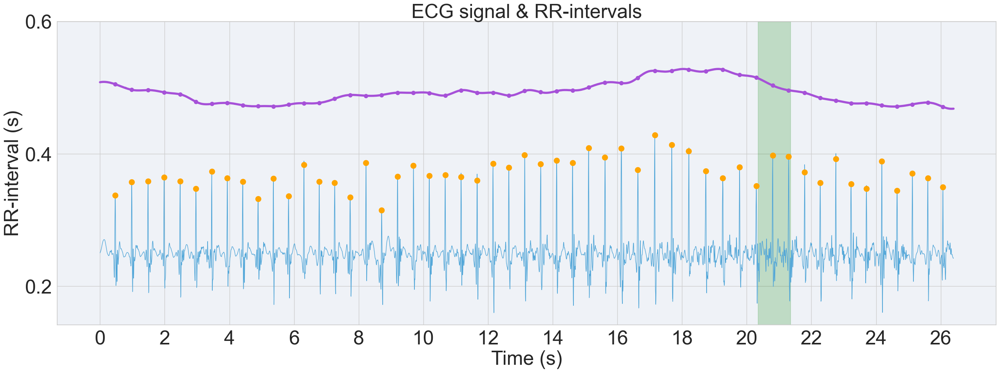

<Figure size 4000x1000 with 0 Axes>

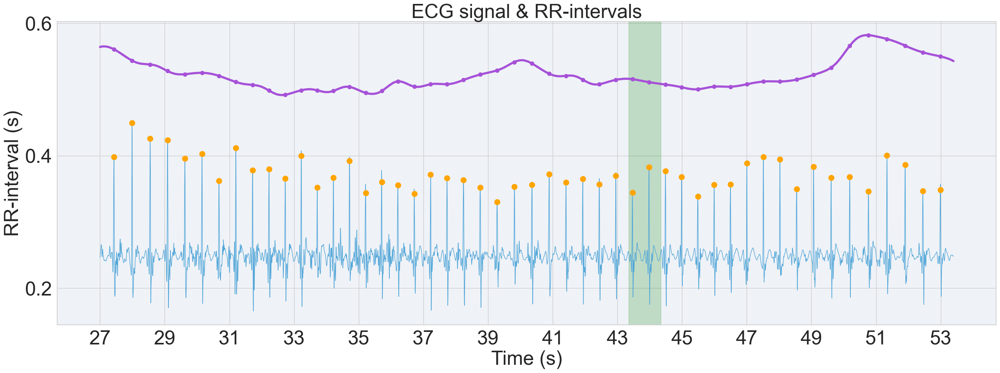

<Figure size 4000x1000 with 0 Axes>

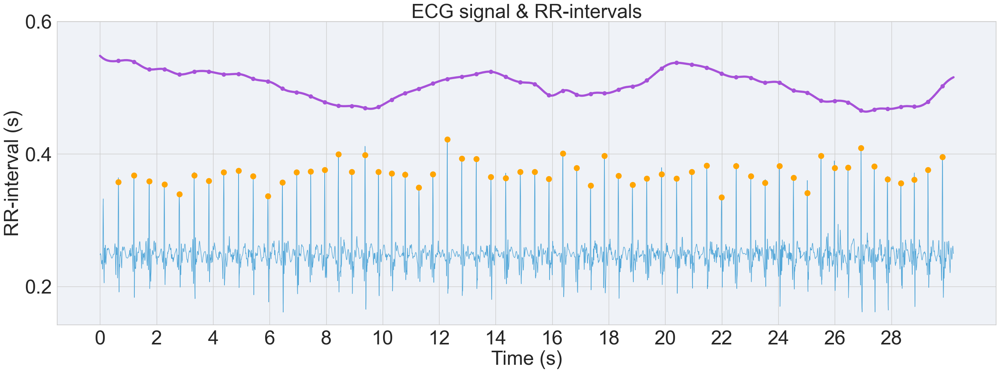

<Figure size 4000x1000 with 0 Axes>

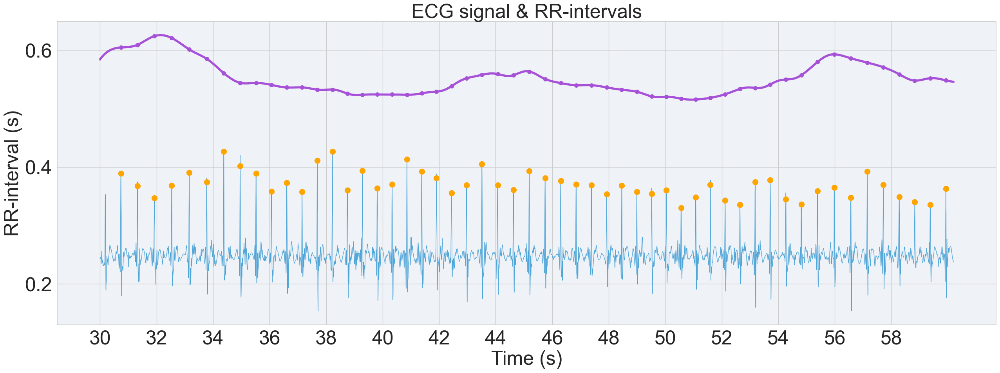

<Figure size 4000x1000 with 0 Axes>

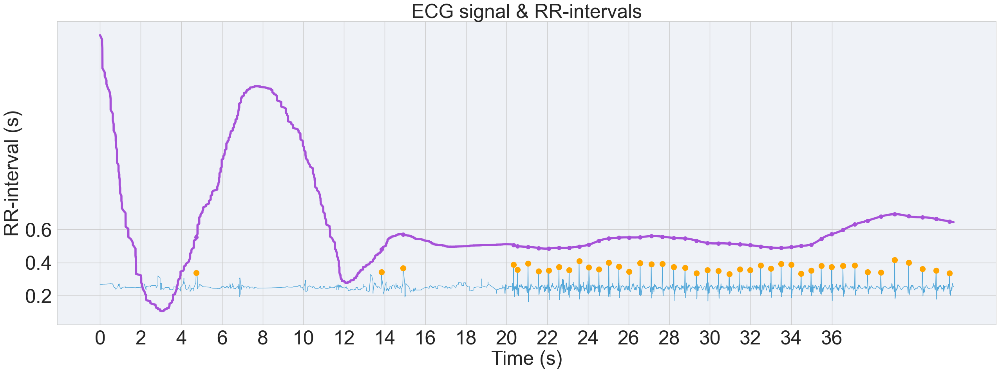

<Figure size 4000x1000 with 0 Axes>

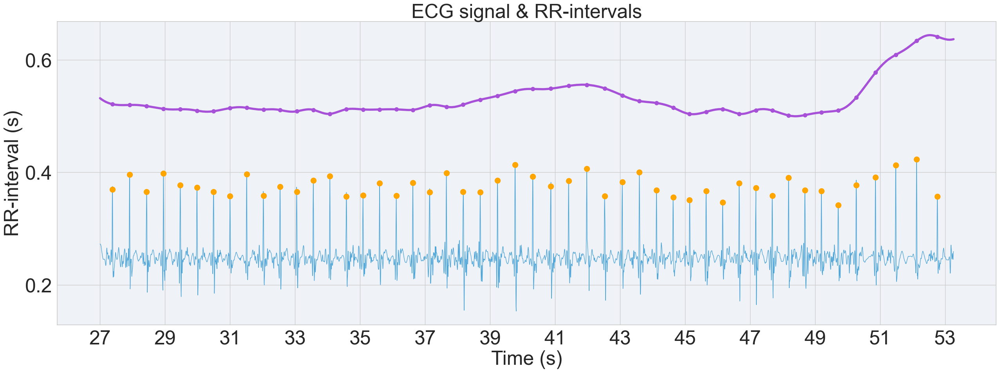

In [703]:
DoP_ID = 0

#additioinal filtering
wavelet = 'db6'  # Daubechies 6 is commonly used for ECG
level = 5  # Decomposition level
threshold_scale = 5.0  # 🔨 Massive threshold

def render_sensor_graph(df, times, start_time_index, end_time_index, interval=250):
    # sampfrom = 0
    # sampto = len(times) - 1
    # sampto = 11918
    nr_plots = 2
    trim_division = 1.4
    trim_index_start = 0
    # nr_plots = 6
    # Batch size for animation
    batch_size = 10

    def update_batch(batch_index):
        start = batch_index * batch_size
        end = start + batch_size
        sys.stdout.write("\r \r Progress: {0}%".format(str((start / num_frames)*100)))
        sys.stdout.flush()
        if (channel != 0):
            # update the line plot
            ecg_line.set_xdata(ecg_x[:end])
            ecg_line.set_ydata(ecg_slice_filtered[:end])
            if len(peaks) > 0:
                # anim_ecg_peaks = ecg_x[peaks[peaks < ecg_x_index[start]]]
                anim_ecg_peaks = np.where(peaks < ecg_x_index[start])
                ecg_peaks.set_xdata(ecg_peaks_x[anim_ecg_peaks])
                ecg_peaks.set_ydata(ecg_slice_filtered[peaks[anim_ecg_peaks]])

            # rr_line.set_xdata(ecg_x[:end])
            # rr_line.set_ydata(rr_y_interp[:end])
            # anim_rr_peaks = np.where(peaks[:-1] < ecg_x[start])
            # rr_peaks.set_xdata(rr_x[anim_rr_peaks])
            # rr_peaks.set_ydata(rr_ms[anim_rr_peaks])
        else:
            for i, line in enumerate(acc_slice_filtered):
                ecg_line[i].set_xdata(ecg_x[:end])
                ecg_line[i].set_ydata(line[:end])

        return (ecg_line)

    df_slice = [pd.DataFrame() for _ in range(len(film_durations[jf_id]))]
    masked_ranges = get_masked_ranges(start_time_index, end_time_index, len(times))[:-1]
    masked_from, _ = zip(*masked_ranges)
    masked_from_t = times[list(masked_from)]
    print("DEBUG: ", times[list(masked_from)])
    for take, ranges in enumerate(masked_ranges):
        # start, stop = ranges
        sampfrom, sampto = ranges
        pde_take_timestamps = [x[1] for i, x in enumerate(pde_selected_takes_timestamps) if x[0][0] == DoP_ID+1 and x[0][2] == take+1]
        pde_figure_id = [x[2] for i, x in enumerate(pde_selected_takes_timestamps) if x[0][0] == DoP_ID+1 and x[0][2] == take+1]
        if (len(pde_take_timestamps) == 0):
            print("len(pde_take_timestamps): ", pde_take_timestamps)
            # continue
        else:
            print("DEBUG", DoP_ID+1)
            print("DEBUG", take+1)
            print("DEBUG", pde_figure_id)
            print(masked_from_t[take])
            pde_take_timestamps = np.array(pde_take_timestamps) - masked_from_t[take]
            print("DEBUG", pde_take_timestamps)
        for i, start_stop in enumerate(get_plot_ranges(sampfrom, sampto, nr_plots)):
            start, stop = start_stop
            # article figure zoom in / annotate
            cond_slice = (df.index >= start) & (df.index < stop)
            ecg_slice = df.heartrate[cond_slice]
            if (current_label != "ACC"):
                ecg_slice = df.heartrate[cond_slice]
                x_slice = ecg_slice
            else:
                x_slice = df.heartrate[cond_slice]
                ecg_slice = [[acc[0],acc[1],acc[2]] for acc in df.heartrate[cond_slice]]
            try:
                # print(times[x_slice.index])
                seconds_per_window = round((times[x_slice.index][-1] - times[x_slice.index][0]) / 1) + 1
            except Exception as e:
                print("Exception", e)
                # continue
                # seconds_per_window = 0
            seconds_per_window = int(seconds_per_window // trim_division)
            x_second_labels = np.arange(0+(i*seconds_per_window),seconds_per_window+(i*seconds_per_window),2)
            # continue
            min_window = 562
            if len(ecg_slice) > min_window:
                # ecg_stats = ecg.ecg(signal=ecg_slice, sampling_rate=1000/4, show=0)
                # ecg_stats = ppg.ppg(signal=ecg_slice, sampling_rate=1000/10, show=0)
                # ecg_stats = acc.acc(signal=ecg_slice, sampling_rate=1000/10, show=0)
                try:
                    if (current_label == "ECG"):
                        ecg_stats = ecg.ecg(signal=ecg_slice, sampling_rate=1000/4, show=0)
                        ecg_slice_filtered = ecg_stats[1] / 1.8 + 1000
                        peaks = ecg_stats[2]
                        # Additional filtering
                        coeffs = pywt.wavedec(ecg_slice_filtered, wavelet, level=level)
                        threshold = threshold_scale * np.median(np.abs(coeffs[-1])) / 0.6745 * np.sqrt(2 * np.log(len(ecg_slice_filtered)))
                        coeffs[1:] = [pywt.threshold(c, threshold, mode='soft') for c in coeffs[1:]]
                        ecg_slice_filtered = pywt.waverec(coeffs, wavelet)[:len(ecg_slice_filtered)]
                    if (current_label == "ACC"):
                        ecg_stats = acc.acc(signal=ecg_slice, sampling_rate=1000/10, interactive=0, show=0)
                        ecg_slice_filtered = ecg_stats[1]
                        df_slice["magnitude"] = ecg_stats[2]
                        df_slice["smoothed"] = df_slice["magnitude"].ewm(alpha=0.25, adjust=False).mean()
                        ecg_slice_filtered = df_slice["smoothed"]

                        plt.plot(times[x_slice.index], ecg_slice_filtered, label=current_label, color="#51A6D8", linewidth=3)
                        plt.show()
                    if (current_label == "EDA"):
                        ecg_stats = eda.eda(signal=ecg_slice, sampling_rate=1000/10, show=0)
                        ecg_slice_filtered = ecg_stats[1]
                        # Extracted features (SCR, SCL, etc.)
                        peaks = ecg_stats[5]
                        onsets = ecg_stats['onsets']
                        edl = ecg_stats['edl']  # Skin conductance level
                        edr = ecg_stats['edr']  # Skin conductance response
                        # if isinstance(peaks, int):
                        #     peaks = [int(digit) for digit in str(peaks)]
                except ValueError as e:
                    print("ValueError", e)
                    ecg_slice_filtered = ecg_slice
                    peaks = []
                    # if (current_label == "EDA"):
                    #     continue
                        # print(len(peaks))
            else:
                print("break")
                break

            try:
                sample_freq = stop/times[stop]
                interval_ms = 2
                # sampled_times = times[cond_slice][::batch_size]
                time_elapsed = np.diff(times[cond_slice][::batch_size]) * 1000
                frames_elapsed = [round(te / (interval_ms*batch_size)) for te in time_elapsed]
                frame_t = []
                for frame, repeat in enumerate(frames_elapsed):
                    # print(frame, repeat)
                    frame_t.extend([frame] * repeat)

                #ecg_x = ecg_slice.index - start
                # ecg_x = x_slice.index - start

                # ECG
                if (current_label == "ECG"):
                    rr = np.diff(peaks)
                    rr_ms = (np.diff(peaks) / interval)*4000
                    rr_x = np.cumsum(rr)+peaks[0]
                    z2 = rr_ms

                    cs = CubicSpline(rr_x, rr_ms)               # Create a cubic spline
                    rr_x_interp = np.linspace(rr_x.min(), rr_x.max(), len(ecg_slice_filtered))  # Dense x-points
                    rr_y_interp = cs(rr_x_interp)
            except IndexError as e:
                print("DEBUG", e)
                continue
                # rr_ms = np.append(rr_ms, rr_ms[-1])

        #ACC
            # if (current_label == "ACC"):
            #     acc_slice_filtered = np.array(ecg_slice_filtered).T

            # plot similarity
            anim_fig = plt.figure(figsize=(40, 10))
            # ax = plt.subplot()
            fig_scale_x = 120 / nr_plots / 1.6
            fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(fig_scale_x // trim_division, 10))#, sharex=True, sharey=True)

            ecg_line = []
            if (current_label == "ECG"):
                plt.title("ECG signal & RR-intervals", fontsize=plt_font_size)
            if (current_label == "EDA"):
                plt.title("EDA Signal & SDR Peaks", fontsize=plt_font_size)
            # plt.legend(loc="upper left", fontsize=20)
            plt.xlabel("Time (s)", fontsize=plt_font_size)
            plt.ylabel("Amplitude", fontsize=plt_font_size)
            if (current_label != "ACC"):
                df_slice[take]['y'] = ecg_slice_filtered
                df_slice[take]['x'] = times[ecg_slice.index] - times[x_slice.index][0]
                ecg_x = df_slice[take]['x']
                ecg_x_index = ecg_slice.index - x_slice.index[0]
                print(peaks)
                trim_index = int(len(ecg_slice_filtered) // trim_division)
                ecg_line = ax.plot(times[ecg_slice.index][trim_index_start:trim_index] - times[x_slice.index][0], ecg_slice_filtered[trim_index_start:trim_index], label="Filtred ECG" if current_label != "EDA" else "Filtered EDA", color="#51A6D8", linewidth=1 if current_label != "EDA" else 4)[0]
                if len(peaks) > 0:
                    peaks_trimmed = peaks[peaks < trim_index]
                    peaks_trimmed = peaks_trimmed[peaks_trimmed > trim_index_start]
                    ecg_peaks_x = times[peaks+start] - times[x_slice.index][0]
                    ecg_peaks = ax.plot(times[peaks_trimmed+start] - times[x_slice.index][0], ecg_slice_filtered[peaks_trimmed], markersize=10 if current_label != "EDA" else 25, label="R-peak" if current_label != "EDA" else "SCR peak", color="orange", marker="o", linestyle="None")[0]
            if (current_label == "EDA"):
                try:
                    onsets_trimmed = onsets[onsets < trim_index]
                    onsets_trimmed = onsets_trimmed[onsets_trimmed > trim_index_start]
                    rr_line = ax.plot(times[ecg_slice.index][trim_index_start:trim_index] - times[x_slice.index][0], edl[trim_index_start:trim_index], label="SCL", color="green", linewidth=3, alpha=0.5)[0]
                    ecg_onsets = ax.plot(times[onsets_trimmed+start] - times[x_slice.index][0], ecg_slice_filtered[onsets_trimmed], markersize=25, markeredgewidth=6, label="SCR onset", color="red", marker='|', linestyle="None")[0]
                    for onst in onsets_trimmed:  # Every 2 units, from 0 to 10
                        plt.axvline(times[onst+start] - times[x_slice.index][0], color='grey', linestyle='--', alpha=0.5, linewidth=5)
                except Exception as e:
                    print ("DEBUG", e)
                    pass
            if (current_label == "ECG"):
                    rr_line = ax.plot(times[ecg_slice.index][trim_index_start:trim_index] - times[x_slice.index][0], rr_y_interp[trim_index_start:trim_index], linewidth=4, label="RR intervals", color="#A651D8", markerfacecolor="#A651D8")[0]
                    rr_peaks = ax.plot(times[peaks_trimmed+start] - times[x_slice.index][0], rr_y_interp[peaks_trimmed], label="_nolegend_", color="#A651D8", linewidth=2, markerfacecolor="#A651D8", markeredgewidth=0, marker="o", markersize=8, linestyle="None")[0]
                    print((times[x_slice.index][-1] - times[x_slice.index][0]) / 1 + 2)
        # triaxial data
            # if (current_label == "ACC"):
            #     plt.plot(times[x_slice.index], ecg_slice_filtered, label=current_label, color="#51A6D8", linewidth=3)
                # plt.plot(times[x_slice.index], (1*df_slice["second_order_diff"]) + 1, label=current_label, color="orange", linewidth=3)
                # plt.ylim(0.9, 1.1)
            # seconds_per_window = 16
            # plt.legend(loc="upper right", fontsize=plt_font_size, bbox_to_anchor=(1.11, 1))
            plt.xlabel("Time (s)", fontsize=plt_font_size)
            plt.xticks(np.arange(0,seconds_per_window,2), labels=x_second_labels, fontsize=plt_font_size)
            if current_label == "ECG":
                plt.ylabel("RR-interval (s)", fontsize=plt_font_size)
                plt.yticks(np.arange(800,3200,800),labels=np.arange(800,3200,800)/4000, fontsize=plt_font_size)
            if current_label == "EDA":
                yticks = ax.get_yticks()
                plt.ylabel(r"Conductance ($\mu S_{\mathrm{norm}}$)", fontsize=plt_font_size)
                yticks = np.linspace(min(yticks)*0.9, max(yticks)*1.1, 3)
                plt.yticks(yticks, labels=np.linspace(0, 1, 3), fontsize=plt_font_size)
            plt.tight_layout(pad=2.0)
            for i, pde_timestamp in enumerate(pde_take_timestamps):
                if min(x_second_labels) <= pde_timestamp <= max(x_second_labels):
                    local_x = pde_timestamp - min(x_second_labels)
                    local_x = local_x - 0.9
                    ax.axvspan(local_x - 0.5, local_x + 0.5, color='green', alpha=0.2)
                    # plt.savefig(f"../Output/PDE_Figures/{current_label}/DP_{identifiers[DoP_ID]}_{pde_figure_id[i]}_sync.svg", dpi=150, bbox_inches='tight')
                    # plt.savefig(f"../Output/PDE_Figures/{current_label}/{pde_figure_id[i]}_DP_{identifiers[DoP_ID]}_half.svg", dpi=150, bbox_inches='tight')
                    # plt.savefig(f"../Output/PDE_Figures/{current_label}/{pde_figure_id[i]}_DP_{identifiers[DoP_ID]}_quart.svg", dpi=150, bbox_inches='tight')

            if len(pde_take_timestamps) == 0:
                plt.savefig(f"../Output/PDE_Figures/{current_label}/No annotation/DP_{identifiers[DoP_ID]}_{take}_{i}_full.svg", dpi=150, bbox_inches='tight')

            num_frames = len(ecg_slice_filtered)
            # num_frames = 10000
            # ani = animation.FuncAnimation(fig=anim_fig, func=update_batch, frames=round(num_frames / batch_size), interval=(1000/sample_freq) * batch_size)
            # print(np.where(peaks < ecg_x_index[500]))
            if (False):
                ani = animation.FuncAnimation(fig=anim_fig, func=update_batch, frames=frame_t, interval=interval_ms * batch_size)
                ani.save(filename=f"../Output/Sensor_Graphs_Yilmaz/DP_{identifiers[DoP_ID]}_{start}-{stop}_sync.mp4", writer="ffmpeg")
            # plt.show()

for jf_id, jf in enumerate(filtered_json_files_list[:1]):
    if "Resting" not in jf:
        print(DoP_ID, identifiers[DoP_ID])
        # print(jf)
        # print(f"../Output/Sensor_Grpahs/DP_{identifiers[DoP_ID]}_{start}-{stop}_sync.mp4")
        times, sensors, duration = get_data_from_json(jf_id, dev_id, channel, False)

        start_time_index = [np.where(
            times==min(times, key=lambda x:abs(x-start_time)))[0][0] for start_time in takes_start_time_s[jf_id]]
        # end_time_seconds = np.add(start_times, durations).tolist()
        end_time_index = [np.where(
            times==min(times, key=lambda x:abs(x-end_time)))[0][0] for end_time in film_durations[jf_id]]
        last_end_index = 0
        for ranges in get_masked_ranges(start_time_index, end_time_index, len(times)):
            # print(ranges, last_end_index)
            sensors = zero_until_range(sensors, ranges[0] if ranges[1] != len(times) else len(times), last_end_index)
            last_end_index = ranges[1]
        times = times[:] - takes_start_time_s[jf_id][0]

        df = pd.DataFrame({"index": times, "heartrate": sensors})

        render_sensor_graph(df, times, start_time_index, end_time_index)
        DoP_ID += 1

In [655]:
num = int(100 // 1.3)

num

76

In [353]:
import subprocess

# Function to optimize MP4 file for the web using FFmpeg
def optimize_mp4(input_video, output_video):
    # command = [
    #     'ffmpeg',
    #     '-i', input_video,
    #     '-vcodec', 'libx264',
    #     '-crf', '23',
    #     '-preset', 'fast',
    #     '-acodec', 'aac',
    #     '-b:a', '128k',
    #     '-movflags', 'faststart',
    #     '-vf', 'scale=-1:720',  # Resize to 720p while maintaining aspect ratio
    #     output_video
    # ]
    command = [
        'ffmpeg',
        '-i', input_video,
        '-c:v', 'libvpx',
        '-b:v', '1M',
        '-c:a', 'libvorbis',
        '-speed', '4',
        '-vf', 'scale=640:-1',
        '-preset', 'ultrafast',
        output_video
    ]
    subprocess.run(command, stderr=subprocess.DEVNULL)

# output_dir = "../Output/Sensor_Grpahs/ECG"
# concat_dir = "../Output/Sensor_Grpahs/ECG/Concatenated/"
# output_dir = "../Output/Sensor_Grpahs/PPG"
# concat_dir = "../Output/Sensor_Grpahs/PPG/Concatenated/"
# output_dir = "../Output/Sensor_Grpahs/ACC"
# concat_dir = "../Output/Sensor_Grpahs/ACC/Concatenated/"
output_dir = "../Output/Sensor_Grpahs/EDA"
concat_dir = "../Output/Sensor_Grpahs/EDA/Concatenated/"

# Function to extract numeric part before the first "-"
def extract_number(filename):
    match = re.search(r"(\d+)-", filename)  # Extract number before "-"
    if match:
        return int(match.group(1))  # Return numeric part
    return float('inf')  # Return infinity if no number is found

In [356]:
video_files = []
# Initialize dictionary to store grouped video files by matching substring
grouped_files = {identifier: [] for identifier in identifiers}
# Function to extract numeric part before the first "-"
def extract_number(filename):
    match = re.search(r"(\d+)-", filename)  # Extract number before "-"
    if match:
        return int(match.group(1))  # Return numeric part
    return float('inf')  # Return infinity if no number is found

for root, _, files in os.walk(output_dir):
    files.sort()
    for file in files:
      if file.endswith(".mp4") and "Concatenated" not in root:
        #print(file)
        video_files.append(os.path.join(root, file))
        matching_substrings = [identifier for identifier in identifiers if identifier in file]
          # Add the file to the corresponding group(s) based on matching substrings
        for match in matching_substrings:
            grouped_files[match].append(os.path.join(root, file))


# Display grouped video files by matching substrings
concatenated_file_paths = []
for substring, files in grouped_files.items():
    files = sorted(files, key=extract_number)
    print(files)
    if files:  # Only print groups that have matching files
        print(f"Files matching '{substring}':")
        for file in files:
          print(f"  {file}")
        print('---')
            # Create a temporary file list to pass to FFmpeg

        with open("temp_file_list.txt", "w") as f:
            for file in files:
                f.write(f"file '{file}'\n")  # Write each video path on a new line in the temp file

        # Run FFmpeg to concatenate the videos listed in the temp file
        output_filename = f"{concat_dir}{substring}_concatenated.mp4"  # Output file name for the group
        concatenated_file_paths.append(output_filename)
        print(f"Concatenating videos for group '{substring}'...")
        command = ['ffmpeg', '-f', 'concat', '-safe', '0', '-i', 'temp_file_list.txt', '-c', 'copy', output_filename]
        subprocess.run(command)
        os.remove("temp_file_list.txt")

# Optimize videos for each group
optimized_file_paths = []
for file_path in concatenated_file_paths:
    print(f"Optimizing videos for group '{file_path}'...")
    # Define output video path with optimized name
    base_name = os.path.splitext(file_path)[0]  # Remove file extension
    output_video = f"{base_name}_optimized.mp4"
    output_video = f"{base_name}.webm"
    # Optimize the video for the web
    optimize_mp4(file_path, output_video)
    optimized_file_paths.append(output_video)
    print(f"Optimized {file_path} to {output_video}")

['../Output/Sensor_Grpahs/EDA/DP_s1_SHE_0-4269_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s1_SHE_4269-8538_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s1_SHE_8538-12807_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s1_SHE_12807-17076_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s1_SHE_17076-21345_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s1_SHE_21345-25614_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s1_SHE_25614-29883_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s1_SHE_29883-34152_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s1_SHE_34152-38421_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s1_SHE_38421-42690_sync.mp4']
Files matching 's1_SHE':
  ../Output/Sensor_Grpahs/EDA/DP_s1_SHE_0-4269_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s1_SHE_4269-8538_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s1_SHE_8538-12807_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s1_SHE_12807-17076_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s1_SHE_17076-21345_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s1_SHE_21345-25614_sync.mp4
  ..

ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with clang version 12.0.0
  configuration: --prefix=/Users/ktietz/demo/mc3/conda-bld/ffmpeg_1628925491858/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_plac --cc=arm64-apple-darwin20.0.0-clang --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100
  libavdevice    58.  8.100 / 58.  8.100
  libavfilter     7. 57.100 /  7. 57

['../Output/Sensor_Grpahs/EDA/DP_s2_HE_0-8914_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s2_HE_8914-17828_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s2_HE_17828-26742_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s2_HE_26742-35656_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s2_HE_35656-44570_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s2_HE_44570-53484_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s2_HE_53484-62398_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s2_HE_62398-71312_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s2_HE_71312-80226_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s2_HE_80226-89140_sync.mp4']
Files matching 's2_HE':
  ../Output/Sensor_Grpahs/EDA/DP_s2_HE_0-8914_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s2_HE_8914-17828_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s2_HE_17828-26742_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s2_HE_26742-35656_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s2_HE_35656-44570_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s2_HE_44570-53484_sync.mp4
  ../Output/Senso

ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with clang version 12.0.0
  configuration: --prefix=/Users/ktietz/demo/mc3/conda-bld/ffmpeg_1628925491858/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_plac --cc=arm64-apple-darwin20.0.0-clang --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --enable-pic --enable-pthreads --enable-shared --enable-static --enable-version3 --enable-zlib --enable-libmp3lame --disable-nonfree --enable-gpl --enable-gnutls --disable-openssl --enable-libopenh264 --enable-libx264
  libavutil      56. 31.100 / 56. 31.100
  libavcodec     58. 54.100 / 58. 54.100
  libavformat    58. 29.100 / 58. 29.100
  libavdevice    58.  8.100 / 58.  8.100
  libavfilter     7. 57.100 /  7. 57

['../Output/Sensor_Grpahs/EDA/DP_s3_SHE_0-2503_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s3_SHE_2503-5006_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s3_SHE_5006-7509_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s3_SHE_7509-10012_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s3_SHE_10012-12515_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s3_SHE_12515-15018_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s3_SHE_15018-17521_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s3_SHE_17521-20024_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s3_SHE_20024-22527_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s3_SHE_22527-25030_sync.mp4']
Files matching 's3_SHE':
  ../Output/Sensor_Grpahs/EDA/DP_s3_SHE_0-2503_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s3_SHE_2503-5006_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s3_SHE_5006-7509_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s3_SHE_7509-10012_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s3_SHE_10012-12515_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s3_SHE_12515-15018_sync.mp4
  ../Out

    Last message repeated 1 times
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x15300ea00] Auto-inserting h264_mp4toannexb bitstream filter
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x143008200] Auto-inserting h264_mp4toannexb bitstream filter
frame= 9622 fps=0.0 q=-1.0 Lsize=    5411kB time=00:16:01.90 bitrate=  46.1kbits/s speed=1.12e+04x    
video:5298kB audio:0kB subtitle:0kB other streams:0kB global headers:0kB muxing overhead: 2.142199%
ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with clang version 12.0.0
  configuration: --prefix=/Users/ktietz/demo/mc3/conda-bld/ffmpeg_1628925491858/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_plac --cc=arm64-apple-darwin20.0.0-clang --disable-doc --enable-avresample --enable-gmp --enable-hardcoded-tables --enable-libfreetype --enable-libvpx --enable-pthreads --enable-libopus --enable-postproc --e

['../Output/Sensor_Grpahs/EDA/DP_s4_HE_0-15248_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s4_HE_15248-30496_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s4_HE_30496-45744_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s4_HE_45744-60992_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s4_HE_60992-76240_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s4_HE_76240-91488_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s4_HE_91488-106736_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s4_HE_106736-121984_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s4_HE_121984-137232_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s4_HE_137232-152480_sync.mp4']
Files matching 's4_HE':
  ../Output/Sensor_Grpahs/EDA/DP_s4_HE_0-15248_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s4_HE_15248-30496_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s4_HE_30496-45744_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s4_HE_45744-60992_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s4_HE_60992-76240_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s4_HE_76240-91488_sync.mp4
  ../O

    Last message repeated 1 times
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x129811800] Auto-inserting h264_mp4toannexb bitstream filter
    Last message repeated 1 times
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x128009200] Auto-inserting h264_mp4toannexb bitstream filter
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x129811800] Auto-inserting h264_mp4toannexb bitstream filter
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x128009200] Auto-inserting h264_mp4toannexb bitstream filter
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x128008c00] Auto-inserting h264_mp4toannexb bitstream filter
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x12880aa00] Auto-inserting h264_mp4toannexb bitstream filter
frame= 6829 fps=0.0 q=-1.0 Lsize=    3684kB time=00:11:22.60 bitrate=  44.2kbits/s speed=1.01e+04x    
video:3603kB audio:0kB subtitle:0kB other streams:0kB global headers:0kB muxing overhead: 2.241875%
ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with clang version 12.0.0
  configuration: --prefix=/Users/ktietz/demo/mc3/conda-bld/ffmpeg_1628925491858/_h_env_placeho

['../Output/Sensor_Grpahs/EDA/DP_s5_SHE_0-7781_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s5_SHE_7781-15562_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s5_SHE_15562-23343_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s5_SHE_23343-31124_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s5_SHE_31124-38905_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s5_SHE_38905-46686_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s5_SHE_46686-54467_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s5_SHE_54467-62248_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s5_SHE_62248-70029_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s5_SHE_70029-77810_sync.mp4']
Files matching 's5_SHE':
  ../Output/Sensor_Grpahs/EDA/DP_s5_SHE_0-7781_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s5_SHE_7781-15562_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s5_SHE_15562-23343_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s5_SHE_23343-31124_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s5_SHE_31124-38905_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s5_SHE_38905-46686_sync.mp4


[mov,mp4,m4a,3gp,3g2,mj2 @ 0x14b009200] Auto-inserting h264_mp4toannexb bitstream filter
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x14b008c00] Auto-inserting h264_mp4toannexb bitstream filter
    Last message repeated 1 times
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x14b811800] Auto-inserting h264_mp4toannexb bitstream filter
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x14b00c000] Auto-inserting h264_mp4toannexb bitstream filter
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x14b008c00] Auto-inserting h264_mp4toannexb bitstream filter
    Last message repeated 2 times
frame= 7341 fps=0.0 q=-1.0 Lsize=    3591kB time=00:12:13.80 bitrate=  40.1kbits/s speed=1.05e+04x    
video:3504kB audio:0kB subtitle:0kB other streams:0kB global headers:0kB muxing overhead: 2.476614%
ffmpeg version 4.2.2 Copyright (c) 2000-2019 the FFmpeg developers
  built with clang version 12.0.0
  configuration: --prefix=/Users/ktietz/demo/mc3/conda-bld/ffmpeg_1628925491858/_h_env_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placehold_placeh

['../Output/Sensor_Grpahs/EDA/DP_s6_HE_0-5560_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s6_HE_5560-11120_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s6_HE_11120-16680_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s6_HE_16680-22240_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s6_HE_22240-27800_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s6_HE_27800-33360_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s6_HE_33360-38920_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s6_HE_38920-44480_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s6_HE_44480-50040_sync.mp4', '../Output/Sensor_Grpahs/EDA/DP_s6_HE_50040-55600_sync.mp4']
Files matching 's6_HE':
  ../Output/Sensor_Grpahs/EDA/DP_s6_HE_0-5560_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s6_HE_5560-11120_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s6_HE_11120-16680_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s6_HE_16680-22240_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s6_HE_22240-27800_sync.mp4
  ../Output/Sensor_Grpahs/EDA/DP_s6_HE_27800-33360_sync.mp4
  ../Output/Senso

[mov,mp4,m4a,3gp,3g2,mj2 @ 0x14400a200] Auto-inserting h264_mp4toannexb bitstream filter
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x142808c00] Auto-inserting h264_mp4toannexb bitstream filter
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x14400a200] Auto-inserting h264_mp4toannexb bitstream filter
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x143011800] Auto-inserting h264_mp4toannexb bitstream filter
    Last message repeated 3 times
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x14280c000] Auto-inserting h264_mp4toannexb bitstream filter
[mov,mp4,m4a,3gp,3g2,mj2 @ 0x143011800] Auto-inserting h264_mp4toannexb bitstream filter
frame= 8323 fps=0.0 q=-1.0 Lsize=    4632kB time=00:13:52.00 bitrate=  45.6kbits/s speed=1e+04x    
video:4533kB audio:0kB subtitle:0kB other streams:0kB global headers:0kB muxing overhead: 2.167738%


Optimizing videos for group '../Output/Sensor_Grpahs/EDA/Concatenated/s1_SHE_concatenated.mp4'...
Optimized ../Output/Sensor_Grpahs/EDA/Concatenated/s1_SHE_concatenated.mp4 to ../Output/Sensor_Grpahs/EDA/Concatenated/s1_SHE_concatenated.webm
Optimizing videos for group '../Output/Sensor_Grpahs/EDA/Concatenated/s1_HE_concatenated.mp4'...
Optimized ../Output/Sensor_Grpahs/EDA/Concatenated/s1_HE_concatenated.mp4 to ../Output/Sensor_Grpahs/EDA/Concatenated/s1_HE_concatenated.webm
Optimizing videos for group '../Output/Sensor_Grpahs/EDA/Concatenated/s2_HE_concatenated.mp4'...
Optimized ../Output/Sensor_Grpahs/EDA/Concatenated/s2_HE_concatenated.mp4 to ../Output/Sensor_Grpahs/EDA/Concatenated/s2_HE_concatenated.webm
Optimizing videos for group '../Output/Sensor_Grpahs/EDA/Concatenated/s2_SHE_concatenated.mp4'...
Optimized ../Output/Sensor_Grpahs/EDA/Concatenated/s2_SHE_concatenated.mp4 to ../Output/Sensor_Grpahs/EDA/Concatenated/s2_SHE_concatenated.webm
Optimizing videos for group '../Output

### Calculate Timing and Sync

In [ ]:
# [ofp.split("/")[-1] for ofp in optimized_file_paths]
from datetime import datetime

# Step 1: Generate a black screen video
def create_black_screen(duration=5, output_file="blackscreen.mov"):
    subprocess.run([
        "ffmpeg", "-t", str(duration), "-f", "lavfi", "-i", "color=c=black:s=1920x1080:r=24:d=" + str(duration), output_file
    ])

# # Step 2: Concatenate black screen and the original video
# def prepend_blackout(video_file, blackout_duration=5, output_file="output_video.webm"):
#     # Create the black screen video
#     create_black_screen(duration=blackout_duration)
#     # Create the input list for concat
#     with open("input.txt", "w") as f:
#         f.write(f"file 'blackscreen.webm'\n")
#         f.write(f"file '{video_file}'\n")
#     # Concatenate the videos
#     subprocess.run(['ffmpeg', '-f', 'concat', '-safe', '0', '-i', 'input.txt', '-vcodec', 'copy',
#      '-acodec', 'copy', "-strict", "experimental", output_file]
#                   )

python_start_times = []
for json_file in filtered_json_files_list:
    print(json_file, json_file.split("/")[-1].split("-")[2].split(".")[0].replace("_", ":") + ":0")
    # if "Resting" not in json_file:
    python_start_times.append(json_file.split("/")[-1].split("-")[2].split(".")[0].replace("_", ":") + ":0")

print("python_start_times", python_start_times)

video_start_times = [
    "10:54:25:08", "11:31:47:19", "12:55:55:08", "13:55:44:15",
    "14:50:26:16", "15:42:42:23", "09:47:05:02", "10:45:33:07",
    "12:15:36:05", "12:56:31:07", "13:42:53:02", "14:37:04:17"
]

offset_seconds = []
for i in range(len(python_start_times)):
    # Define two time strings
    print(filtered_json_files_list[i])
    time1 = video_start_times[i]
    time2 = python_start_times[i]
    #print(time1, time2)
    #print(concatenated_file_paths[i])
    # Parse the time strings into datetime objects
    format = "%H:%M:%S:%f"
    videoTime = datetime.strptime(time1, format)
    pythonTime = datetime.strptime(time2, format)
    # Calculate the difference
    time_difference = videoTime - pythonTime
    print("Time Difference:", time_difference)
    common_offset = datetime.strptime("00:00:01:175000", format)
    #print("blackout time:", (time_difference+common_offset))
    #print("blackout time:", f"{(time_difference+common_offset).minute}:{(time_difference+common_offset).second}:{int((time_difference+common_offset).microsecond / 1000)}")
    blackout_t = 60*(time_difference+common_offset).minute + (time_difference+common_offset).second + ((time_difference+common_offset).microsecond / 1000000)
    # create_black_screen(duration=blackout_t, output_file="../Data/Video/Movie_Footage/Merged_Takes/blackscreen_" + identifiers[i] + ".mov")
    offset_seconds.append([blackout_t])

print(offset_seconds)

start_times_2_3 = ['10:54:25:08', '10:57:18:22', '11:00:05:19', '11:31:47:20', '11:34:14:06', '11:36:50:12',
                    '12:55:55:08', '13:00:01:16', '13:03:32:15', '13:55:44:16', '13:59:24:05', '14:03:00:24', '14:07:30:10',
                    '14:50:26:17', '14:54:39:15', '14:57:23:20', '15:42:42:24', '15:51:17:04', '15:55:32:19',
                    '09:47:05:02', '09:49:59:08', '09:55:24:06', '10:45:33:07', '10:48:49:05', '10:51:24:08',
                    '12:15:36:05', '12:18:28:02', '12:22:23:00', '12:56:31:07', '13:02:03:23', '13:05:29:22',
                    '13:42:53:02', '13:46:21:08', '13:48:51:17', '14:37:04:18', '14:39:30:22', '14:45:10:16']


takes = "s1_SHE_T1,s1_SHE_T2,s1_SHE_T3,s1_HE_T4,s1_HE_T5,s1_HE_T6,s2_HE_T1,s2_HE_T2,s2_HE_T3,s2_SHE_T4,s2_SHE_T5,s2_SHE_T6,s2_SHE_T7,s3_SHE_T1,s3_SHE_T2,s3_SHE_T3,s3_HE_T4,s3_HE_T5,s3_HE_T6,s4_HE_T1,s4_HE_T2,s4_HE_T3,s4_SHE_T4,s4_SHE_T5,s4_SHE_T6,s5_SHE_T1,s5_SHE_T2,s5_SHE_T3,s5_HE_T4,s5_HE_T5,s5_HE_T6,s6_HE_T1,s6_HE_T2,s6_HE_T3,s6_SHE_T4,s6_SHE_T5,s6_SHE_T6"

takes = [id for id in  takes.split(",")]
current_take = takes[0][:-3]
print(f"Current: {current_take}")

tid = 0
for i, t in enumerate(takes):
    current_substring = t[:-3]
    if current_substring != current_take:
        #print(f"Change detected: Previous: {current_take}, Current: {current_substring}")
        tid = 0
    tid = tid + 1
    session_index = identifiers.index(current_substring)
    # print(video_start_times)
    current_take = current_substring
    offset_2_3 = datetime.strptime(start_times_2_3[i], format) - datetime.strptime(video_start_times[session_index], format)
    offset_2_3 = offset_2_3.total_seconds() + offset_seconds[session_index][0]
    if tid-1 == 0:
        continue
    offset_seconds[session_index].append(offset_2_3)

print(offset_seconds)

### Plot ECG vs manually corrected RR intervals

## Timedomain

## Frequency domain

### Interpolate

### Poincare